# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

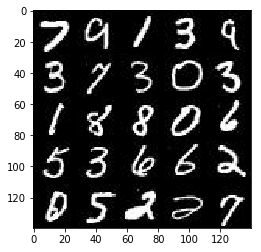

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

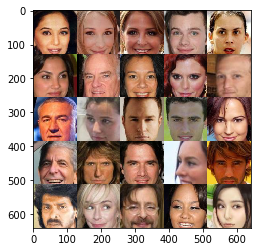

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 128, 128, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

In [4]:
len(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))

202599

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [5]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [6]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    input_images = tf.placeholder(tf.float32, [None, image_width, image_height, image_channels], name='input_images')
    z = tf.placeholder(tf.float32, [None, z_dim], name='z')
    learning_rate = tf.placeholder(tf.float32, name='learning_rate')

    return input_images, z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the generator, tensor logits of the generator).

In [7]:
def leaky_relu(x, alpha=0.2, name='leaky_relu'):
            return tf.maximum(x, alpha * x, name=name)

def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    with tf.variable_scope('discriminator', reuse=reuse): # finish this
        
        # Input layer is 28x28x3
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        relu1 = leaky_relu(x1)
        # 14x14x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = leaky_relu(bn2)
        # 7x7x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = leaky_relu(bn3)
        relu3 = tf.nn.dropout(relu3, 0.9)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)        
        
        
        return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [8]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    
    with tf.variable_scope('generator', reuse=(not is_train)):
        
        # First fully connected layer
        x1 = tf.layers.dense(z, 7*7*512)

        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 7, 7, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = leaky_relu(x1)
        x1 = tf.nn.dropout(x1, 0.5)
        # 7x7x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=1, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = leaky_relu(x2)
        #x2 = tf.nn.dropout(x2, 0.5)
        # 7x7x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = leaky_relu(x3)
        x3 = tf.nn.dropout(x3, 0.5)
        # 14x14x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, out_channel_dim, 5, strides=2, padding='same')
        # 28x28x3 now
        
        out = tf.tanh(logits)
        
        return out

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [9]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    g_model = generator(input_z, out_channel_dim, is_train=True)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real) * 0.9))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake) * 0.9))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake) * 0.9))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [10]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [11]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [12]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    #print(data_shape)
    #print(data_shape[1], data_shape[2])
    #print(data_image_mode)
    #print(z_dim)
    
    tf.reset_default_graph()

    image_channels = 3 if data_image_mode == 'RGB' else 1
    input_real, input_z, tmp = model_inputs(data_shape[1], data_shape[2], image_channels, z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, image_channels)
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)    

    
    sample_z = np.random.uniform(-1, 1, size=(72, z_dim))
    samples, losses = [], []
    steps = 0
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                steps += 1
                
                #Normalize real images
                batch_images = batch_images * 2
                
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))

                # Run optimizers
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z, input_real: batch_images})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    show_generator_output(sess, n_images, input_z, image_channels, data_image_mode)

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2... Discriminator Loss: 0.6245... Generator Loss: 2.9767
Epoch 1/2... Discriminator Loss: 1.0137... Generator Loss: 0.9982
Epoch 1/2... Discriminator Loss: 1.7816... Generator Loss: 0.5153
Epoch 1/2... Discriminator Loss: 0.6495... Generator Loss: 1.5672
Epoch 1/2... Discriminator Loss: 0.4990... Generator Loss: 2.6239
Epoch 1/2... Discriminator Loss: 0.5766... Generator Loss: 1.9216
Epoch 1/2... Discriminator Loss: 0.8263... Generator Loss: 3.4052
Epoch 1/2... Discriminator Loss: 0.9474... Generator Loss: 1.0935
Epoch 1/2... Discriminator Loss: 0.9372... Generator Loss: 1.2252
Epoch 1/2... Discriminator Loss: 0.6996... Generator Loss: 2.1619


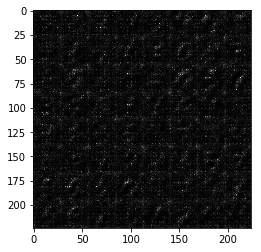

Epoch 1/2... Discriminator Loss: 0.6912... Generator Loss: 1.5775
Epoch 1/2... Discriminator Loss: 0.6713... Generator Loss: 2.5430
Epoch 1/2... Discriminator Loss: 0.9356... Generator Loss: 2.7339
Epoch 1/2... Discriminator Loss: 0.9246... Generator Loss: 2.4588
Epoch 1/2... Discriminator Loss: 0.7745... Generator Loss: 2.3736
Epoch 1/2... Discriminator Loss: 0.8916... Generator Loss: 1.5773
Epoch 1/2... Discriminator Loss: 0.8451... Generator Loss: 1.2032
Epoch 1/2... Discriminator Loss: 0.9747... Generator Loss: 0.9371
Epoch 1/2... Discriminator Loss: 0.7633... Generator Loss: 2.0545
Epoch 1/2... Discriminator Loss: 0.8650... Generator Loss: 1.1298


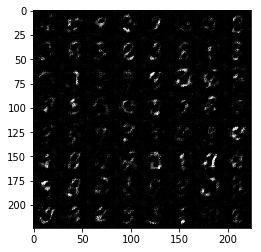

Epoch 1/2... Discriminator Loss: 0.7974... Generator Loss: 1.3735
Epoch 1/2... Discriminator Loss: 0.9134... Generator Loss: 1.1237
Epoch 1/2... Discriminator Loss: 1.2249... Generator Loss: 0.7630
Epoch 1/2... Discriminator Loss: 0.7537... Generator Loss: 1.2057
Epoch 1/2... Discriminator Loss: 0.8802... Generator Loss: 1.4971
Epoch 1/2... Discriminator Loss: 0.7176... Generator Loss: 1.4501
Epoch 1/2... Discriminator Loss: 0.9341... Generator Loss: 2.5643
Epoch 1/2... Discriminator Loss: 1.2729... Generator Loss: 3.1533
Epoch 1/2... Discriminator Loss: 0.7595... Generator Loss: 2.0608
Epoch 1/2... Discriminator Loss: 0.7426... Generator Loss: 1.3723


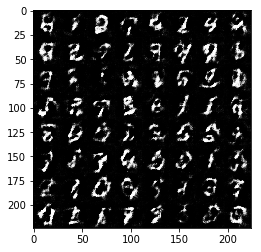

Epoch 1/2... Discriminator Loss: 0.7222... Generator Loss: 1.6877
Epoch 1/2... Discriminator Loss: 0.9035... Generator Loss: 2.3029
Epoch 1/2... Discriminator Loss: 0.7562... Generator Loss: 1.2797
Epoch 1/2... Discriminator Loss: 0.8669... Generator Loss: 1.0032
Epoch 1/2... Discriminator Loss: 0.6931... Generator Loss: 1.5528
Epoch 1/2... Discriminator Loss: 0.6310... Generator Loss: 1.6585
Epoch 1/2... Discriminator Loss: 0.8270... Generator Loss: 1.1692
Epoch 1/2... Discriminator Loss: 0.7901... Generator Loss: 2.0759
Epoch 1/2... Discriminator Loss: 0.7465... Generator Loss: 1.6035
Epoch 1/2... Discriminator Loss: 1.3024... Generator Loss: 0.6725


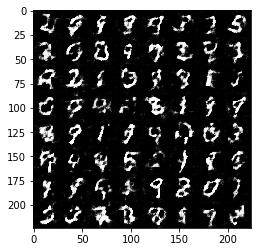

Epoch 1/2... Discriminator Loss: 0.6227... Generator Loss: 1.8583
Epoch 1/2... Discriminator Loss: 0.8924... Generator Loss: 2.8623
Epoch 1/2... Discriminator Loss: 1.2388... Generator Loss: 0.6938
Epoch 1/2... Discriminator Loss: 1.0535... Generator Loss: 0.8355
Epoch 1/2... Discriminator Loss: 0.7898... Generator Loss: 2.4401
Epoch 1/2... Discriminator Loss: 1.1715... Generator Loss: 0.8321
Epoch 1/2... Discriminator Loss: 0.9731... Generator Loss: 2.8267
Epoch 1/2... Discriminator Loss: 0.7151... Generator Loss: 1.5583
Epoch 1/2... Discriminator Loss: 0.8225... Generator Loss: 2.1567
Epoch 1/2... Discriminator Loss: 0.6531... Generator Loss: 1.7604


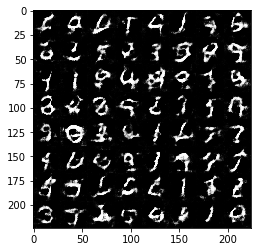

Epoch 1/2... Discriminator Loss: 0.6940... Generator Loss: 1.3514
Epoch 1/2... Discriminator Loss: 0.6743... Generator Loss: 1.4088
Epoch 1/2... Discriminator Loss: 0.7445... Generator Loss: 1.5115
Epoch 1/2... Discriminator Loss: 0.7470... Generator Loss: 1.3462
Epoch 1/2... Discriminator Loss: 0.9697... Generator Loss: 2.1914
Epoch 1/2... Discriminator Loss: 0.7342... Generator Loss: 1.5046
Epoch 1/2... Discriminator Loss: 0.8645... Generator Loss: 2.1115
Epoch 1/2... Discriminator Loss: 0.8176... Generator Loss: 1.1193
Epoch 1/2... Discriminator Loss: 0.8198... Generator Loss: 1.2709
Epoch 1/2... Discriminator Loss: 0.7651... Generator Loss: 1.7586


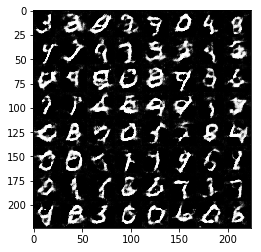

Epoch 1/2... Discriminator Loss: 0.7812... Generator Loss: 1.4344
Epoch 1/2... Discriminator Loss: 0.9991... Generator Loss: 0.9287
Epoch 1/2... Discriminator Loss: 1.0186... Generator Loss: 2.8117
Epoch 1/2... Discriminator Loss: 0.8363... Generator Loss: 1.0562
Epoch 1/2... Discriminator Loss: 0.8522... Generator Loss: 1.1088
Epoch 1/2... Discriminator Loss: 0.8408... Generator Loss: 1.1924
Epoch 1/2... Discriminator Loss: 0.9341... Generator Loss: 0.9994
Epoch 1/2... Discriminator Loss: 0.7437... Generator Loss: 2.0655
Epoch 1/2... Discriminator Loss: 0.8869... Generator Loss: 1.0442
Epoch 1/2... Discriminator Loss: 1.1579... Generator Loss: 2.4525


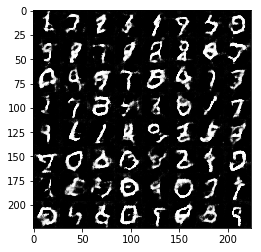

Epoch 1/2... Discriminator Loss: 0.7294... Generator Loss: 1.3088
Epoch 1/2... Discriminator Loss: 0.7150... Generator Loss: 2.2776
Epoch 1/2... Discriminator Loss: 0.7130... Generator Loss: 1.3028
Epoch 1/2... Discriminator Loss: 0.8543... Generator Loss: 1.1291
Epoch 1/2... Discriminator Loss: 0.7428... Generator Loss: 1.5942
Epoch 1/2... Discriminator Loss: 0.7935... Generator Loss: 1.3099
Epoch 1/2... Discriminator Loss: 0.7547... Generator Loss: 1.5581
Epoch 1/2... Discriminator Loss: 0.6600... Generator Loss: 1.9245
Epoch 1/2... Discriminator Loss: 1.0393... Generator Loss: 0.8040
Epoch 1/2... Discriminator Loss: 1.1287... Generator Loss: 0.8268


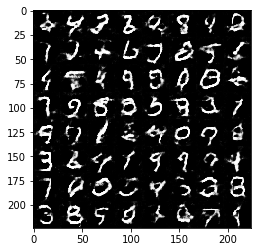

Epoch 1/2... Discriminator Loss: 0.8168... Generator Loss: 2.6359
Epoch 1/2... Discriminator Loss: 0.7622... Generator Loss: 1.8338
Epoch 1/2... Discriminator Loss: 0.8179... Generator Loss: 2.1429
Epoch 1/2... Discriminator Loss: 0.7098... Generator Loss: 1.8643
Epoch 1/2... Discriminator Loss: 0.9634... Generator Loss: 2.5022
Epoch 1/2... Discriminator Loss: 0.8073... Generator Loss: 1.5668
Epoch 1/2... Discriminator Loss: 1.1385... Generator Loss: 1.0048
Epoch 1/2... Discriminator Loss: 0.7744... Generator Loss: 1.8734
Epoch 1/2... Discriminator Loss: 0.7984... Generator Loss: 1.7751
Epoch 1/2... Discriminator Loss: 0.7908... Generator Loss: 2.1333


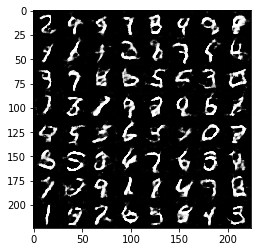

Epoch 1/2... Discriminator Loss: 0.7909... Generator Loss: 2.1846
Epoch 1/2... Discriminator Loss: 0.7712... Generator Loss: 1.3055
Epoch 1/2... Discriminator Loss: 0.7558... Generator Loss: 1.5152
Epoch 2/2... Discriminator Loss: 0.7651... Generator Loss: 1.0291
Epoch 2/2... Discriminator Loss: 0.7049... Generator Loss: 1.4845
Epoch 2/2... Discriminator Loss: 0.6775... Generator Loss: 1.3491
Epoch 2/2... Discriminator Loss: 0.8421... Generator Loss: 1.0910
Epoch 2/2... Discriminator Loss: 0.5960... Generator Loss: 2.3230
Epoch 2/2... Discriminator Loss: 0.9060... Generator Loss: 1.1126
Epoch 2/2... Discriminator Loss: 0.7660... Generator Loss: 1.3537


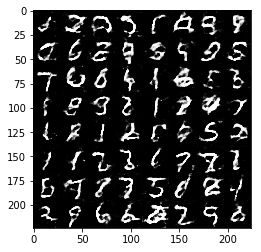

Epoch 2/2... Discriminator Loss: 0.6802... Generator Loss: 2.3995
Epoch 2/2... Discriminator Loss: 0.6493... Generator Loss: 1.4586
Epoch 2/2... Discriminator Loss: 0.6951... Generator Loss: 1.4114
Epoch 2/2... Discriminator Loss: 1.0467... Generator Loss: 3.2419
Epoch 2/2... Discriminator Loss: 0.7865... Generator Loss: 1.3365
Epoch 2/2... Discriminator Loss: 0.6522... Generator Loss: 1.6062
Epoch 2/2... Discriminator Loss: 0.6898... Generator Loss: 1.3831
Epoch 2/2... Discriminator Loss: 0.6129... Generator Loss: 1.3785
Epoch 2/2... Discriminator Loss: 0.6951... Generator Loss: 1.6526
Epoch 2/2... Discriminator Loss: 0.7244... Generator Loss: 2.0985


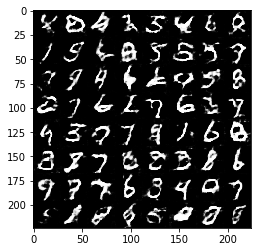

Epoch 2/2... Discriminator Loss: 1.0468... Generator Loss: 0.9217
Epoch 2/2... Discriminator Loss: 1.8277... Generator Loss: 0.5884
Epoch 2/2... Discriminator Loss: 0.6979... Generator Loss: 1.8886
Epoch 2/2... Discriminator Loss: 0.6130... Generator Loss: 1.7002
Epoch 2/2... Discriminator Loss: 0.7021... Generator Loss: 1.2217
Epoch 2/2... Discriminator Loss: 0.6301... Generator Loss: 1.8620
Epoch 2/2... Discriminator Loss: 0.6241... Generator Loss: 1.3852
Epoch 2/2... Discriminator Loss: 0.6349... Generator Loss: 1.8054
Epoch 2/2... Discriminator Loss: 0.8893... Generator Loss: 1.3355
Epoch 2/2... Discriminator Loss: 0.6499... Generator Loss: 2.8447


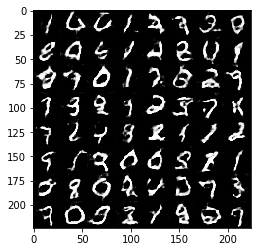

Epoch 2/2... Discriminator Loss: 0.5790... Generator Loss: 2.4466
Epoch 2/2... Discriminator Loss: 0.5659... Generator Loss: 1.8519
Epoch 2/2... Discriminator Loss: 1.1058... Generator Loss: 0.8560
Epoch 2/2... Discriminator Loss: 0.7394... Generator Loss: 1.6422
Epoch 2/2... Discriminator Loss: 0.6778... Generator Loss: 1.5480
Epoch 2/2... Discriminator Loss: 0.6329... Generator Loss: 1.5064
Epoch 2/2... Discriminator Loss: 0.5422... Generator Loss: 2.0499
Epoch 2/2... Discriminator Loss: 0.6393... Generator Loss: 1.8008
Epoch 2/2... Discriminator Loss: 1.1323... Generator Loss: 0.9545
Epoch 2/2... Discriminator Loss: 0.6348... Generator Loss: 1.4842


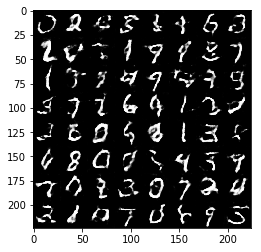

Epoch 2/2... Discriminator Loss: 0.6767... Generator Loss: 1.3500
Epoch 2/2... Discriminator Loss: 0.5498... Generator Loss: 2.2581
Epoch 2/2... Discriminator Loss: 0.6536... Generator Loss: 1.5250
Epoch 2/2... Discriminator Loss: 0.5543... Generator Loss: 2.2376
Epoch 2/2... Discriminator Loss: 0.5765... Generator Loss: 2.7998
Epoch 2/2... Discriminator Loss: 0.5975... Generator Loss: 1.5872
Epoch 2/2... Discriminator Loss: 0.5594... Generator Loss: 1.8686
Epoch 2/2... Discriminator Loss: 0.4809... Generator Loss: 2.5594
Epoch 2/2... Discriminator Loss: 0.5731... Generator Loss: 1.6062
Epoch 2/2... Discriminator Loss: 0.6706... Generator Loss: 2.7023


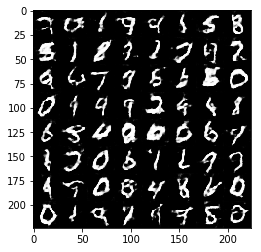

Epoch 2/2... Discriminator Loss: 0.4474... Generator Loss: 2.6610
Epoch 2/2... Discriminator Loss: 0.9650... Generator Loss: 3.6070
Epoch 2/2... Discriminator Loss: 0.7809... Generator Loss: 1.2702
Epoch 2/2... Discriminator Loss: 0.5835... Generator Loss: 1.8560
Epoch 2/2... Discriminator Loss: 0.5558... Generator Loss: 2.6113
Epoch 2/2... Discriminator Loss: 0.4653... Generator Loss: 2.5278
Epoch 2/2... Discriminator Loss: 0.5101... Generator Loss: 2.3245
Epoch 2/2... Discriminator Loss: 0.5462... Generator Loss: 2.2318
Epoch 2/2... Discriminator Loss: 0.5859... Generator Loss: 1.7611
Epoch 2/2... Discriminator Loss: 0.4761... Generator Loss: 2.5345


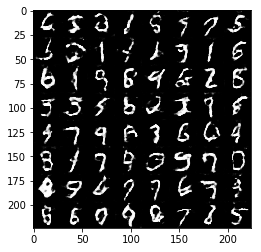

Epoch 2/2... Discriminator Loss: 0.6674... Generator Loss: 1.5370
Epoch 2/2... Discriminator Loss: 0.6556... Generator Loss: 1.4956
Epoch 2/2... Discriminator Loss: 0.4788... Generator Loss: 2.2320
Epoch 2/2... Discriminator Loss: 0.6248... Generator Loss: 1.6950
Epoch 2/2... Discriminator Loss: 0.5122... Generator Loss: 1.9849
Epoch 2/2... Discriminator Loss: 0.5562... Generator Loss: 1.5465
Epoch 2/2... Discriminator Loss: 0.4867... Generator Loss: 2.3317
Epoch 2/2... Discriminator Loss: 0.4369... Generator Loss: 2.3191
Epoch 2/2... Discriminator Loss: 0.4920... Generator Loss: 2.4979
Epoch 2/2... Discriminator Loss: 0.5907... Generator Loss: 1.5902


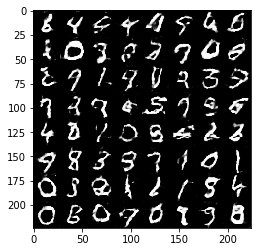

Epoch 2/2... Discriminator Loss: 0.5985... Generator Loss: 1.9360
Epoch 2/2... Discriminator Loss: 0.5968... Generator Loss: 1.7263
Epoch 2/2... Discriminator Loss: 1.7910... Generator Loss: 0.6952
Epoch 2/2... Discriminator Loss: 0.6977... Generator Loss: 1.6151
Epoch 2/2... Discriminator Loss: 0.7014... Generator Loss: 1.4535
Epoch 2/2... Discriminator Loss: 0.5125... Generator Loss: 2.0084
Epoch 2/2... Discriminator Loss: 0.5968... Generator Loss: 1.5442
Epoch 2/2... Discriminator Loss: 0.4932... Generator Loss: 1.9745
Epoch 2/2... Discriminator Loss: 0.5175... Generator Loss: 2.1164
Epoch 2/2... Discriminator Loss: 0.4435... Generator Loss: 2.6054


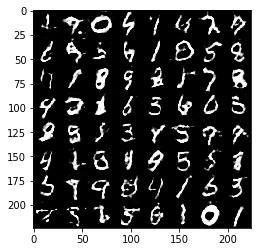

Epoch 2/2... Discriminator Loss: 0.7465... Generator Loss: 2.1159
Epoch 2/2... Discriminator Loss: 0.6164... Generator Loss: 2.6248
Epoch 2/2... Discriminator Loss: 0.4860... Generator Loss: 2.0363
Epoch 2/2... Discriminator Loss: 0.5347... Generator Loss: 2.3040
Epoch 2/2... Discriminator Loss: 0.4993... Generator Loss: 2.2116
Epoch 2/2... Discriminator Loss: 0.5669... Generator Loss: 2.4707
Epoch 2/2... Discriminator Loss: 0.4747... Generator Loss: 2.0735
Epoch 2/2... Discriminator Loss: 0.5194... Generator Loss: 2.0785
Epoch 2/2... Discriminator Loss: 0.5438... Generator Loss: 1.7991
Epoch 2/2... Discriminator Loss: 0.7547... Generator Loss: 1.4595


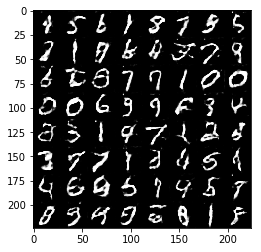

Epoch 2/2... Discriminator Loss: 0.4987... Generator Loss: 2.0921
Epoch 2/2... Discriminator Loss: 0.5857... Generator Loss: 1.4736
Epoch 2/2... Discriminator Loss: 0.5184... Generator Loss: 1.7460
Epoch 2/2... Discriminator Loss: 0.5502... Generator Loss: 1.7678
Epoch 2/2... Discriminator Loss: 0.4701... Generator Loss: 2.4643
Epoch 2/2... Discriminator Loss: 1.2198... Generator Loss: 0.7660
Epoch 2/2... Discriminator Loss: 0.6272... Generator Loss: 2.2891


IndexError: list index out of range

In [14]:
batch_size = 64
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5

print_every=10
show_every=100
n_images=72

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/1... Discriminator Loss: 1.6370... Generator Loss: 0.6965
Epoch 1/1... Discriminator Loss: 0.9613... Generator Loss: 1.1012
Epoch 1/1... Discriminator Loss: 0.8910... Generator Loss: 1.4954
Epoch 1/1... Discriminator Loss: 0.6458... Generator Loss: 1.7962
Epoch 1/1... Discriminator Loss: 0.6594... Generator Loss: 1.7604
Epoch 1/1... Discriminator Loss: 0.5916... Generator Loss: 2.0987
Epoch 1/1... Discriminator Loss: 0.5110... Generator Loss: 2.5220
Epoch 1/1... Discriminator Loss: 0.5584... Generator Loss: 2.0564
Epoch 1/1... Discriminator Loss: 0.5264... Generator Loss: 2.2422
Epoch 1/1... Discriminator Loss: 0.7018... Generator Loss: 1.6343


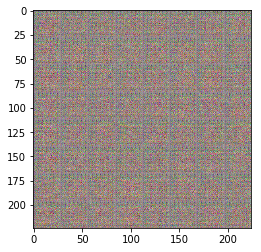

Epoch 1/1... Discriminator Loss: 0.4708... Generator Loss: 3.2848
Epoch 1/1... Discriminator Loss: 0.5119... Generator Loss: 2.7142
Epoch 1/1... Discriminator Loss: 0.6466... Generator Loss: 1.6043
Epoch 1/1... Discriminator Loss: 0.5045... Generator Loss: 3.6357
Epoch 1/1... Discriminator Loss: 0.4766... Generator Loss: 2.7198
Epoch 1/1... Discriminator Loss: 0.5641... Generator Loss: 2.2540
Epoch 1/1... Discriminator Loss: 0.4674... Generator Loss: 3.1834
Epoch 1/1... Discriminator Loss: 0.6882... Generator Loss: 1.5283
Epoch 1/1... Discriminator Loss: 0.4084... Generator Loss: 4.0102
Epoch 1/1... Discriminator Loss: 0.4152... Generator Loss: 3.3829


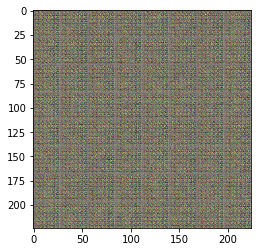

Epoch 1/1... Discriminator Loss: 0.5841... Generator Loss: 1.7559
Epoch 1/1... Discriminator Loss: 0.5512... Generator Loss: 4.3501
Epoch 1/1... Discriminator Loss: 0.5637... Generator Loss: 2.1702
Epoch 1/1... Discriminator Loss: 0.4291... Generator Loss: 3.2059
Epoch 1/1... Discriminator Loss: 0.4851... Generator Loss: 2.5983
Epoch 1/1... Discriminator Loss: 0.5854... Generator Loss: 1.7212
Epoch 1/1... Discriminator Loss: 0.4383... Generator Loss: 4.4280
Epoch 1/1... Discriminator Loss: 0.4317... Generator Loss: 3.2620
Epoch 1/1... Discriminator Loss: 0.4403... Generator Loss: 2.9409
Epoch 1/1... Discriminator Loss: 0.4330... Generator Loss: 3.4628


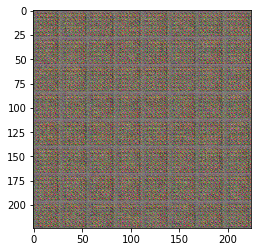

Epoch 1/1... Discriminator Loss: 0.4538... Generator Loss: 2.6600
Epoch 1/1... Discriminator Loss: 0.4190... Generator Loss: 3.7027
Epoch 1/1... Discriminator Loss: 0.4123... Generator Loss: 3.0996
Epoch 1/1... Discriminator Loss: 0.4116... Generator Loss: 3.2595
Epoch 1/1... Discriminator Loss: 0.4027... Generator Loss: 3.4308
Epoch 1/1... Discriminator Loss: 0.8103... Generator Loss: 1.2528
Epoch 1/1... Discriminator Loss: 0.6628... Generator Loss: 7.2769
Epoch 1/1... Discriminator Loss: 0.4528... Generator Loss: 3.7128
Epoch 1/1... Discriminator Loss: 0.9323... Generator Loss: 1.1248
Epoch 1/1... Discriminator Loss: 1.0316... Generator Loss: 7.0197


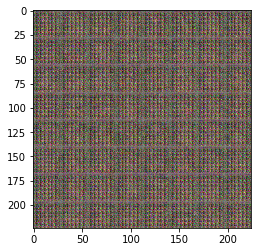

Epoch 1/1... Discriminator Loss: 0.5436... Generator Loss: 2.4296
Epoch 1/1... Discriminator Loss: 0.7828... Generator Loss: 1.5364
Epoch 1/1... Discriminator Loss: 0.5224... Generator Loss: 5.9282
Epoch 1/1... Discriminator Loss: 0.4034... Generator Loss: 4.7734
Epoch 1/1... Discriminator Loss: 0.5879... Generator Loss: 1.9454
Epoch 1/1... Discriminator Loss: 0.4642... Generator Loss: 3.4416
Epoch 1/1... Discriminator Loss: 0.4422... Generator Loss: 3.2819
Epoch 1/1... Discriminator Loss: 0.4602... Generator Loss: 2.6964
Epoch 1/1... Discriminator Loss: 0.4313... Generator Loss: 3.4865
Epoch 1/1... Discriminator Loss: 0.4300... Generator Loss: 3.3255


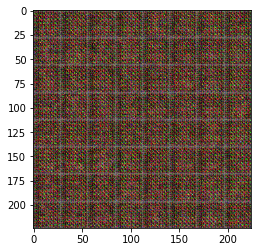

Epoch 1/1... Discriminator Loss: 0.5736... Generator Loss: 1.6873
Epoch 1/1... Discriminator Loss: 0.6000... Generator Loss: 4.8824
Epoch 1/1... Discriminator Loss: 0.4875... Generator Loss: 2.3594
Epoch 1/1... Discriminator Loss: 0.4982... Generator Loss: 2.2208
Epoch 1/1... Discriminator Loss: 0.5556... Generator Loss: 4.9266
Epoch 1/1... Discriminator Loss: 0.7630... Generator Loss: 1.2790
Epoch 1/1... Discriminator Loss: 0.6995... Generator Loss: 6.8085
Epoch 1/1... Discriminator Loss: 0.4526... Generator Loss: 3.4383
Epoch 1/1... Discriminator Loss: 0.9558... Generator Loss: 1.0886
Epoch 1/1... Discriminator Loss: 1.2195... Generator Loss: 7.5255


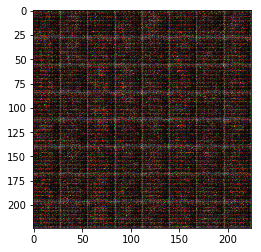

Epoch 1/1... Discriminator Loss: 0.5936... Generator Loss: 2.3203
Epoch 1/1... Discriminator Loss: 0.8476... Generator Loss: 1.1442
Epoch 1/1... Discriminator Loss: 0.7777... Generator Loss: 7.7971
Epoch 1/1... Discriminator Loss: 0.5516... Generator Loss: 5.3153
Epoch 1/1... Discriminator Loss: 0.7325... Generator Loss: 1.5436
Epoch 1/1... Discriminator Loss: 0.5006... Generator Loss: 3.0562
Epoch 1/1... Discriminator Loss: 0.5180... Generator Loss: 3.5800
Epoch 1/1... Discriminator Loss: 0.4683... Generator Loss: 2.8494
Epoch 1/1... Discriminator Loss: 0.5484... Generator Loss: 1.9590
Epoch 1/1... Discriminator Loss: 0.4355... Generator Loss: 3.7666


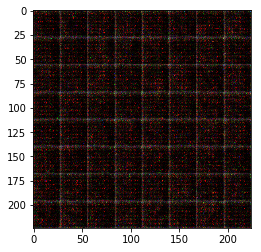

Epoch 1/1... Discriminator Loss: 0.4778... Generator Loss: 2.3629
Epoch 1/1... Discriminator Loss: 0.4529... Generator Loss: 2.5842
Epoch 1/1... Discriminator Loss: 0.4278... Generator Loss: 3.3964
Epoch 1/1... Discriminator Loss: 0.4410... Generator Loss: 3.2068
Epoch 1/1... Discriminator Loss: 0.4419... Generator Loss: 2.6210
Epoch 1/1... Discriminator Loss: 0.4558... Generator Loss: 2.7147
Epoch 1/1... Discriminator Loss: 0.6077... Generator Loss: 1.6903
Epoch 1/1... Discriminator Loss: 0.4638... Generator Loss: 3.0644
Epoch 1/1... Discriminator Loss: 0.4539... Generator Loss: 2.6861
Epoch 1/1... Discriminator Loss: 0.4655... Generator Loss: 2.1721


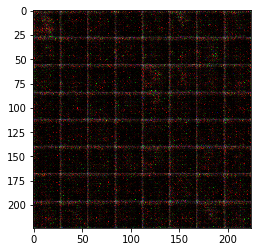

Epoch 1/1... Discriminator Loss: 0.4456... Generator Loss: 2.8869
Epoch 1/1... Discriminator Loss: 0.6241... Generator Loss: 1.5674
Epoch 1/1... Discriminator Loss: 0.5765... Generator Loss: 2.8183
Epoch 1/1... Discriminator Loss: 0.5921... Generator Loss: 1.6445
Epoch 1/1... Discriminator Loss: 0.6389... Generator Loss: 1.7947
Epoch 1/1... Discriminator Loss: 0.5820... Generator Loss: 2.4041
Epoch 1/1... Discriminator Loss: 0.6177... Generator Loss: 1.5753
Epoch 1/1... Discriminator Loss: 0.7748... Generator Loss: 3.9352
Epoch 1/1... Discriminator Loss: 0.9124... Generator Loss: 1.0979
Epoch 1/1... Discriminator Loss: 1.0862... Generator Loss: 6.1764


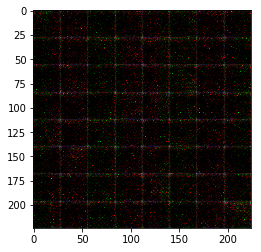

Epoch 1/1... Discriminator Loss: 0.9815... Generator Loss: 1.9027
Epoch 1/1... Discriminator Loss: 0.6059... Generator Loss: 2.6682
Epoch 1/1... Discriminator Loss: 0.6602... Generator Loss: 3.4870
Epoch 1/1... Discriminator Loss: 0.7282... Generator Loss: 1.8330
Epoch 1/1... Discriminator Loss: 0.5781... Generator Loss: 2.7422
Epoch 1/1... Discriminator Loss: 0.6032... Generator Loss: 1.7950
Epoch 1/1... Discriminator Loss: 0.5502... Generator Loss: 2.5282
Epoch 1/1... Discriminator Loss: 0.5302... Generator Loss: 2.0189
Epoch 1/1... Discriminator Loss: 0.5224... Generator Loss: 3.1828
Epoch 1/1... Discriminator Loss: 0.4956... Generator Loss: 2.5254


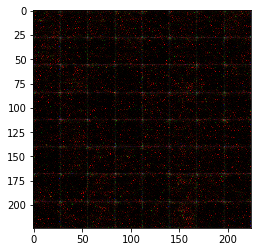

Epoch 1/1... Discriminator Loss: 0.5039... Generator Loss: 2.4970
Epoch 1/1... Discriminator Loss: 0.4730... Generator Loss: 2.5311
Epoch 1/1... Discriminator Loss: 0.7681... Generator Loss: 1.3385
Epoch 1/1... Discriminator Loss: 0.7318... Generator Loss: 3.9371
Epoch 1/1... Discriminator Loss: 0.5113... Generator Loss: 2.2414
Epoch 1/1... Discriminator Loss: 0.4849... Generator Loss: 2.5595
Epoch 1/1... Discriminator Loss: 0.5507... Generator Loss: 2.2111
Epoch 1/1... Discriminator Loss: 0.4847... Generator Loss: 3.4515
Epoch 1/1... Discriminator Loss: 1.1548... Generator Loss: 0.8039
Epoch 1/1... Discriminator Loss: 0.9354... Generator Loss: 6.0991


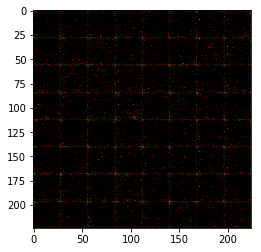

Epoch 1/1... Discriminator Loss: 0.5192... Generator Loss: 2.8886
Epoch 1/1... Discriminator Loss: 0.5967... Generator Loss: 2.1959
Epoch 1/1... Discriminator Loss: 0.5327... Generator Loss: 3.2028
Epoch 1/1... Discriminator Loss: 0.5120... Generator Loss: 3.3545
Epoch 1/1... Discriminator Loss: 0.4790... Generator Loss: 2.6100
Epoch 1/1... Discriminator Loss: 0.5524... Generator Loss: 2.0334
Epoch 1/1... Discriminator Loss: 0.5020... Generator Loss: 3.5624
Epoch 1/1... Discriminator Loss: 0.6178... Generator Loss: 1.6798
Epoch 1/1... Discriminator Loss: 0.5093... Generator Loss: 2.3713
Epoch 1/1... Discriminator Loss: 0.4903... Generator Loss: 3.7448


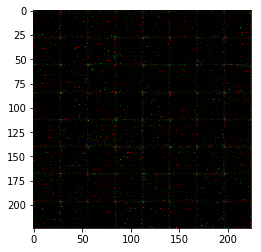

Epoch 1/1... Discriminator Loss: 0.4574... Generator Loss: 2.6155
Epoch 1/1... Discriminator Loss: 0.5712... Generator Loss: 2.0147
Epoch 1/1... Discriminator Loss: 0.5147... Generator Loss: 3.8919
Epoch 1/1... Discriminator Loss: 0.4177... Generator Loss: 3.0896
Epoch 1/1... Discriminator Loss: 0.5132... Generator Loss: 2.2076
Epoch 1/1... Discriminator Loss: 0.4401... Generator Loss: 3.1602
Epoch 1/1... Discriminator Loss: 0.4794... Generator Loss: 2.4504
Epoch 1/1... Discriminator Loss: 0.4340... Generator Loss: 2.5624
Epoch 1/1... Discriminator Loss: 0.4291... Generator Loss: 3.3599
Epoch 1/1... Discriminator Loss: 0.3918... Generator Loss: 3.5644


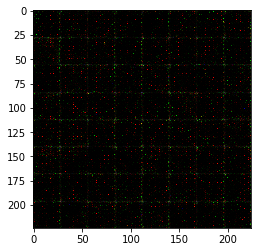

Epoch 1/1... Discriminator Loss: 0.4327... Generator Loss: 2.7351
Epoch 1/1... Discriminator Loss: 0.3976... Generator Loss: 3.3204
Epoch 1/1... Discriminator Loss: 0.5109... Generator Loss: 2.0743
Epoch 1/1... Discriminator Loss: 0.4203... Generator Loss: 4.2708
Epoch 1/1... Discriminator Loss: 0.4222... Generator Loss: 3.2464
Epoch 1/1... Discriminator Loss: 0.4317... Generator Loss: 2.7416
Epoch 1/1... Discriminator Loss: 0.4447... Generator Loss: 2.7287
Epoch 1/1... Discriminator Loss: 0.4683... Generator Loss: 3.5015
Epoch 1/1... Discriminator Loss: 0.4782... Generator Loss: 2.3428
Epoch 1/1... Discriminator Loss: 0.4498... Generator Loss: 2.7124


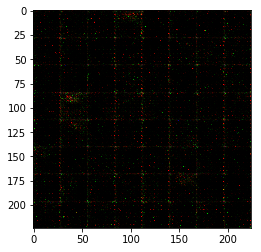

Epoch 1/1... Discriminator Loss: 0.4275... Generator Loss: 2.8906
Epoch 1/1... Discriminator Loss: 0.4817... Generator Loss: 2.2364
Epoch 1/1... Discriminator Loss: 0.4672... Generator Loss: 2.7975
Epoch 1/1... Discriminator Loss: 0.5638... Generator Loss: 1.6248
Epoch 1/1... Discriminator Loss: 0.7504... Generator Loss: 5.0599
Epoch 1/1... Discriminator Loss: 0.6402... Generator Loss: 2.0066
Epoch 1/1... Discriminator Loss: 0.5175... Generator Loss: 2.6446
Epoch 1/1... Discriminator Loss: 0.4789... Generator Loss: 3.8962
Epoch 1/1... Discriminator Loss: 0.4248... Generator Loss: 3.8440
Epoch 1/1... Discriminator Loss: 0.8005... Generator Loss: 1.2762


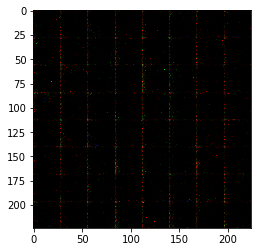

Epoch 1/1... Discriminator Loss: 0.5681... Generator Loss: 4.5003
Epoch 1/1... Discriminator Loss: 0.4144... Generator Loss: 4.5425
Epoch 1/1... Discriminator Loss: 0.4375... Generator Loss: 2.9003
Epoch 1/1... Discriminator Loss: 0.4831... Generator Loss: 2.2258
Epoch 1/1... Discriminator Loss: 0.4471... Generator Loss: 3.6610
Epoch 1/1... Discriminator Loss: 0.4213... Generator Loss: 3.2603
Epoch 1/1... Discriminator Loss: 0.5213... Generator Loss: 2.1384
Epoch 1/1... Discriminator Loss: 0.4270... Generator Loss: 3.5956
Epoch 1/1... Discriminator Loss: 0.4236... Generator Loss: 3.1487
Epoch 1/1... Discriminator Loss: 0.5615... Generator Loss: 1.7892


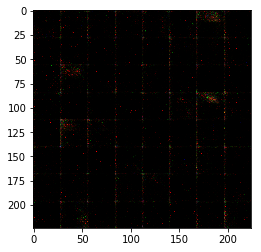

Epoch 1/1... Discriminator Loss: 0.4551... Generator Loss: 4.2362
Epoch 1/1... Discriminator Loss: 0.4354... Generator Loss: 2.7342
Epoch 1/1... Discriminator Loss: 0.4254... Generator Loss: 2.9545
Epoch 1/1... Discriminator Loss: 0.4296... Generator Loss: 3.2478
Epoch 1/1... Discriminator Loss: 0.4261... Generator Loss: 3.3701
Epoch 1/1... Discriminator Loss: 0.5740... Generator Loss: 1.7127
Epoch 1/1... Discriminator Loss: 0.4703... Generator Loss: 3.9077
Epoch 1/1... Discriminator Loss: 0.7694... Generator Loss: 1.3008
Epoch 1/1... Discriminator Loss: 0.4326... Generator Loss: 3.8479
Epoch 1/1... Discriminator Loss: 0.4480... Generator Loss: 2.6112


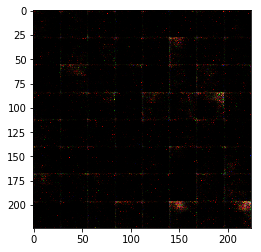

Epoch 1/1... Discriminator Loss: 0.4616... Generator Loss: 2.5099
Epoch 1/1... Discriminator Loss: 0.4678... Generator Loss: 3.0161
Epoch 1/1... Discriminator Loss: 0.4429... Generator Loss: 2.7036
Epoch 1/1... Discriminator Loss: 0.5017... Generator Loss: 2.3022
Epoch 1/1... Discriminator Loss: 0.4908... Generator Loss: 2.8848
Epoch 1/1... Discriminator Loss: 0.6112... Generator Loss: 1.4982
Epoch 1/1... Discriminator Loss: 0.5478... Generator Loss: 3.6809
Epoch 1/1... Discriminator Loss: 0.5307... Generator Loss: 2.1849
Epoch 1/1... Discriminator Loss: 0.4543... Generator Loss: 2.7756
Epoch 1/1... Discriminator Loss: 0.4292... Generator Loss: 3.3023


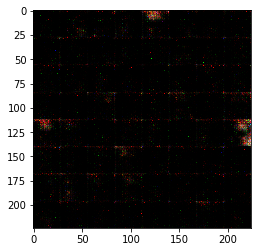

Epoch 1/1... Discriminator Loss: 0.4093... Generator Loss: 2.7972
Epoch 1/1... Discriminator Loss: 0.4883... Generator Loss: 2.2699
Epoch 1/1... Discriminator Loss: 0.4341... Generator Loss: 3.6677
Epoch 1/1... Discriminator Loss: 0.4043... Generator Loss: 3.6858
Epoch 1/1... Discriminator Loss: 0.7916... Generator Loss: 1.2188
Epoch 1/1... Discriminator Loss: 0.8376... Generator Loss: 4.8599
Epoch 1/1... Discriminator Loss: 0.4175... Generator Loss: 3.1668
Epoch 1/1... Discriminator Loss: 0.7266... Generator Loss: 1.4718
Epoch 1/1... Discriminator Loss: 0.6110... Generator Loss: 4.2917
Epoch 1/1... Discriminator Loss: 0.4356... Generator Loss: 2.8960


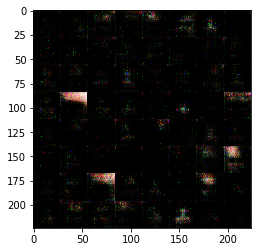

Epoch 1/1... Discriminator Loss: 0.4520... Generator Loss: 2.4859
Epoch 1/1... Discriminator Loss: 0.4790... Generator Loss: 2.7844
Epoch 1/1... Discriminator Loss: 0.5558... Generator Loss: 1.8673
Epoch 1/1... Discriminator Loss: 0.4898... Generator Loss: 3.2594
Epoch 1/1... Discriminator Loss: 0.7577... Generator Loss: 1.3553
Epoch 1/1... Discriminator Loss: 0.8055... Generator Loss: 4.8060
Epoch 1/1... Discriminator Loss: 0.7519... Generator Loss: 1.5153
Epoch 1/1... Discriminator Loss: 0.4698... Generator Loss: 3.5600
Epoch 1/1... Discriminator Loss: 0.4384... Generator Loss: 3.4709
Epoch 1/1... Discriminator Loss: 0.7245... Generator Loss: 1.4183


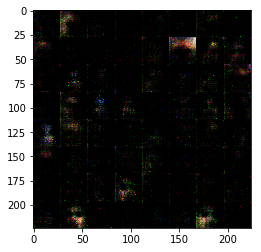

Epoch 1/1... Discriminator Loss: 0.7334... Generator Loss: 4.9397
Epoch 1/1... Discriminator Loss: 0.8608... Generator Loss: 1.1850
Epoch 1/1... Discriminator Loss: 0.4290... Generator Loss: 3.9672
Epoch 1/1... Discriminator Loss: 0.4339... Generator Loss: 3.7425
Epoch 1/1... Discriminator Loss: 0.6501... Generator Loss: 1.4202
Epoch 1/1... Discriminator Loss: 0.5040... Generator Loss: 3.2797
Epoch 1/1... Discriminator Loss: 0.4918... Generator Loss: 3.2515
Epoch 1/1... Discriminator Loss: 0.5712... Generator Loss: 1.7755
Epoch 1/1... Discriminator Loss: 0.5222... Generator Loss: 3.2181
Epoch 1/1... Discriminator Loss: 0.4462... Generator Loss: 2.5117


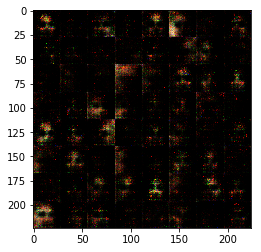

Epoch 1/1... Discriminator Loss: 0.5520... Generator Loss: 2.0602
Epoch 1/1... Discriminator Loss: 0.5385... Generator Loss: 3.3165
Epoch 1/1... Discriminator Loss: 0.5288... Generator Loss: 2.2381
Epoch 1/1... Discriminator Loss: 0.5224... Generator Loss: 3.3604
Epoch 1/1... Discriminator Loss: 0.6329... Generator Loss: 1.7716
Epoch 1/1... Discriminator Loss: 0.6356... Generator Loss: 4.6275
Epoch 1/1... Discriminator Loss: 0.4685... Generator Loss: 2.3278
Epoch 1/1... Discriminator Loss: 0.4492... Generator Loss: 2.5598
Epoch 1/1... Discriminator Loss: 0.4839... Generator Loss: 3.2368
Epoch 1/1... Discriminator Loss: 0.4282... Generator Loss: 2.7845


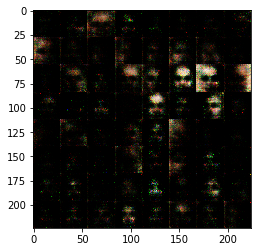

Epoch 1/1... Discriminator Loss: 0.4441... Generator Loss: 2.5078
Epoch 1/1... Discriminator Loss: 0.4492... Generator Loss: 2.3759
Epoch 1/1... Discriminator Loss: 0.4286... Generator Loss: 3.3760
Epoch 1/1... Discriminator Loss: 0.4675... Generator Loss: 2.5634
Epoch 1/1... Discriminator Loss: 0.4463... Generator Loss: 2.8318
Epoch 1/1... Discriminator Loss: 0.5044... Generator Loss: 2.1960
Epoch 1/1... Discriminator Loss: 0.4817... Generator Loss: 3.3452
Epoch 1/1... Discriminator Loss: 0.4465... Generator Loss: 2.5661
Epoch 1/1... Discriminator Loss: 0.3992... Generator Loss: 3.7123
Epoch 1/1... Discriminator Loss: 0.9715... Generator Loss: 0.9010


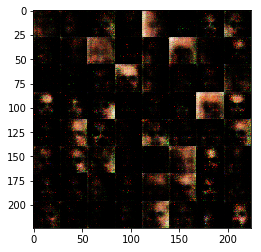

Epoch 1/1... Discriminator Loss: 1.4649... Generator Loss: 6.7221
Epoch 1/1... Discriminator Loss: 0.6177... Generator Loss: 2.1277
Epoch 1/1... Discriminator Loss: 0.4470... Generator Loss: 2.8531
Epoch 1/1... Discriminator Loss: 0.4423... Generator Loss: 4.2684
Epoch 1/1... Discriminator Loss: 0.4359... Generator Loss: 3.0419
Epoch 1/1... Discriminator Loss: 0.4984... Generator Loss: 2.3365
Epoch 1/1... Discriminator Loss: 0.4992... Generator Loss: 3.3299
Epoch 1/1... Discriminator Loss: 0.4134... Generator Loss: 3.3197
Epoch 1/1... Discriminator Loss: 0.4670... Generator Loss: 2.4694
Epoch 1/1... Discriminator Loss: 0.4824... Generator Loss: 3.0128


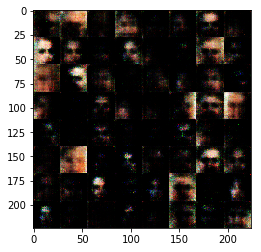

Epoch 1/1... Discriminator Loss: 0.4457... Generator Loss: 3.5532
Epoch 1/1... Discriminator Loss: 0.6836... Generator Loss: 1.6648
Epoch 1/1... Discriminator Loss: 0.6323... Generator Loss: 4.5286
Epoch 1/1... Discriminator Loss: 0.5298... Generator Loss: 2.1372
Epoch 1/1... Discriminator Loss: 0.4610... Generator Loss: 2.7523
Epoch 1/1... Discriminator Loss: 0.4511... Generator Loss: 3.4833
Epoch 1/1... Discriminator Loss: 0.4525... Generator Loss: 2.4094
Epoch 1/1... Discriminator Loss: 0.4667... Generator Loss: 2.2984
Epoch 1/1... Discriminator Loss: 0.4816... Generator Loss: 2.7933
Epoch 1/1... Discriminator Loss: 0.4401... Generator Loss: 2.6460


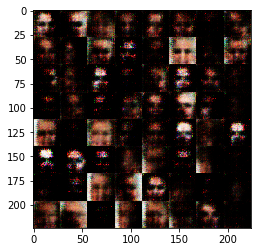

Epoch 1/1... Discriminator Loss: 0.4714... Generator Loss: 2.5726
Epoch 1/1... Discriminator Loss: 0.4504... Generator Loss: 2.9553
Epoch 1/1... Discriminator Loss: 0.6284... Generator Loss: 1.4146
Epoch 1/1... Discriminator Loss: 0.5846... Generator Loss: 3.2375
Epoch 1/1... Discriminator Loss: 0.4599... Generator Loss: 2.4704
Epoch 1/1... Discriminator Loss: 0.4634... Generator Loss: 2.7391
Epoch 1/1... Discriminator Loss: 0.5090... Generator Loss: 3.3276
Epoch 1/1... Discriminator Loss: 0.8056... Generator Loss: 1.2967
Epoch 1/1... Discriminator Loss: 0.8015... Generator Loss: 5.2982
Epoch 1/1... Discriminator Loss: 1.3806... Generator Loss: 0.9295


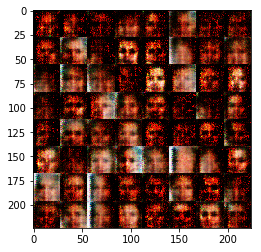

Epoch 1/1... Discriminator Loss: 0.7258... Generator Loss: 6.0206
Epoch 1/1... Discriminator Loss: 0.3939... Generator Loss: 4.6025
Epoch 1/1... Discriminator Loss: 0.6707... Generator Loss: 2.0033
Epoch 1/1... Discriminator Loss: 0.4922... Generator Loss: 2.7021
Epoch 1/1... Discriminator Loss: 0.5484... Generator Loss: 3.7465
Epoch 1/1... Discriminator Loss: 1.0378... Generator Loss: 0.9147
Epoch 1/1... Discriminator Loss: 1.1571... Generator Loss: 6.0984
Epoch 1/1... Discriminator Loss: 0.8446... Generator Loss: 1.3510
Epoch 1/1... Discriminator Loss: 0.5266... Generator Loss: 2.7532
Epoch 1/1... Discriminator Loss: 0.4667... Generator Loss: 2.8458


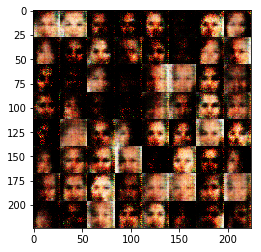

Epoch 1/1... Discriminator Loss: 0.4660... Generator Loss: 2.9893
Epoch 1/1... Discriminator Loss: 0.5043... Generator Loss: 2.1980
Epoch 1/1... Discriminator Loss: 0.5305... Generator Loss: 2.1541
Epoch 1/1... Discriminator Loss: 0.4828... Generator Loss: 2.7553
Epoch 1/1... Discriminator Loss: 0.5381... Generator Loss: 2.2348
Epoch 1/1... Discriminator Loss: 0.5777... Generator Loss: 1.8396
Epoch 1/1... Discriminator Loss: 0.7661... Generator Loss: 4.5358
Epoch 1/1... Discriminator Loss: 0.5304... Generator Loss: 2.1983
Epoch 1/1... Discriminator Loss: 0.5350... Generator Loss: 2.3137
Epoch 1/1... Discriminator Loss: 0.5428... Generator Loss: 3.5253


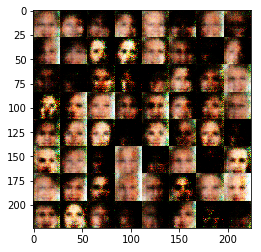

Epoch 1/1... Discriminator Loss: 0.9095... Generator Loss: 1.0452
Epoch 1/1... Discriminator Loss: 0.6062... Generator Loss: 3.9428
Epoch 1/1... Discriminator Loss: 0.6054... Generator Loss: 1.7928
Epoch 1/1... Discriminator Loss: 0.4267... Generator Loss: 3.0906
Epoch 1/1... Discriminator Loss: 0.4946... Generator Loss: 3.4788
Epoch 1/1... Discriminator Loss: 0.5241... Generator Loss: 2.2005
Epoch 1/1... Discriminator Loss: 0.4710... Generator Loss: 2.6912
Epoch 1/1... Discriminator Loss: 0.5301... Generator Loss: 3.2890
Epoch 1/1... Discriminator Loss: 0.5296... Generator Loss: 2.1147
Epoch 1/1... Discriminator Loss: 0.4948... Generator Loss: 2.8290


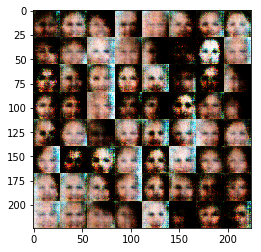

Epoch 1/1... Discriminator Loss: 0.5058... Generator Loss: 2.3500
Epoch 1/1... Discriminator Loss: 0.4356... Generator Loss: 2.8896
Epoch 1/1... Discriminator Loss: 0.5601... Generator Loss: 1.8570
Epoch 1/1... Discriminator Loss: 0.4547... Generator Loss: 3.2111
Epoch 1/1... Discriminator Loss: 0.8585... Generator Loss: 1.1558
Epoch 1/1... Discriminator Loss: 0.7855... Generator Loss: 4.5976
Epoch 1/1... Discriminator Loss: 0.9417... Generator Loss: 1.2711
Epoch 1/1... Discriminator Loss: 0.4334... Generator Loss: 3.8217
Epoch 1/1... Discriminator Loss: 0.4377... Generator Loss: 4.0082
Epoch 1/1... Discriminator Loss: 0.4058... Generator Loss: 3.2515


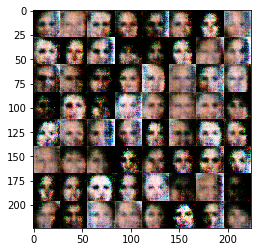

Epoch 1/1... Discriminator Loss: 0.5267... Generator Loss: 1.9801
Epoch 1/1... Discriminator Loss: 0.5114... Generator Loss: 2.4172
Epoch 1/1... Discriminator Loss: 0.5334... Generator Loss: 2.4630
Epoch 1/1... Discriminator Loss: 1.2513... Generator Loss: 0.7590
Epoch 1/1... Discriminator Loss: 3.6622... Generator Loss: 9.0164
Epoch 1/1... Discriminator Loss: 0.8340... Generator Loss: 1.6497
Epoch 1/1... Discriminator Loss: 0.9016... Generator Loss: 1.1872
Epoch 1/1... Discriminator Loss: 1.0507... Generator Loss: 3.7885
Epoch 1/1... Discriminator Loss: 0.4951... Generator Loss: 2.6671
Epoch 1/1... Discriminator Loss: 0.8748... Generator Loss: 1.1158


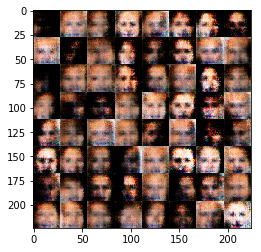

Epoch 1/1... Discriminator Loss: 0.8399... Generator Loss: 4.7049
Epoch 1/1... Discriminator Loss: 0.4553... Generator Loss: 2.7749
Epoch 1/1... Discriminator Loss: 0.6286... Generator Loss: 1.7148
Epoch 1/1... Discriminator Loss: 0.4692... Generator Loss: 3.5215
Epoch 1/1... Discriminator Loss: 0.5515... Generator Loss: 2.5127
Epoch 1/1... Discriminator Loss: 0.6190... Generator Loss: 1.6874
Epoch 1/1... Discriminator Loss: 0.5634... Generator Loss: 2.1206
Epoch 1/1... Discriminator Loss: 0.5736... Generator Loss: 2.3371
Epoch 1/1... Discriminator Loss: 0.5240... Generator Loss: 2.3872
Epoch 1/1... Discriminator Loss: 0.8400... Generator Loss: 1.2075


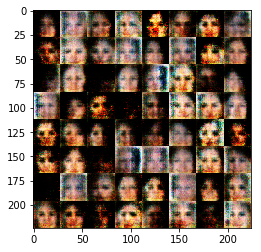

Epoch 1/1... Discriminator Loss: 0.5528... Generator Loss: 3.7666
Epoch 1/1... Discriminator Loss: 0.4736... Generator Loss: 2.9840
Epoch 1/1... Discriminator Loss: 0.8042... Generator Loss: 1.2845
Epoch 1/1... Discriminator Loss: 0.5949... Generator Loss: 2.7847
Epoch 1/1... Discriminator Loss: 0.5016... Generator Loss: 2.9533
Epoch 1/1... Discriminator Loss: 0.6388... Generator Loss: 1.5530
Epoch 1/1... Discriminator Loss: 0.7214... Generator Loss: 1.3313
Epoch 1/1... Discriminator Loss: 0.6311... Generator Loss: 3.6932
Epoch 1/1... Discriminator Loss: 0.4750... Generator Loss: 2.5096
Epoch 1/1... Discriminator Loss: 0.6909... Generator Loss: 1.5956


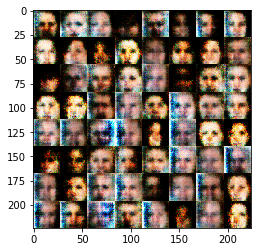

Epoch 1/1... Discriminator Loss: 0.5430... Generator Loss: 2.2572
Epoch 1/1... Discriminator Loss: 0.5479... Generator Loss: 2.2267
Epoch 1/1... Discriminator Loss: 1.0134... Generator Loss: 0.8033
Epoch 1/1... Discriminator Loss: 1.3645... Generator Loss: 5.5061
Epoch 1/1... Discriminator Loss: 1.5704... Generator Loss: 0.6481
Epoch 1/1... Discriminator Loss: 0.7487... Generator Loss: 6.0209
Epoch 1/1... Discriminator Loss: 0.5606... Generator Loss: 4.8228
Epoch 1/1... Discriminator Loss: 1.1906... Generator Loss: 1.1094
Epoch 1/1... Discriminator Loss: 0.5237... Generator Loss: 2.8513
Epoch 1/1... Discriminator Loss: 0.6768... Generator Loss: 2.8250


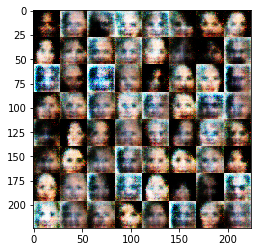

Epoch 1/1... Discriminator Loss: 0.6561... Generator Loss: 1.5714
Epoch 1/1... Discriminator Loss: 0.5772... Generator Loss: 1.9937
Epoch 1/1... Discriminator Loss: 0.5080... Generator Loss: 2.9629
Epoch 1/1... Discriminator Loss: 0.5992... Generator Loss: 1.8313
Epoch 1/1... Discriminator Loss: 0.5503... Generator Loss: 2.7188
Epoch 1/1... Discriminator Loss: 0.5343... Generator Loss: 2.0300
Epoch 1/1... Discriminator Loss: 0.5261... Generator Loss: 2.0950
Epoch 1/1... Discriminator Loss: 0.5760... Generator Loss: 3.5975
Epoch 1/1... Discriminator Loss: 1.1254... Generator Loss: 0.8204
Epoch 1/1... Discriminator Loss: 1.2569... Generator Loss: 6.6322


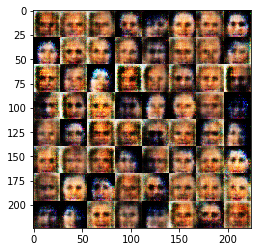

Epoch 1/1... Discriminator Loss: 0.5679... Generator Loss: 2.2749
Epoch 1/1... Discriminator Loss: 0.7523... Generator Loss: 1.4292
Epoch 1/1... Discriminator Loss: 0.5731... Generator Loss: 4.0293
Epoch 1/1... Discriminator Loss: 0.4591... Generator Loss: 3.0591
Epoch 1/1... Discriminator Loss: 0.7357... Generator Loss: 1.3737
Epoch 1/1... Discriminator Loss: 0.6834... Generator Loss: 3.4499
Epoch 1/1... Discriminator Loss: 0.7934... Generator Loss: 1.3886
Epoch 1/1... Discriminator Loss: 0.6232... Generator Loss: 2.8311
Epoch 1/1... Discriminator Loss: 1.1022... Generator Loss: 0.9240
Epoch 1/1... Discriminator Loss: 0.8013... Generator Loss: 3.9176


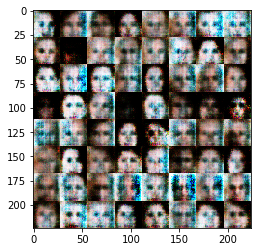

Epoch 1/1... Discriminator Loss: 0.4510... Generator Loss: 3.5342
Epoch 1/1... Discriminator Loss: 0.6022... Generator Loss: 1.7619
Epoch 1/1... Discriminator Loss: 0.5661... Generator Loss: 1.9778
Epoch 1/1... Discriminator Loss: 0.5635... Generator Loss: 2.9420
Epoch 1/1... Discriminator Loss: 0.7125... Generator Loss: 1.4497
Epoch 1/1... Discriminator Loss: 0.5187... Generator Loss: 2.8818
Epoch 1/1... Discriminator Loss: 0.5122... Generator Loss: 2.1245
Epoch 1/1... Discriminator Loss: 0.6663... Generator Loss: 1.5126
Epoch 1/1... Discriminator Loss: 0.5288... Generator Loss: 3.4861
Epoch 1/1... Discriminator Loss: 0.6250... Generator Loss: 1.6730


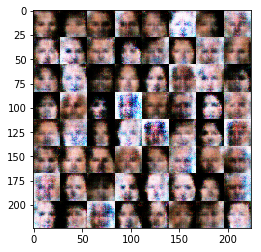

Epoch 1/1... Discriminator Loss: 0.4899... Generator Loss: 2.7369
Epoch 1/1... Discriminator Loss: 0.4936... Generator Loss: 3.0796
Epoch 1/1... Discriminator Loss: 0.8910... Generator Loss: 1.1185
Epoch 1/1... Discriminator Loss: 0.7289... Generator Loss: 4.4450
Epoch 1/1... Discriminator Loss: 0.4369... Generator Loss: 3.0126
Epoch 1/1... Discriminator Loss: 0.7475... Generator Loss: 1.4677
Epoch 1/1... Discriminator Loss: 0.6705... Generator Loss: 3.1263
Epoch 1/1... Discriminator Loss: 0.4921... Generator Loss: 2.7806
Epoch 1/1... Discriminator Loss: 0.5745... Generator Loss: 1.9875
Epoch 1/1... Discriminator Loss: 0.5724... Generator Loss: 2.1971


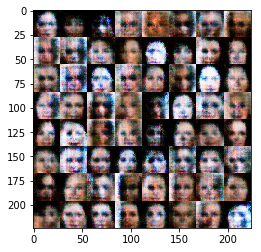

Epoch 1/1... Discriminator Loss: 0.6189... Generator Loss: 1.5403
Epoch 1/1... Discriminator Loss: 0.6545... Generator Loss: 3.0358
Epoch 1/1... Discriminator Loss: 0.5118... Generator Loss: 2.1462
Epoch 1/1... Discriminator Loss: 0.5116... Generator Loss: 2.2918
Epoch 1/1... Discriminator Loss: 0.4687... Generator Loss: 3.7574
Epoch 1/1... Discriminator Loss: 0.4856... Generator Loss: 2.5627
Epoch 1/1... Discriminator Loss: 0.5225... Generator Loss: 2.1780
Epoch 1/1... Discriminator Loss: 0.4870... Generator Loss: 3.5274
Epoch 1/1... Discriminator Loss: 0.6707... Generator Loss: 1.5779
Epoch 1/1... Discriminator Loss: 0.4969... Generator Loss: 2.5491


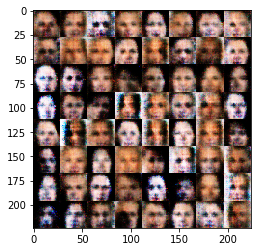

Epoch 1/1... Discriminator Loss: 0.5446... Generator Loss: 1.9337
Epoch 1/1... Discriminator Loss: 0.5060... Generator Loss: 2.9687
Epoch 1/1... Discriminator Loss: 0.6378... Generator Loss: 1.6237
Epoch 1/1... Discriminator Loss: 0.7568... Generator Loss: 3.5865
Epoch 1/1... Discriminator Loss: 0.6389... Generator Loss: 1.5275
Epoch 1/1... Discriminator Loss: 0.5280... Generator Loss: 2.9156
Epoch 1/1... Discriminator Loss: 0.4846... Generator Loss: 2.8180
Epoch 1/1... Discriminator Loss: 0.5871... Generator Loss: 1.8356
Epoch 1/1... Discriminator Loss: 0.6345... Generator Loss: 3.5072
Epoch 1/1... Discriminator Loss: 0.9542... Generator Loss: 0.9531


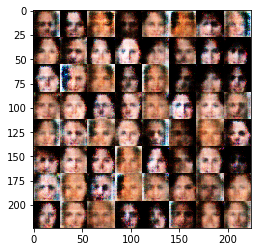

Epoch 1/1... Discriminator Loss: 0.5291... Generator Loss: 3.9469
Epoch 1/1... Discriminator Loss: 0.4492... Generator Loss: 2.7159
Epoch 1/1... Discriminator Loss: 0.5143... Generator Loss: 2.1366
Epoch 1/1... Discriminator Loss: 0.5207... Generator Loss: 2.5807
Epoch 1/1... Discriminator Loss: 0.9094... Generator Loss: 1.1188
Epoch 1/1... Discriminator Loss: 1.5677... Generator Loss: 5.9159
Epoch 1/1... Discriminator Loss: 2.2778... Generator Loss: 0.4535
Epoch 1/1... Discriminator Loss: 1.2511... Generator Loss: 5.9458
Epoch 1/1... Discriminator Loss: 0.5502... Generator Loss: 2.3353
Epoch 1/1... Discriminator Loss: 0.6920... Generator Loss: 1.5407


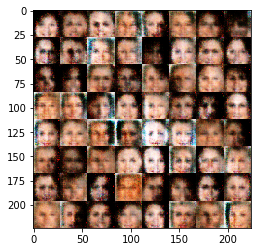

Epoch 1/1... Discriminator Loss: 0.8169... Generator Loss: 3.0594
Epoch 1/1... Discriminator Loss: 0.7432... Generator Loss: 1.3884
Epoch 1/1... Discriminator Loss: 0.6006... Generator Loss: 2.1295
Epoch 1/1... Discriminator Loss: 0.6777... Generator Loss: 1.6422
Epoch 1/1... Discriminator Loss: 0.7668... Generator Loss: 1.1584
Epoch 1/1... Discriminator Loss: 0.8151... Generator Loss: 4.0921
Epoch 1/1... Discriminator Loss: 0.5581... Generator Loss: 2.0860
Epoch 1/1... Discriminator Loss: 0.6837... Generator Loss: 1.5376
Epoch 1/1... Discriminator Loss: 0.5230... Generator Loss: 2.8004
Epoch 1/1... Discriminator Loss: 0.5362... Generator Loss: 2.8935


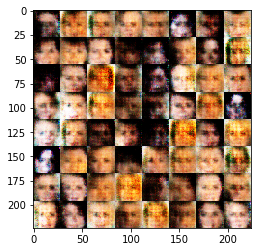

Epoch 1/1... Discriminator Loss: 0.5721... Generator Loss: 1.8789
Epoch 1/1... Discriminator Loss: 0.5213... Generator Loss: 2.0582
Epoch 1/1... Discriminator Loss: 0.5495... Generator Loss: 2.2411
Epoch 1/1... Discriminator Loss: 0.5731... Generator Loss: 2.2927
Epoch 1/1... Discriminator Loss: 0.6726... Generator Loss: 1.5340
Epoch 1/1... Discriminator Loss: 0.6222... Generator Loss: 2.3319
Epoch 1/1... Discriminator Loss: 0.5599... Generator Loss: 2.0106
Epoch 1/1... Discriminator Loss: 0.5806... Generator Loss: 1.7476
Epoch 1/1... Discriminator Loss: 0.6105... Generator Loss: 2.2480
Epoch 1/1... Discriminator Loss: 0.5960... Generator Loss: 1.9103


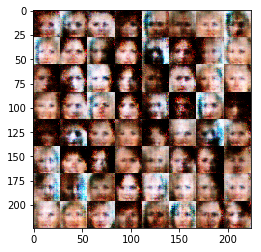

Epoch 1/1... Discriminator Loss: 0.6035... Generator Loss: 1.8762
Epoch 1/1... Discriminator Loss: 0.6602... Generator Loss: 1.5333
Epoch 1/1... Discriminator Loss: 0.6814... Generator Loss: 3.2947
Epoch 1/1... Discriminator Loss: 0.6879... Generator Loss: 1.5423
Epoch 1/1... Discriminator Loss: 0.5914... Generator Loss: 1.7712
Epoch 1/1... Discriminator Loss: 0.5840... Generator Loss: 2.3515
Epoch 1/1... Discriminator Loss: 0.5387... Generator Loss: 2.1715
Epoch 1/1... Discriminator Loss: 0.5337... Generator Loss: 2.3123
Epoch 1/1... Discriminator Loss: 0.6899... Generator Loss: 1.4658
Epoch 1/1... Discriminator Loss: 0.8641... Generator Loss: 2.6818


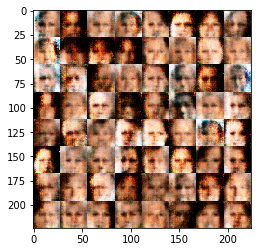

Epoch 1/1... Discriminator Loss: 0.5854... Generator Loss: 1.9937
Epoch 1/1... Discriminator Loss: 0.6365... Generator Loss: 1.6416
Epoch 1/1... Discriminator Loss: 0.6365... Generator Loss: 2.8448
Epoch 1/1... Discriminator Loss: 0.6054... Generator Loss: 1.8952
Epoch 1/1... Discriminator Loss: 0.5852... Generator Loss: 1.9583
Epoch 1/1... Discriminator Loss: 0.7759... Generator Loss: 1.2627
Epoch 1/1... Discriminator Loss: 1.0760... Generator Loss: 3.9618
Epoch 1/1... Discriminator Loss: 1.8563... Generator Loss: 0.5139
Epoch 1/1... Discriminator Loss: 1.2108... Generator Loss: 6.2051
Epoch 1/1... Discriminator Loss: 0.4280... Generator Loss: 3.9411


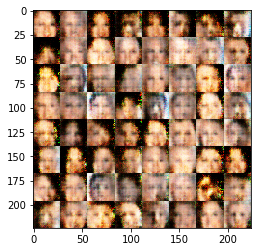

Epoch 1/1... Discriminator Loss: 1.0397... Generator Loss: 1.3090
Epoch 1/1... Discriminator Loss: 0.5400... Generator Loss: 2.6449
Epoch 1/1... Discriminator Loss: 0.6260... Generator Loss: 3.3515
Epoch 1/1... Discriminator Loss: 0.4900... Generator Loss: 2.5623
Epoch 1/1... Discriminator Loss: 1.0172... Generator Loss: 1.0228
Epoch 1/1... Discriminator Loss: 0.7354... Generator Loss: 2.5762
Epoch 1/1... Discriminator Loss: 0.5977... Generator Loss: 2.2999
Epoch 1/1... Discriminator Loss: 0.4950... Generator Loss: 2.7267
Epoch 1/1... Discriminator Loss: 0.5874... Generator Loss: 1.7617
Epoch 1/1... Discriminator Loss: 0.5471... Generator Loss: 2.3537


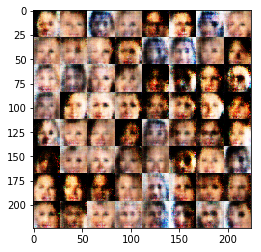

Epoch 1/1... Discriminator Loss: 0.7344... Generator Loss: 1.3744
Epoch 1/1... Discriminator Loss: 0.6283... Generator Loss: 1.7989
Epoch 1/1... Discriminator Loss: 0.5973... Generator Loss: 2.5580
Epoch 1/1... Discriminator Loss: 0.9104... Generator Loss: 1.1325
Epoch 1/1... Discriminator Loss: 0.8037... Generator Loss: 4.1078
Epoch 1/1... Discriminator Loss: 0.7472... Generator Loss: 1.5651
Epoch 1/1... Discriminator Loss: 0.5637... Generator Loss: 2.2118
Epoch 1/1... Discriminator Loss: 0.6088... Generator Loss: 2.4542
Epoch 1/1... Discriminator Loss: 0.8625... Generator Loss: 1.1656
Epoch 1/1... Discriminator Loss: 0.6016... Generator Loss: 2.7724


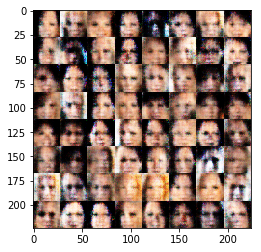

Epoch 1/1... Discriminator Loss: 0.4922... Generator Loss: 2.5286
Epoch 1/1... Discriminator Loss: 1.0846... Generator Loss: 0.8799
Epoch 1/1... Discriminator Loss: 1.2524... Generator Loss: 4.2905
Epoch 1/1... Discriminator Loss: 0.6454... Generator Loss: 1.6524
Epoch 1/1... Discriminator Loss: 0.5378... Generator Loss: 2.0032
Epoch 1/1... Discriminator Loss: 0.6211... Generator Loss: 2.7459
Epoch 1/1... Discriminator Loss: 0.5752... Generator Loss: 2.2870
Epoch 1/1... Discriminator Loss: 0.6635... Generator Loss: 1.7626
Epoch 1/1... Discriminator Loss: 0.6339... Generator Loss: 2.6031
Epoch 1/1... Discriminator Loss: 0.5936... Generator Loss: 2.0103


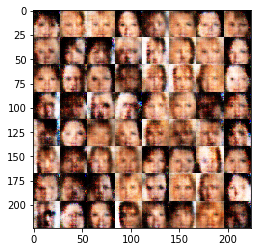

Epoch 1/1... Discriminator Loss: 1.1378... Generator Loss: 0.9708
Epoch 1/1... Discriminator Loss: 0.8006... Generator Loss: 3.6650
Epoch 1/1... Discriminator Loss: 0.6901... Generator Loss: 1.6567
Epoch 1/1... Discriminator Loss: 0.6339... Generator Loss: 1.6783
Epoch 1/1... Discriminator Loss: 0.5559... Generator Loss: 2.8872
Epoch 1/1... Discriminator Loss: 0.9198... Generator Loss: 1.0500
Epoch 1/1... Discriminator Loss: 0.7478... Generator Loss: 3.4450
Epoch 1/1... Discriminator Loss: 0.9319... Generator Loss: 1.1076
Epoch 1/1... Discriminator Loss: 0.5243... Generator Loss: 2.7901
Epoch 1/1... Discriminator Loss: 0.6562... Generator Loss: 1.7945


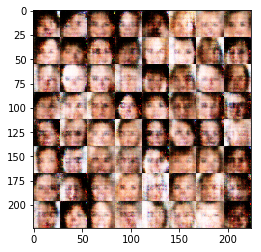

Epoch 1/1... Discriminator Loss: 0.5562... Generator Loss: 2.4309
Epoch 1/1... Discriminator Loss: 0.7409... Generator Loss: 1.4728
Epoch 1/1... Discriminator Loss: 0.6027... Generator Loss: 2.3759
Epoch 1/1... Discriminator Loss: 0.5334... Generator Loss: 2.6134
Epoch 1/1... Discriminator Loss: 0.7200... Generator Loss: 1.3814
Epoch 1/1... Discriminator Loss: 0.6646... Generator Loss: 2.5784
Epoch 1/1... Discriminator Loss: 0.6316... Generator Loss: 1.8432
Epoch 1/1... Discriminator Loss: 0.6119... Generator Loss: 1.7111
Epoch 1/1... Discriminator Loss: 0.6777... Generator Loss: 1.9746
Epoch 1/1... Discriminator Loss: 0.7375... Generator Loss: 1.4508


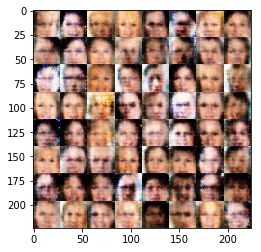

Epoch 1/1... Discriminator Loss: 1.0474... Generator Loss: 3.3310
Epoch 1/1... Discriminator Loss: 1.8719... Generator Loss: 0.5606
Epoch 1/1... Discriminator Loss: 1.8088... Generator Loss: 5.1443
Epoch 1/1... Discriminator Loss: 0.5346... Generator Loss: 2.3214
Epoch 1/1... Discriminator Loss: 1.2285... Generator Loss: 0.8958
Epoch 1/1... Discriminator Loss: 0.5882... Generator Loss: 2.9430
Epoch 1/1... Discriminator Loss: 0.6278... Generator Loss: 2.0504
Epoch 1/1... Discriminator Loss: 0.8575... Generator Loss: 1.1706
Epoch 1/1... Discriminator Loss: 0.7884... Generator Loss: 2.1938
Epoch 1/1... Discriminator Loss: 0.7509... Generator Loss: 1.4656


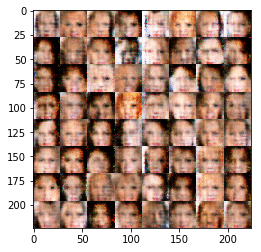

Epoch 1/1... Discriminator Loss: 0.7328... Generator Loss: 1.7447
Epoch 1/1... Discriminator Loss: 0.7548... Generator Loss: 1.7354
Epoch 1/1... Discriminator Loss: 0.6535... Generator Loss: 2.2615
Epoch 1/1... Discriminator Loss: 1.1656... Generator Loss: 0.7916
Epoch 1/1... Discriminator Loss: 1.0951... Generator Loss: 3.3551
Epoch 1/1... Discriminator Loss: 0.7593... Generator Loss: 1.3863
Epoch 1/1... Discriminator Loss: 0.7492... Generator Loss: 1.8003
Epoch 1/1... Discriminator Loss: 0.7419... Generator Loss: 2.0336
Epoch 1/1... Discriminator Loss: 0.6904... Generator Loss: 1.7691
Epoch 1/1... Discriminator Loss: 0.7658... Generator Loss: 1.6546


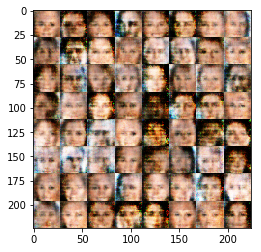

Epoch 1/1... Discriminator Loss: 0.6546... Generator Loss: 2.1486
Epoch 1/1... Discriminator Loss: 0.7064... Generator Loss: 1.6052
Epoch 1/1... Discriminator Loss: 0.6727... Generator Loss: 2.4435
Epoch 1/1... Discriminator Loss: 0.9893... Generator Loss: 1.1343
Epoch 1/1... Discriminator Loss: 0.9863... Generator Loss: 3.3960
Epoch 1/1... Discriminator Loss: 0.6454... Generator Loss: 1.8657
Epoch 1/1... Discriminator Loss: 0.8532... Generator Loss: 1.2493
Epoch 1/1... Discriminator Loss: 0.6581... Generator Loss: 2.3791
Epoch 1/1... Discriminator Loss: 0.6211... Generator Loss: 1.7594
Epoch 1/1... Discriminator Loss: 0.8128... Generator Loss: 1.4249


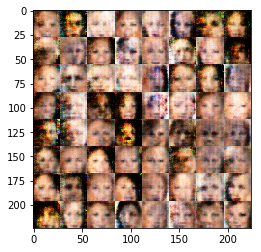

Epoch 1/1... Discriminator Loss: 0.6211... Generator Loss: 2.2004
Epoch 1/1... Discriminator Loss: 0.6560... Generator Loss: 1.6721
Epoch 1/1... Discriminator Loss: 0.6962... Generator Loss: 1.9532
Epoch 1/1... Discriminator Loss: 0.8986... Generator Loss: 0.9849
Epoch 1/1... Discriminator Loss: 0.7868... Generator Loss: 2.2441
Epoch 1/1... Discriminator Loss: 0.6338... Generator Loss: 1.4842
Epoch 1/1... Discriminator Loss: 0.6249... Generator Loss: 2.0810
Epoch 1/1... Discriminator Loss: 0.6343... Generator Loss: 2.0216
Epoch 1/1... Discriminator Loss: 0.5886... Generator Loss: 1.9195
Epoch 1/1... Discriminator Loss: 0.7154... Generator Loss: 1.4783


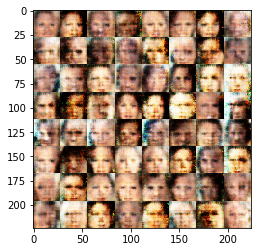

Epoch 1/1... Discriminator Loss: 0.5857... Generator Loss: 1.9966
Epoch 1/1... Discriminator Loss: 0.5823... Generator Loss: 1.9052
Epoch 1/1... Discriminator Loss: 0.7797... Generator Loss: 1.4089
Epoch 1/1... Discriminator Loss: 1.1169... Generator Loss: 3.2862
Epoch 1/1... Discriminator Loss: 1.3533... Generator Loss: 0.7096
Epoch 1/1... Discriminator Loss: 1.0103... Generator Loss: 3.9602
Epoch 1/1... Discriminator Loss: 1.1210... Generator Loss: 0.9797
Epoch 1/1... Discriminator Loss: 0.7480... Generator Loss: 2.2574
Epoch 1/1... Discriminator Loss: 0.8094... Generator Loss: 1.6171
Epoch 1/1... Discriminator Loss: 0.6775... Generator Loss: 1.9731


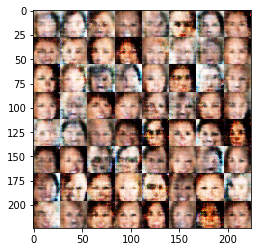

Epoch 1/1... Discriminator Loss: 0.7807... Generator Loss: 1.4669
Epoch 1/1... Discriminator Loss: 0.6673... Generator Loss: 1.8150
Epoch 1/1... Discriminator Loss: 0.7145... Generator Loss: 1.5715
Epoch 1/1... Discriminator Loss: 0.7125... Generator Loss: 2.6113
Epoch 1/1... Discriminator Loss: 0.7926... Generator Loss: 1.2699
Epoch 1/1... Discriminator Loss: 0.7092... Generator Loss: 3.0120
Epoch 1/1... Discriminator Loss: 1.0463... Generator Loss: 0.8449
Epoch 1/1... Discriminator Loss: 0.7112... Generator Loss: 2.4233
Epoch 1/1... Discriminator Loss: 0.6798... Generator Loss: 1.9072
Epoch 1/1... Discriminator Loss: 0.8885... Generator Loss: 1.3886


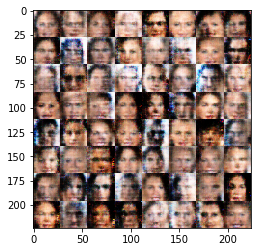

Epoch 1/1... Discriminator Loss: 0.6810... Generator Loss: 1.8326
Epoch 1/1... Discriminator Loss: 0.7557... Generator Loss: 1.5138
Epoch 1/1... Discriminator Loss: 0.6418... Generator Loss: 2.2723
Epoch 1/1... Discriminator Loss: 0.6767... Generator Loss: 1.5533
Epoch 1/1... Discriminator Loss: 0.6526... Generator Loss: 2.3370
Epoch 1/1... Discriminator Loss: 0.9399... Generator Loss: 1.0473
Epoch 1/1... Discriminator Loss: 0.9677... Generator Loss: 3.1957
Epoch 1/1... Discriminator Loss: 1.3635... Generator Loss: 0.7933
Epoch 1/1... Discriminator Loss: 1.0930... Generator Loss: 3.1780
Epoch 1/1... Discriminator Loss: 0.7382... Generator Loss: 1.5674


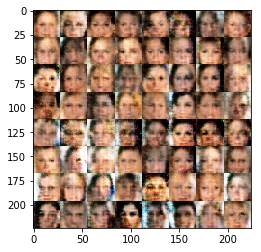

Epoch 1/1... Discriminator Loss: 1.3896... Generator Loss: 0.6788
Epoch 1/1... Discriminator Loss: 1.7419... Generator Loss: 4.6420
Epoch 1/1... Discriminator Loss: 0.9507... Generator Loss: 1.2575
Epoch 1/1... Discriminator Loss: 0.9885... Generator Loss: 1.1063
Epoch 1/1... Discriminator Loss: 1.0178... Generator Loss: 2.6876
Epoch 1/1... Discriminator Loss: 0.9456... Generator Loss: 0.9934
Epoch 1/1... Discriminator Loss: 0.8752... Generator Loss: 2.0044
Epoch 1/1... Discriminator Loss: 0.9521... Generator Loss: 1.1779
Epoch 1/1... Discriminator Loss: 0.8595... Generator Loss: 1.3746
Epoch 1/1... Discriminator Loss: 1.0487... Generator Loss: 1.1543


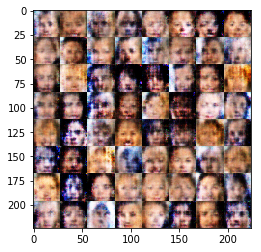

Epoch 1/1... Discriminator Loss: 0.9178... Generator Loss: 2.1538
Epoch 1/1... Discriminator Loss: 0.8858... Generator Loss: 1.2533
Epoch 1/1... Discriminator Loss: 0.6661... Generator Loss: 2.2372
Epoch 1/1... Discriminator Loss: 0.8002... Generator Loss: 1.3247
Epoch 1/1... Discriminator Loss: 0.7486... Generator Loss: 2.3572
Epoch 1/1... Discriminator Loss: 0.7868... Generator Loss: 1.4475
Epoch 1/1... Discriminator Loss: 0.8566... Generator Loss: 1.7445
Epoch 1/1... Discriminator Loss: 1.3929... Generator Loss: 0.7318
Epoch 1/1... Discriminator Loss: 1.2651... Generator Loss: 2.9564
Epoch 1/1... Discriminator Loss: 0.8303... Generator Loss: 1.2017


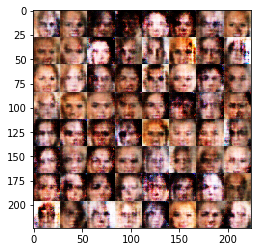

Epoch 1/1... Discriminator Loss: 0.7327... Generator Loss: 1.4935
Epoch 1/1... Discriminator Loss: 0.7255... Generator Loss: 1.7928
Epoch 1/1... Discriminator Loss: 0.9605... Generator Loss: 1.0087
Epoch 1/1... Discriminator Loss: 0.8704... Generator Loss: 1.9944
Epoch 1/1... Discriminator Loss: 1.2871... Generator Loss: 0.7579
Epoch 1/1... Discriminator Loss: 0.9516... Generator Loss: 2.1124
Epoch 1/1... Discriminator Loss: 0.8658... Generator Loss: 1.1561
Epoch 1/1... Discriminator Loss: 0.9379... Generator Loss: 1.4620
Epoch 1/1... Discriminator Loss: 1.0232... Generator Loss: 0.9786
Epoch 1/1... Discriminator Loss: 0.8873... Generator Loss: 2.4288


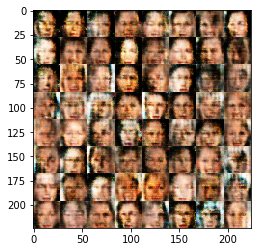

Epoch 1/1... Discriminator Loss: 0.9258... Generator Loss: 1.4055
Epoch 1/1... Discriminator Loss: 0.8200... Generator Loss: 1.5350
Epoch 1/1... Discriminator Loss: 0.8174... Generator Loss: 1.8250
Epoch 1/1... Discriminator Loss: 0.7445... Generator Loss: 1.2383
Epoch 1/1... Discriminator Loss: 0.7722... Generator Loss: 1.4135
Epoch 1/1... Discriminator Loss: 1.0178... Generator Loss: 1.0914
Epoch 1/1... Discriminator Loss: 0.9465... Generator Loss: 1.7335
Epoch 1/1... Discriminator Loss: 0.8267... Generator Loss: 1.2652
Epoch 1/1... Discriminator Loss: 0.7896... Generator Loss: 1.8473
Epoch 1/1... Discriminator Loss: 0.8731... Generator Loss: 1.3219


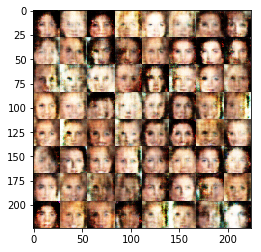

Epoch 1/1... Discriminator Loss: 1.1993... Generator Loss: 0.9447
Epoch 1/1... Discriminator Loss: 1.2277... Generator Loss: 2.5901
Epoch 1/1... Discriminator Loss: 1.5009... Generator Loss: 0.6416
Epoch 1/1... Discriminator Loss: 1.1705... Generator Loss: 4.2539
Epoch 1/1... Discriminator Loss: 0.7900... Generator Loss: 1.3825
Epoch 1/1... Discriminator Loss: 0.8891... Generator Loss: 1.1536
Epoch 1/1... Discriminator Loss: 0.7197... Generator Loss: 2.3977
Epoch 1/1... Discriminator Loss: 0.9040... Generator Loss: 1.2707
Epoch 1/1... Discriminator Loss: 0.7853... Generator Loss: 1.7971
Epoch 1/1... Discriminator Loss: 0.9545... Generator Loss: 1.1120


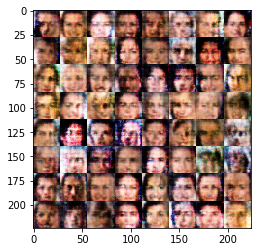

Epoch 1/1... Discriminator Loss: 0.8708... Generator Loss: 1.3609
Epoch 1/1... Discriminator Loss: 0.9425... Generator Loss: 1.0624
Epoch 1/1... Discriminator Loss: 0.7975... Generator Loss: 1.6655
Epoch 1/1... Discriminator Loss: 0.7098... Generator Loss: 1.5466
Epoch 1/1... Discriminator Loss: 0.8041... Generator Loss: 1.7297
Epoch 1/1... Discriminator Loss: 1.0082... Generator Loss: 0.9326
Epoch 1/1... Discriminator Loss: 0.8450... Generator Loss: 2.5598
Epoch 1/1... Discriminator Loss: 0.7305... Generator Loss: 1.3742
Epoch 1/1... Discriminator Loss: 0.8997... Generator Loss: 1.1595
Epoch 1/1... Discriminator Loss: 0.8026... Generator Loss: 2.4336


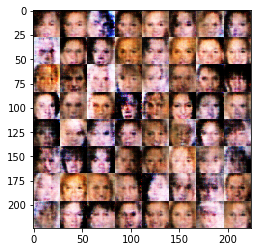

Epoch 1/1... Discriminator Loss: 0.8999... Generator Loss: 1.0521
Epoch 1/1... Discriminator Loss: 0.7957... Generator Loss: 1.5596
Epoch 1/1... Discriminator Loss: 0.8340... Generator Loss: 1.6266
Epoch 1/1... Discriminator Loss: 0.8264... Generator Loss: 1.3952
Epoch 1/1... Discriminator Loss: 0.8097... Generator Loss: 1.4805
Epoch 1/1... Discriminator Loss: 1.0732... Generator Loss: 1.0878
Epoch 1/1... Discriminator Loss: 0.9870... Generator Loss: 2.0633
Epoch 1/1... Discriminator Loss: 0.9287... Generator Loss: 1.1192
Epoch 1/1... Discriminator Loss: 0.8218... Generator Loss: 2.1728
Epoch 1/1... Discriminator Loss: 1.5970... Generator Loss: 0.5921


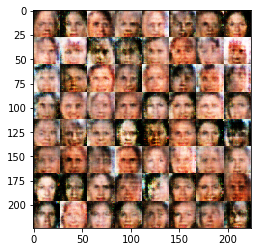

Epoch 1/1... Discriminator Loss: 1.1793... Generator Loss: 3.6583
Epoch 1/1... Discriminator Loss: 0.7429... Generator Loss: 1.4434
Epoch 1/1... Discriminator Loss: 1.0879... Generator Loss: 0.9069
Epoch 1/1... Discriminator Loss: 0.9838... Generator Loss: 2.3384
Epoch 1/1... Discriminator Loss: 1.1399... Generator Loss: 0.9387
Epoch 1/1... Discriminator Loss: 0.9161... Generator Loss: 1.5049
Epoch 1/1... Discriminator Loss: 0.9027... Generator Loss: 1.3143
Epoch 1/1... Discriminator Loss: 0.8571... Generator Loss: 1.1407
Epoch 1/1... Discriminator Loss: 0.8145... Generator Loss: 1.9281
Epoch 1/1... Discriminator Loss: 0.6817... Generator Loss: 1.9243


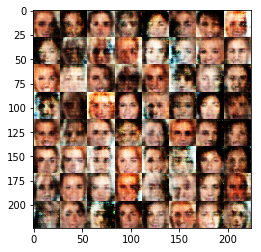

Epoch 1/1... Discriminator Loss: 1.1388... Generator Loss: 0.8760
Epoch 1/1... Discriminator Loss: 0.8041... Generator Loss: 2.0527
Epoch 1/1... Discriminator Loss: 0.7841... Generator Loss: 1.6373
Epoch 1/1... Discriminator Loss: 0.8239... Generator Loss: 1.1989
Epoch 1/1... Discriminator Loss: 0.8925... Generator Loss: 1.6704
Epoch 1/1... Discriminator Loss: 1.0364... Generator Loss: 1.0472
Epoch 1/1... Discriminator Loss: 0.9160... Generator Loss: 1.6853
Epoch 1/1... Discriminator Loss: 1.2637... Generator Loss: 0.7807
Epoch 1/1... Discriminator Loss: 1.3939... Generator Loss: 2.7048
Epoch 1/1... Discriminator Loss: 1.2818... Generator Loss: 0.7495


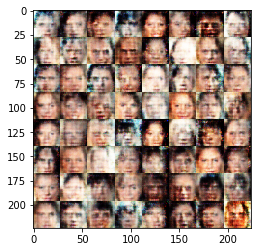

Epoch 1/1... Discriminator Loss: 0.7753... Generator Loss: 2.2574
Epoch 1/1... Discriminator Loss: 0.7248... Generator Loss: 1.4631
Epoch 1/1... Discriminator Loss: 1.0401... Generator Loss: 1.0182
Epoch 1/1... Discriminator Loss: 0.9254... Generator Loss: 2.4831
Epoch 1/1... Discriminator Loss: 0.9323... Generator Loss: 1.1757
Epoch 1/1... Discriminator Loss: 0.9942... Generator Loss: 1.3349
Epoch 1/1... Discriminator Loss: 0.9383... Generator Loss: 1.5419
Epoch 1/1... Discriminator Loss: 0.9192... Generator Loss: 1.1853
Epoch 1/1... Discriminator Loss: 0.8727... Generator Loss: 1.3311
Epoch 1/1... Discriminator Loss: 0.9131... Generator Loss: 1.3092


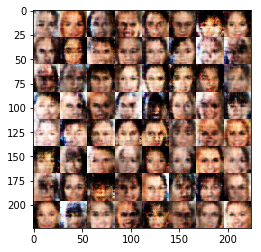

Epoch 1/1... Discriminator Loss: 1.0570... Generator Loss: 0.8483
Epoch 1/1... Discriminator Loss: 1.1534... Generator Loss: 2.8185
Epoch 1/1... Discriminator Loss: 1.0516... Generator Loss: 0.8909
Epoch 1/1... Discriminator Loss: 0.8734... Generator Loss: 2.2332
Epoch 1/1... Discriminator Loss: 0.7818... Generator Loss: 1.4178
Epoch 1/1... Discriminator Loss: 0.9395... Generator Loss: 1.1692
Epoch 1/1... Discriminator Loss: 0.9127... Generator Loss: 1.6217
Epoch 1/1... Discriminator Loss: 1.1405... Generator Loss: 0.9809
Epoch 1/1... Discriminator Loss: 0.9196... Generator Loss: 1.4615
Epoch 1/1... Discriminator Loss: 0.8860... Generator Loss: 1.3447


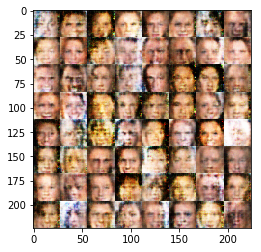

Epoch 1/1... Discriminator Loss: 0.7925... Generator Loss: 1.6249
Epoch 1/1... Discriminator Loss: 0.8301... Generator Loss: 1.1793
Epoch 1/1... Discriminator Loss: 0.9111... Generator Loss: 1.3546
Epoch 1/1... Discriminator Loss: 0.8643... Generator Loss: 1.5045
Epoch 1/1... Discriminator Loss: 0.8788... Generator Loss: 1.4659
Epoch 1/1... Discriminator Loss: 0.9595... Generator Loss: 1.1488
Epoch 1/1... Discriminator Loss: 0.8871... Generator Loss: 1.7486
Epoch 1/1... Discriminator Loss: 0.8447... Generator Loss: 1.5841
Epoch 1/1... Discriminator Loss: 1.7270... Generator Loss: 0.5815
Epoch 1/1... Discriminator Loss: 1.2341... Generator Loss: 3.0839


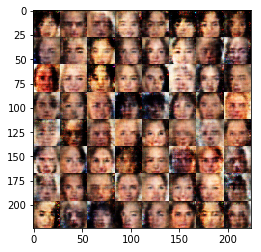

Epoch 1/1... Discriminator Loss: 0.8475... Generator Loss: 1.3885
Epoch 1/1... Discriminator Loss: 1.0784... Generator Loss: 0.9342
Epoch 1/1... Discriminator Loss: 1.1270... Generator Loss: 2.2450
Epoch 1/1... Discriminator Loss: 1.0749... Generator Loss: 0.8264
Epoch 1/1... Discriminator Loss: 0.9101... Generator Loss: 1.7811
Epoch 1/1... Discriminator Loss: 0.9777... Generator Loss: 1.0677
Epoch 1/1... Discriminator Loss: 0.8453... Generator Loss: 1.8090
Epoch 1/1... Discriminator Loss: 0.7310... Generator Loss: 1.7287
Epoch 1/1... Discriminator Loss: 0.8655... Generator Loss: 1.1821
Epoch 1/1... Discriminator Loss: 0.8400... Generator Loss: 1.5958


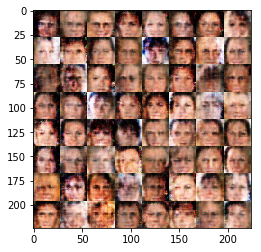

Epoch 1/1... Discriminator Loss: 0.9875... Generator Loss: 1.1330
Epoch 1/1... Discriminator Loss: 0.8269... Generator Loss: 2.0476
Epoch 1/1... Discriminator Loss: 1.0565... Generator Loss: 0.8570
Epoch 1/1... Discriminator Loss: 1.3264... Generator Loss: 2.8739
Epoch 1/1... Discriminator Loss: 1.1271... Generator Loss: 0.9648
Epoch 1/1... Discriminator Loss: 0.8896... Generator Loss: 1.3194
Epoch 1/1... Discriminator Loss: 0.9198... Generator Loss: 2.1241
Epoch 1/1... Discriminator Loss: 1.0430... Generator Loss: 0.9362
Epoch 1/1... Discriminator Loss: 0.8715... Generator Loss: 1.5975
Epoch 1/1... Discriminator Loss: 0.9158... Generator Loss: 1.2953


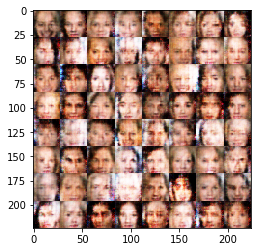

Epoch 1/1... Discriminator Loss: 0.8394... Generator Loss: 1.4402
Epoch 1/1... Discriminator Loss: 0.7956... Generator Loss: 1.3826
Epoch 1/1... Discriminator Loss: 0.9193... Generator Loss: 1.3429
Epoch 1/1... Discriminator Loss: 0.7639... Generator Loss: 1.5751
Epoch 1/1... Discriminator Loss: 0.9418... Generator Loss: 1.3923
Epoch 1/1... Discriminator Loss: 0.9819... Generator Loss: 1.0997
Epoch 1/1... Discriminator Loss: 0.8597... Generator Loss: 1.7538
Epoch 1/1... Discriminator Loss: 0.8163... Generator Loss: 1.2792
Epoch 1/1... Discriminator Loss: 0.8682... Generator Loss: 1.2702
Epoch 1/1... Discriminator Loss: 0.8265... Generator Loss: 1.7963


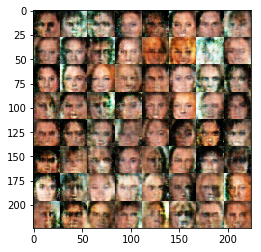

Epoch 1/1... Discriminator Loss: 0.8607... Generator Loss: 1.1664
Epoch 1/1... Discriminator Loss: 0.8953... Generator Loss: 1.5196
Epoch 1/1... Discriminator Loss: 1.0499... Generator Loss: 0.8875
Epoch 1/1... Discriminator Loss: 1.0538... Generator Loss: 1.9655
Epoch 1/1... Discriminator Loss: 0.8008... Generator Loss: 1.2546
Epoch 1/1... Discriminator Loss: 0.9649... Generator Loss: 1.1138
Epoch 1/1... Discriminator Loss: 0.9108... Generator Loss: 1.5151
Epoch 1/1... Discriminator Loss: 1.0124... Generator Loss: 0.9113
Epoch 1/1... Discriminator Loss: 1.3063... Generator Loss: 2.7212
Epoch 1/1... Discriminator Loss: 1.3752... Generator Loss: 0.7176


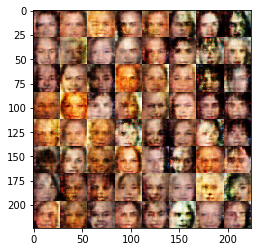

Epoch 1/1... Discriminator Loss: 0.9917... Generator Loss: 2.7757
Epoch 1/1... Discriminator Loss: 0.9265... Generator Loss: 0.9912
Epoch 1/1... Discriminator Loss: 0.8046... Generator Loss: 1.4943
Epoch 1/1... Discriminator Loss: 0.9896... Generator Loss: 1.6920
Epoch 1/1... Discriminator Loss: 1.0049... Generator Loss: 1.1050
Epoch 1/1... Discriminator Loss: 0.9184... Generator Loss: 1.6764
Epoch 1/1... Discriminator Loss: 1.0753... Generator Loss: 0.9233
Epoch 1/1... Discriminator Loss: 0.9291... Generator Loss: 1.6089
Epoch 1/1... Discriminator Loss: 0.9855... Generator Loss: 0.9988
Epoch 1/1... Discriminator Loss: 0.9218... Generator Loss: 1.3699


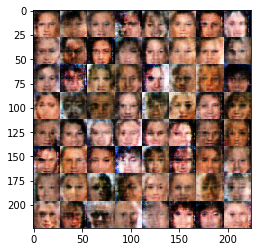

Epoch 1/1... Discriminator Loss: 0.8823... Generator Loss: 1.8257
Epoch 1/1... Discriminator Loss: 1.1472... Generator Loss: 0.7554
Epoch 1/1... Discriminator Loss: 0.8701... Generator Loss: 1.9796
Epoch 1/1... Discriminator Loss: 0.8150... Generator Loss: 1.4784
Epoch 1/1... Discriminator Loss: 0.8901... Generator Loss: 1.0508
Epoch 1/1... Discriminator Loss: 0.9176... Generator Loss: 1.5553
Epoch 1/1... Discriminator Loss: 1.1823... Generator Loss: 0.8694
Epoch 1/1... Discriminator Loss: 0.9895... Generator Loss: 2.1766
Epoch 1/1... Discriminator Loss: 0.7582... Generator Loss: 1.5015
Epoch 1/1... Discriminator Loss: 0.7858... Generator Loss: 1.2544


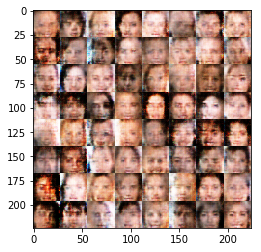

Epoch 1/1... Discriminator Loss: 0.8236... Generator Loss: 1.5360
Epoch 1/1... Discriminator Loss: 0.9888... Generator Loss: 1.1131
Epoch 1/1... Discriminator Loss: 0.9261... Generator Loss: 1.6643
Epoch 1/1... Discriminator Loss: 1.0187... Generator Loss: 1.0963
Epoch 1/1... Discriminator Loss: 0.9507... Generator Loss: 1.3207
Epoch 1/1... Discriminator Loss: 0.8434... Generator Loss: 1.6789
Epoch 1/1... Discriminator Loss: 1.0523... Generator Loss: 0.9779
Epoch 1/1... Discriminator Loss: 0.9675... Generator Loss: 2.1631
Epoch 1/1... Discriminator Loss: 1.2010... Generator Loss: 0.8983
Epoch 1/1... Discriminator Loss: 1.1680... Generator Loss: 2.5996


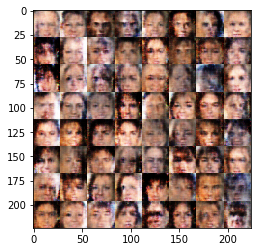

Epoch 1/1... Discriminator Loss: 0.8796... Generator Loss: 1.0099
Epoch 1/1... Discriminator Loss: 1.1001... Generator Loss: 1.2124
Epoch 1/1... Discriminator Loss: 0.9347... Generator Loss: 1.4569
Epoch 1/1... Discriminator Loss: 1.0270... Generator Loss: 1.0751
Epoch 1/1... Discriminator Loss: 0.8380... Generator Loss: 1.6054
Epoch 1/1... Discriminator Loss: 0.8773... Generator Loss: 1.4027
Epoch 1/1... Discriminator Loss: 0.8993... Generator Loss: 1.1999
Epoch 1/1... Discriminator Loss: 0.9290... Generator Loss: 1.6358
Epoch 1/1... Discriminator Loss: 0.8618... Generator Loss: 1.3558
Epoch 1/1... Discriminator Loss: 1.0045... Generator Loss: 1.3930


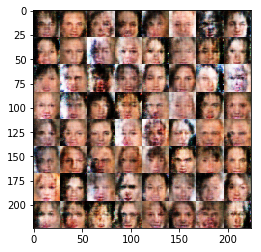

Epoch 1/1... Discriminator Loss: 1.1225... Generator Loss: 1.0095
Epoch 1/1... Discriminator Loss: 1.1383... Generator Loss: 1.7402
Epoch 1/1... Discriminator Loss: 1.1307... Generator Loss: 0.9840
Epoch 1/1... Discriminator Loss: 1.0123... Generator Loss: 1.1023
Epoch 1/1... Discriminator Loss: 0.9057... Generator Loss: 1.9068
Epoch 1/1... Discriminator Loss: 0.9660... Generator Loss: 1.0611
Epoch 1/1... Discriminator Loss: 0.9431... Generator Loss: 1.1068
Epoch 1/1... Discriminator Loss: 0.9412... Generator Loss: 1.3954
Epoch 1/1... Discriminator Loss: 1.2043... Generator Loss: 0.8706
Epoch 1/1... Discriminator Loss: 1.5109... Generator Loss: 2.9509


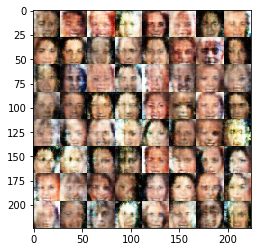

Epoch 1/1... Discriminator Loss: 1.4642... Generator Loss: 0.6528
Epoch 1/1... Discriminator Loss: 1.0674... Generator Loss: 2.0332
Epoch 1/1... Discriminator Loss: 1.0920... Generator Loss: 0.8760
Epoch 1/1... Discriminator Loss: 0.8746... Generator Loss: 1.9065
Epoch 1/1... Discriminator Loss: 1.0727... Generator Loss: 1.0839
Epoch 1/1... Discriminator Loss: 1.0139... Generator Loss: 1.1645
Epoch 1/1... Discriminator Loss: 0.8665... Generator Loss: 1.4490
Epoch 1/1... Discriminator Loss: 0.9069... Generator Loss: 1.3689
Epoch 1/1... Discriminator Loss: 0.8665... Generator Loss: 1.1407
Epoch 1/1... Discriminator Loss: 0.8682... Generator Loss: 1.2473


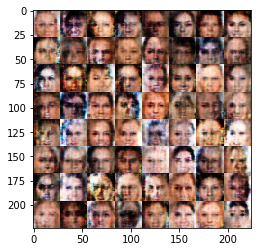

Epoch 1/1... Discriminator Loss: 0.8580... Generator Loss: 1.3973
Epoch 1/1... Discriminator Loss: 1.0275... Generator Loss: 1.0971
Epoch 1/1... Discriminator Loss: 0.9908... Generator Loss: 1.3811
Epoch 1/1... Discriminator Loss: 1.0899... Generator Loss: 1.1372
Epoch 1/1... Discriminator Loss: 0.9839... Generator Loss: 1.2692
Epoch 1/1... Discriminator Loss: 1.0229... Generator Loss: 1.3046
Epoch 1/1... Discriminator Loss: 0.9622... Generator Loss: 1.0861
Epoch 1/1... Discriminator Loss: 0.9186... Generator Loss: 1.0145
Epoch 1/1... Discriminator Loss: 0.9246... Generator Loss: 1.9958
Epoch 1/1... Discriminator Loss: 0.7974... Generator Loss: 1.3062


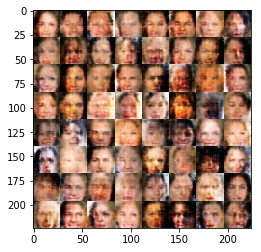

Epoch 1/1... Discriminator Loss: 0.8818... Generator Loss: 1.1750
Epoch 1/1... Discriminator Loss: 0.9673... Generator Loss: 1.6708
Epoch 1/1... Discriminator Loss: 1.0467... Generator Loss: 0.8614
Epoch 1/1... Discriminator Loss: 1.0227... Generator Loss: 1.9308
Epoch 1/1... Discriminator Loss: 1.1354... Generator Loss: 0.7893
Epoch 1/1... Discriminator Loss: 0.9461... Generator Loss: 1.5988
Epoch 1/1... Discriminator Loss: 0.7513... Generator Loss: 1.7492
Epoch 1/1... Discriminator Loss: 1.0597... Generator Loss: 0.8661
Epoch 1/1... Discriminator Loss: 0.9401... Generator Loss: 1.6241
Epoch 1/1... Discriminator Loss: 0.9719... Generator Loss: 1.1045


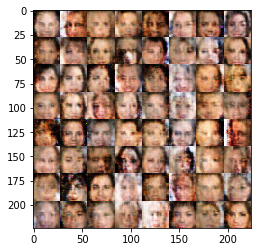

Epoch 1/1... Discriminator Loss: 0.9051... Generator Loss: 1.3794
Epoch 1/1... Discriminator Loss: 1.0274... Generator Loss: 1.1856
Epoch 1/1... Discriminator Loss: 0.9937... Generator Loss: 1.3980
Epoch 1/1... Discriminator Loss: 1.0885... Generator Loss: 0.8699
Epoch 1/1... Discriminator Loss: 0.9156... Generator Loss: 1.5185
Epoch 1/1... Discriminator Loss: 0.8209... Generator Loss: 1.5925
Epoch 1/1... Discriminator Loss: 1.1126... Generator Loss: 0.8684
Epoch 1/1... Discriminator Loss: 0.8999... Generator Loss: 1.4731
Epoch 1/1... Discriminator Loss: 0.9232... Generator Loss: 1.5339
Epoch 1/1... Discriminator Loss: 1.2717... Generator Loss: 0.7755


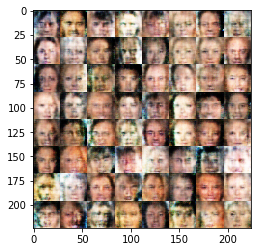

Epoch 1/1... Discriminator Loss: 1.1914... Generator Loss: 3.0230
Epoch 1/1... Discriminator Loss: 1.0794... Generator Loss: 0.9018
Epoch 1/1... Discriminator Loss: 0.8247... Generator Loss: 1.3416
Epoch 1/1... Discriminator Loss: 0.9808... Generator Loss: 2.0508
Epoch 1/1... Discriminator Loss: 0.9126... Generator Loss: 1.1616
Epoch 1/1... Discriminator Loss: 0.9761... Generator Loss: 1.1550
Epoch 1/1... Discriminator Loss: 0.8290... Generator Loss: 2.0029
Epoch 1/1... Discriminator Loss: 0.9883... Generator Loss: 0.9342
Epoch 1/1... Discriminator Loss: 0.9707... Generator Loss: 1.4808
Epoch 1/1... Discriminator Loss: 1.0401... Generator Loss: 1.2383


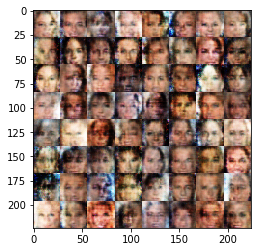

Epoch 1/1... Discriminator Loss: 1.0153... Generator Loss: 1.4149
Epoch 1/1... Discriminator Loss: 0.9963... Generator Loss: 1.1538
Epoch 1/1... Discriminator Loss: 1.0463... Generator Loss: 1.3581
Epoch 1/1... Discriminator Loss: 1.0696... Generator Loss: 1.1301
Epoch 1/1... Discriminator Loss: 1.1820... Generator Loss: 0.8218
Epoch 1/1... Discriminator Loss: 1.2922... Generator Loss: 2.2796
Epoch 1/1... Discriminator Loss: 1.1311... Generator Loss: 0.9235
Epoch 1/1... Discriminator Loss: 0.8898... Generator Loss: 1.1793
Epoch 1/1... Discriminator Loss: 0.7677... Generator Loss: 1.6656
Epoch 1/1... Discriminator Loss: 0.9777... Generator Loss: 1.0992


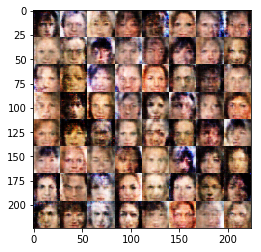

Epoch 1/1... Discriminator Loss: 0.9141... Generator Loss: 1.3746
Epoch 1/1... Discriminator Loss: 0.9668... Generator Loss: 1.2746
Epoch 1/1... Discriminator Loss: 0.8795... Generator Loss: 1.2227
Epoch 1/1... Discriminator Loss: 1.0086... Generator Loss: 1.0669
Epoch 1/1... Discriminator Loss: 0.9016... Generator Loss: 1.6923
Epoch 1/1... Discriminator Loss: 0.9519... Generator Loss: 0.9613
Epoch 1/1... Discriminator Loss: 0.8463... Generator Loss: 1.3491
Epoch 1/1... Discriminator Loss: 0.8903... Generator Loss: 1.5367
Epoch 1/1... Discriminator Loss: 1.1345... Generator Loss: 0.9419
Epoch 1/1... Discriminator Loss: 0.9022... Generator Loss: 1.5726


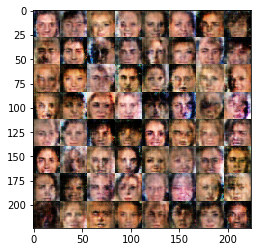

Epoch 1/1... Discriminator Loss: 0.9230... Generator Loss: 1.4286
Epoch 1/1... Discriminator Loss: 0.9378... Generator Loss: 1.1930
Epoch 1/1... Discriminator Loss: 1.0068... Generator Loss: 1.1229
Epoch 1/1... Discriminator Loss: 0.8472... Generator Loss: 1.5103
Epoch 1/1... Discriminator Loss: 1.1989... Generator Loss: 0.7464
Epoch 1/1... Discriminator Loss: 1.0484... Generator Loss: 2.2840
Epoch 1/1... Discriminator Loss: 1.2236... Generator Loss: 0.7611
Epoch 1/1... Discriminator Loss: 0.9585... Generator Loss: 1.9508
Epoch 1/1... Discriminator Loss: 0.9696... Generator Loss: 1.4076
Epoch 1/1... Discriminator Loss: 1.0639... Generator Loss: 0.9080


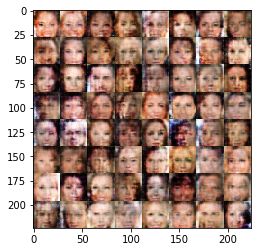

Epoch 1/1... Discriminator Loss: 0.9052... Generator Loss: 1.3471
Epoch 1/1... Discriminator Loss: 0.9354... Generator Loss: 1.3892
Epoch 1/1... Discriminator Loss: 0.9226... Generator Loss: 1.2373
Epoch 1/1... Discriminator Loss: 0.9488... Generator Loss: 1.2199
Epoch 1/1... Discriminator Loss: 0.8605... Generator Loss: 1.6945
Epoch 1/1... Discriminator Loss: 1.0526... Generator Loss: 0.8553
Epoch 1/1... Discriminator Loss: 0.8699... Generator Loss: 1.9952
Epoch 1/1... Discriminator Loss: 1.0025... Generator Loss: 1.0046
Epoch 1/1... Discriminator Loss: 0.9471... Generator Loss: 1.7100
Epoch 1/1... Discriminator Loss: 1.0633... Generator Loss: 0.9321


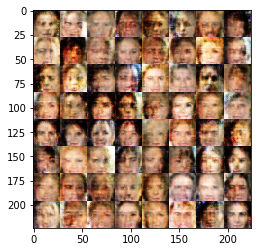

Epoch 1/1... Discriminator Loss: 0.9321... Generator Loss: 1.6038
Epoch 1/1... Discriminator Loss: 0.9221... Generator Loss: 1.0579
Epoch 1/1... Discriminator Loss: 0.8767... Generator Loss: 1.4425
Epoch 1/1... Discriminator Loss: 0.8838... Generator Loss: 1.2687
Epoch 1/1... Discriminator Loss: 0.8847... Generator Loss: 1.5840
Epoch 1/1... Discriminator Loss: 0.9994... Generator Loss: 1.0340
Epoch 1/1... Discriminator Loss: 0.8850... Generator Loss: 1.5405
Epoch 1/1... Discriminator Loss: 0.8741... Generator Loss: 1.1589
Epoch 1/1... Discriminator Loss: 0.9441... Generator Loss: 1.3026
Epoch 1/1... Discriminator Loss: 1.0596... Generator Loss: 1.0053


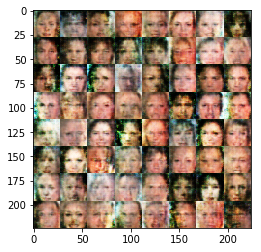

Epoch 1/1... Discriminator Loss: 0.9594... Generator Loss: 1.7184
Epoch 1/1... Discriminator Loss: 1.0112... Generator Loss: 0.9216
Epoch 1/1... Discriminator Loss: 0.9801... Generator Loss: 1.4604
Epoch 1/1... Discriminator Loss: 1.0198... Generator Loss: 1.0178
Epoch 1/1... Discriminator Loss: 0.8316... Generator Loss: 1.9763
Epoch 1/1... Discriminator Loss: 0.9729... Generator Loss: 1.1251
Epoch 1/1... Discriminator Loss: 0.9383... Generator Loss: 1.5638
Epoch 1/1... Discriminator Loss: 0.9666... Generator Loss: 1.0971
Epoch 1/1... Discriminator Loss: 0.8770... Generator Loss: 1.9157
Epoch 1/1... Discriminator Loss: 1.1566... Generator Loss: 0.7763


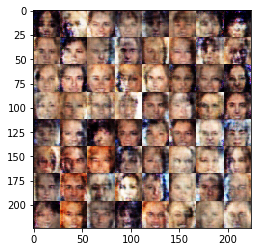

Epoch 1/1... Discriminator Loss: 0.9688... Generator Loss: 1.4794
Epoch 1/1... Discriminator Loss: 0.8899... Generator Loss: 1.6124
Epoch 1/1... Discriminator Loss: 1.0057... Generator Loss: 0.9700
Epoch 1/1... Discriminator Loss: 0.8045... Generator Loss: 2.0587
Epoch 1/1... Discriminator Loss: 0.7637... Generator Loss: 1.5986
Epoch 1/1... Discriminator Loss: 0.8815... Generator Loss: 1.0573
Epoch 1/1... Discriminator Loss: 0.9338... Generator Loss: 1.5500
Epoch 1/1... Discriminator Loss: 0.9809... Generator Loss: 1.1381
Epoch 1/1... Discriminator Loss: 1.1341... Generator Loss: 0.9160
Epoch 1/1... Discriminator Loss: 1.0519... Generator Loss: 2.3708


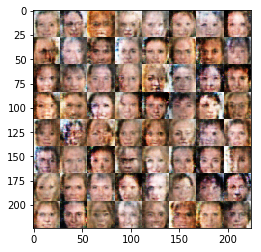

Epoch 1/1... Discriminator Loss: 1.1686... Generator Loss: 0.7769
Epoch 1/1... Discriminator Loss: 0.9336... Generator Loss: 1.7641
Epoch 1/1... Discriminator Loss: 0.9107... Generator Loss: 1.3023
Epoch 1/1... Discriminator Loss: 1.1929... Generator Loss: 0.8527
Epoch 1/1... Discriminator Loss: 1.0973... Generator Loss: 1.9505
Epoch 1/1... Discriminator Loss: 1.0968... Generator Loss: 0.8818
Epoch 1/1... Discriminator Loss: 0.9138... Generator Loss: 1.1911
Epoch 1/1... Discriminator Loss: 1.0099... Generator Loss: 1.3042
Epoch 1/1... Discriminator Loss: 1.0747... Generator Loss: 1.1155
Epoch 1/1... Discriminator Loss: 1.1029... Generator Loss: 1.0879


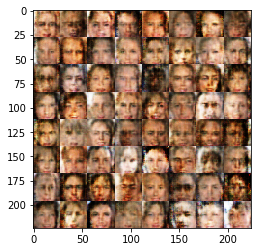

Epoch 1/1... Discriminator Loss: 1.0215... Generator Loss: 1.3658
Epoch 1/1... Discriminator Loss: 1.1305... Generator Loss: 0.9328
Epoch 1/1... Discriminator Loss: 0.9428... Generator Loss: 1.6535
Epoch 1/1... Discriminator Loss: 1.0740... Generator Loss: 0.9933
Epoch 1/1... Discriminator Loss: 0.8567... Generator Loss: 1.4635
Epoch 1/1... Discriminator Loss: 0.9780... Generator Loss: 1.8204
Epoch 1/1... Discriminator Loss: 0.9832... Generator Loss: 1.0119
Epoch 1/1... Discriminator Loss: 0.9755... Generator Loss: 1.7182
Epoch 1/1... Discriminator Loss: 0.9980... Generator Loss: 1.0535
Epoch 1/1... Discriminator Loss: 0.9294... Generator Loss: 1.2435


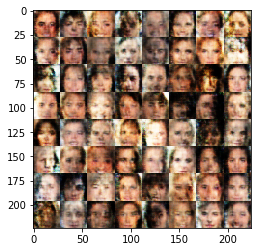

Epoch 1/1... Discriminator Loss: 0.9857... Generator Loss: 1.2987
Epoch 1/1... Discriminator Loss: 1.0676... Generator Loss: 0.9060
Epoch 1/1... Discriminator Loss: 1.0508... Generator Loss: 1.4263
Epoch 1/1... Discriminator Loss: 0.9238... Generator Loss: 1.0538
Epoch 1/1... Discriminator Loss: 0.8825... Generator Loss: 1.5198
Epoch 1/1... Discriminator Loss: 0.8953... Generator Loss: 1.2851
Epoch 1/1... Discriminator Loss: 0.9001... Generator Loss: 1.2390
Epoch 1/1... Discriminator Loss: 0.9368... Generator Loss: 1.6559
Epoch 1/1... Discriminator Loss: 1.0249... Generator Loss: 1.0463
Epoch 1/1... Discriminator Loss: 0.9533... Generator Loss: 1.1825


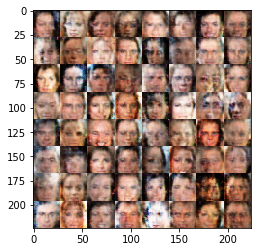

Epoch 1/1... Discriminator Loss: 0.9419... Generator Loss: 1.3327
Epoch 1/1... Discriminator Loss: 0.8896... Generator Loss: 1.3575
Epoch 1/1... Discriminator Loss: 0.8038... Generator Loss: 1.4438
Epoch 1/1... Discriminator Loss: 0.7910... Generator Loss: 1.2705
Epoch 1/1... Discriminator Loss: 0.9825... Generator Loss: 0.9179
Epoch 1/1... Discriminator Loss: 1.0463... Generator Loss: 1.8698
Epoch 1/1... Discriminator Loss: 0.9519... Generator Loss: 1.0602
Epoch 1/1... Discriminator Loss: 0.9057... Generator Loss: 1.8320
Epoch 1/1... Discriminator Loss: 1.0250... Generator Loss: 0.9525
Epoch 1/1... Discriminator Loss: 0.9548... Generator Loss: 1.8758


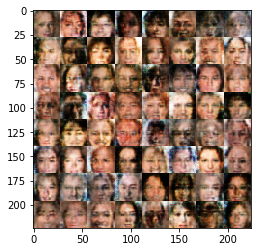

Epoch 1/1... Discriminator Loss: 1.2116... Generator Loss: 0.7820
Epoch 1/1... Discriminator Loss: 0.9576... Generator Loss: 1.9607
Epoch 1/1... Discriminator Loss: 0.9943... Generator Loss: 0.9623
Epoch 1/1... Discriminator Loss: 1.0095... Generator Loss: 1.2373
Epoch 1/1... Discriminator Loss: 0.9333... Generator Loss: 1.9888
Epoch 1/1... Discriminator Loss: 1.0991... Generator Loss: 0.9215
Epoch 1/1... Discriminator Loss: 0.7936... Generator Loss: 1.4502
Epoch 1/1... Discriminator Loss: 0.9253... Generator Loss: 1.0471
Epoch 1/1... Discriminator Loss: 0.9006... Generator Loss: 1.5415
Epoch 1/1... Discriminator Loss: 1.0077... Generator Loss: 1.1494


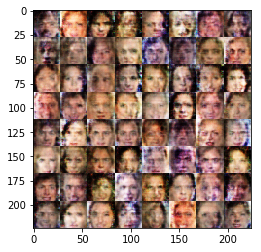

Epoch 1/1... Discriminator Loss: 0.9339... Generator Loss: 1.1971
Epoch 1/1... Discriminator Loss: 0.8842... Generator Loss: 1.3252
Epoch 1/1... Discriminator Loss: 0.9485... Generator Loss: 1.2362
Epoch 1/1... Discriminator Loss: 0.8928... Generator Loss: 1.2335
Epoch 1/1... Discriminator Loss: 0.8470... Generator Loss: 1.3302
Epoch 1/1... Discriminator Loss: 0.9059... Generator Loss: 1.3201
Epoch 1/1... Discriminator Loss: 0.8837... Generator Loss: 1.2762
Epoch 1/1... Discriminator Loss: 0.8175... Generator Loss: 1.4856
Epoch 1/1... Discriminator Loss: 0.8382... Generator Loss: 1.5644
Epoch 1/1... Discriminator Loss: 0.8910... Generator Loss: 1.4065


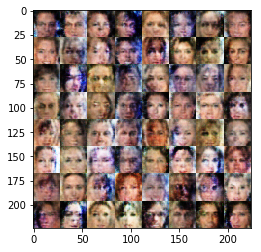

Epoch 1/1... Discriminator Loss: 0.9207... Generator Loss: 0.9518
Epoch 1/1... Discriminator Loss: 0.9854... Generator Loss: 1.2952
Epoch 1/1... Discriminator Loss: 0.8173... Generator Loss: 1.7547
Epoch 1/1... Discriminator Loss: 1.0408... Generator Loss: 0.9710
Epoch 1/1... Discriminator Loss: 0.8703... Generator Loss: 1.6175
Epoch 1/1... Discriminator Loss: 0.9153... Generator Loss: 1.4637
Epoch 1/1... Discriminator Loss: 0.9209... Generator Loss: 1.1747
Epoch 1/1... Discriminator Loss: 1.0144... Generator Loss: 1.2455
Epoch 1/1... Discriminator Loss: 0.9340... Generator Loss: 1.7187
Epoch 1/1... Discriminator Loss: 1.1218... Generator Loss: 0.9609


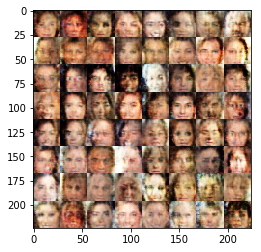

Epoch 1/1... Discriminator Loss: 0.9015... Generator Loss: 1.4472
Epoch 1/1... Discriminator Loss: 0.9303... Generator Loss: 1.4645
Epoch 1/1... Discriminator Loss: 0.8692... Generator Loss: 1.0950
Epoch 1/1... Discriminator Loss: 0.9888... Generator Loss: 1.1652
Epoch 1/1... Discriminator Loss: 0.9122... Generator Loss: 1.5333
Epoch 1/1... Discriminator Loss: 0.9323... Generator Loss: 1.0694
Epoch 1/1... Discriminator Loss: 0.8293... Generator Loss: 1.7880
Epoch 1/1... Discriminator Loss: 1.1449... Generator Loss: 0.9390
Epoch 1/1... Discriminator Loss: 0.8430... Generator Loss: 1.3876
Epoch 1/1... Discriminator Loss: 0.9911... Generator Loss: 1.4466


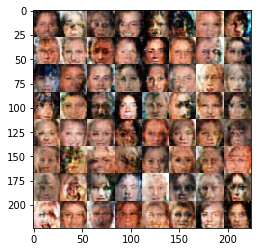

Epoch 1/1... Discriminator Loss: 1.0250... Generator Loss: 0.9434
Epoch 1/1... Discriminator Loss: 0.8349... Generator Loss: 1.4516
Epoch 1/1... Discriminator Loss: 0.8358... Generator Loss: 1.4073
Epoch 1/1... Discriminator Loss: 0.8429... Generator Loss: 1.2380
Epoch 1/1... Discriminator Loss: 0.8504... Generator Loss: 1.3625
Epoch 1/1... Discriminator Loss: 0.8010... Generator Loss: 1.3021
Epoch 1/1... Discriminator Loss: 0.7877... Generator Loss: 1.5693
Epoch 1/1... Discriminator Loss: 0.8742... Generator Loss: 1.0839
Epoch 1/1... Discriminator Loss: 1.0385... Generator Loss: 1.0227
Epoch 1/1... Discriminator Loss: 0.8334... Generator Loss: 1.5566


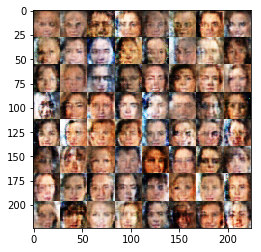

Epoch 1/1... Discriminator Loss: 0.8522... Generator Loss: 1.2919
Epoch 1/1... Discriminator Loss: 0.8644... Generator Loss: 1.2372
Epoch 1/1... Discriminator Loss: 0.9538... Generator Loss: 1.9444
Epoch 1/1... Discriminator Loss: 0.8757... Generator Loss: 1.1158
Epoch 1/1... Discriminator Loss: 0.8775... Generator Loss: 1.2246
Epoch 1/1... Discriminator Loss: 0.8904... Generator Loss: 1.5155
Epoch 1/1... Discriminator Loss: 0.9002... Generator Loss: 1.1531
Epoch 1/1... Discriminator Loss: 0.9460... Generator Loss: 1.2969
Epoch 1/1... Discriminator Loss: 0.8876... Generator Loss: 1.2584
Epoch 1/1... Discriminator Loss: 1.0412... Generator Loss: 1.4042


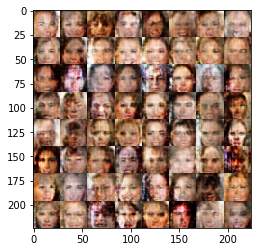

Epoch 1/1... Discriminator Loss: 1.0105... Generator Loss: 1.0799
Epoch 1/1... Discriminator Loss: 0.9833... Generator Loss: 0.9982
Epoch 1/1... Discriminator Loss: 0.9879... Generator Loss: 1.8641
Epoch 1/1... Discriminator Loss: 1.1139... Generator Loss: 0.8895
Epoch 1/1... Discriminator Loss: 1.0119... Generator Loss: 2.0895
Epoch 1/1... Discriminator Loss: 0.9674... Generator Loss: 1.3006
Epoch 1/1... Discriminator Loss: 1.0340... Generator Loss: 0.9483
Epoch 1/1... Discriminator Loss: 0.9496... Generator Loss: 1.8122
Epoch 1/1... Discriminator Loss: 0.9327... Generator Loss: 1.0058
Epoch 1/1... Discriminator Loss: 0.9122... Generator Loss: 1.5909


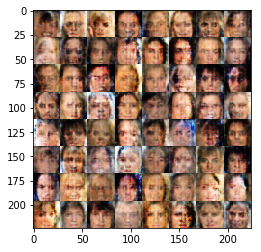

Epoch 1/1... Discriminator Loss: 0.8519... Generator Loss: 1.4328
Epoch 1/1... Discriminator Loss: 1.2741... Generator Loss: 0.7923
Epoch 1/1... Discriminator Loss: 1.1937... Generator Loss: 2.1774
Epoch 1/1... Discriminator Loss: 1.0691... Generator Loss: 0.9680
Epoch 1/1... Discriminator Loss: 0.9981... Generator Loss: 1.2194
Epoch 1/1... Discriminator Loss: 0.9462... Generator Loss: 1.3659
Epoch 1/1... Discriminator Loss: 0.9783... Generator Loss: 1.0490
Epoch 1/1... Discriminator Loss: 0.8599... Generator Loss: 1.5767
Epoch 1/1... Discriminator Loss: 0.8855... Generator Loss: 1.2172
Epoch 1/1... Discriminator Loss: 0.8754... Generator Loss: 1.2358


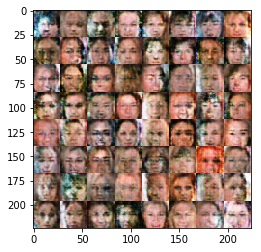

Epoch 1/1... Discriminator Loss: 0.7869... Generator Loss: 1.5750
Epoch 1/1... Discriminator Loss: 0.9366... Generator Loss: 1.2492
Epoch 1/1... Discriminator Loss: 0.9221... Generator Loss: 1.1797
Epoch 1/1... Discriminator Loss: 1.0064... Generator Loss: 1.4679
Epoch 1/1... Discriminator Loss: 1.0344... Generator Loss: 0.9210
Epoch 1/1... Discriminator Loss: 0.9476... Generator Loss: 1.3796
Epoch 1/1... Discriminator Loss: 0.8761... Generator Loss: 1.3732
Epoch 1/1... Discriminator Loss: 0.9146... Generator Loss: 1.2750
Epoch 1/1... Discriminator Loss: 0.9655... Generator Loss: 1.3571
Epoch 1/1... Discriminator Loss: 0.8227... Generator Loss: 1.3438


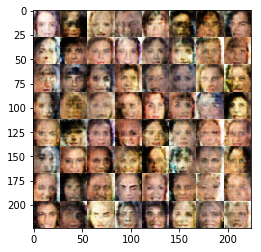

Epoch 1/1... Discriminator Loss: 0.9528... Generator Loss: 1.0408
Epoch 1/1... Discriminator Loss: 0.9657... Generator Loss: 1.7459
Epoch 1/1... Discriminator Loss: 1.0459... Generator Loss: 0.9640
Epoch 1/1... Discriminator Loss: 0.9201... Generator Loss: 1.6664
Epoch 1/1... Discriminator Loss: 0.9419... Generator Loss: 1.2592
Epoch 1/1... Discriminator Loss: 0.8966... Generator Loss: 1.2280
Epoch 1/1... Discriminator Loss: 0.8932... Generator Loss: 1.7134
Epoch 1/1... Discriminator Loss: 1.1099... Generator Loss: 0.7408
Epoch 1/1... Discriminator Loss: 0.7971... Generator Loss: 1.7950
Epoch 1/1... Discriminator Loss: 0.8899... Generator Loss: 1.3569


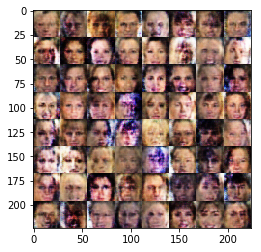

Epoch 1/1... Discriminator Loss: 1.0796... Generator Loss: 0.8124
Epoch 1/1... Discriminator Loss: 1.1011... Generator Loss: 1.5264
Epoch 1/1... Discriminator Loss: 1.0494... Generator Loss: 1.0168
Epoch 1/1... Discriminator Loss: 0.8453... Generator Loss: 1.5033
Epoch 1/1... Discriminator Loss: 0.9964... Generator Loss: 1.1522
Epoch 1/1... Discriminator Loss: 0.9492... Generator Loss: 1.0912
Epoch 1/1... Discriminator Loss: 0.8381... Generator Loss: 1.4714
Epoch 1/1... Discriminator Loss: 0.8677... Generator Loss: 1.3233
Epoch 1/1... Discriminator Loss: 0.8934... Generator Loss: 1.2464
Epoch 1/1... Discriminator Loss: 0.8715... Generator Loss: 1.1410


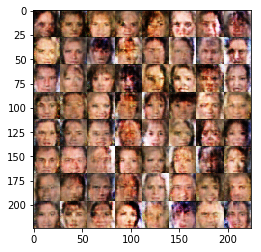

Epoch 1/1... Discriminator Loss: 0.8660... Generator Loss: 1.3246
Epoch 1/1... Discriminator Loss: 1.0014... Generator Loss: 1.5596
Epoch 1/1... Discriminator Loss: 1.0815... Generator Loss: 0.9436
Epoch 1/1... Discriminator Loss: 0.8595... Generator Loss: 1.6071
Epoch 1/1... Discriminator Loss: 0.9816... Generator Loss: 1.0251
Epoch 1/1... Discriminator Loss: 0.8777... Generator Loss: 1.2410
Epoch 1/1... Discriminator Loss: 0.9031... Generator Loss: 1.5983
Epoch 1/1... Discriminator Loss: 1.0289... Generator Loss: 1.0095
Epoch 1/1... Discriminator Loss: 0.8046... Generator Loss: 1.6924
Epoch 1/1... Discriminator Loss: 0.8797... Generator Loss: 1.0855


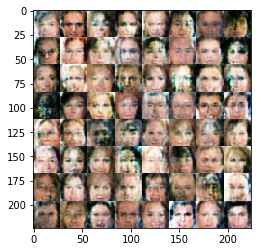

Epoch 1/1... Discriminator Loss: 0.7714... Generator Loss: 1.7939
Epoch 1/1... Discriminator Loss: 0.8393... Generator Loss: 1.7078
Epoch 1/1... Discriminator Loss: 0.9191... Generator Loss: 1.0755
Epoch 1/1... Discriminator Loss: 1.0034... Generator Loss: 1.5775
Epoch 1/1... Discriminator Loss: 1.1203... Generator Loss: 0.8484
Epoch 1/1... Discriminator Loss: 1.1181... Generator Loss: 1.5047
Epoch 1/1... Discriminator Loss: 1.0347... Generator Loss: 0.9912
Epoch 1/1... Discriminator Loss: 0.9922... Generator Loss: 0.9079
Epoch 1/1... Discriminator Loss: 1.0249... Generator Loss: 2.1691
Epoch 1/1... Discriminator Loss: 0.8453... Generator Loss: 1.0815


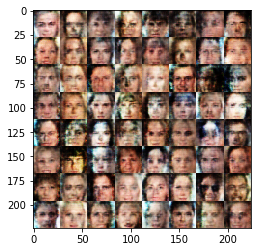

Epoch 1/1... Discriminator Loss: 0.8296... Generator Loss: 1.3479
Epoch 1/1... Discriminator Loss: 0.9893... Generator Loss: 0.9931
Epoch 1/1... Discriminator Loss: 0.9823... Generator Loss: 2.0136
Epoch 1/1... Discriminator Loss: 0.9213... Generator Loss: 1.0305
Epoch 1/1... Discriminator Loss: 0.8606... Generator Loss: 1.3319
Epoch 1/1... Discriminator Loss: 0.9357... Generator Loss: 1.0926
Epoch 1/1... Discriminator Loss: 0.8475... Generator Loss: 1.3744
Epoch 1/1... Discriminator Loss: 0.9192... Generator Loss: 1.1325
Epoch 1/1... Discriminator Loss: 1.0001... Generator Loss: 1.5072
Epoch 1/1... Discriminator Loss: 0.9601... Generator Loss: 0.9555


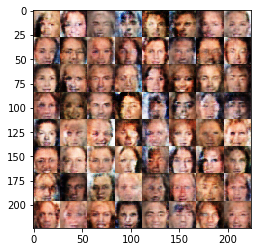

Epoch 1/1... Discriminator Loss: 0.8419... Generator Loss: 1.7161
Epoch 1/1... Discriminator Loss: 1.1083... Generator Loss: 0.7935
Epoch 1/1... Discriminator Loss: 0.8453... Generator Loss: 2.1150
Epoch 1/1... Discriminator Loss: 0.9622... Generator Loss: 1.0770
Epoch 1/1... Discriminator Loss: 0.9381... Generator Loss: 1.3830
Epoch 1/1... Discriminator Loss: 0.9225... Generator Loss: 1.1765
Epoch 1/1... Discriminator Loss: 0.8786... Generator Loss: 1.0728
Epoch 1/1... Discriminator Loss: 0.8537... Generator Loss: 1.8434
Epoch 1/1... Discriminator Loss: 0.9864... Generator Loss: 1.0401
Epoch 1/1... Discriminator Loss: 0.9710... Generator Loss: 1.1129


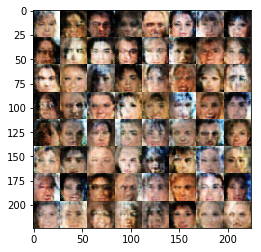

Epoch 1/1... Discriminator Loss: 0.8465... Generator Loss: 1.7578
Epoch 1/1... Discriminator Loss: 0.9474... Generator Loss: 1.1149
Epoch 1/1... Discriminator Loss: 0.8280... Generator Loss: 1.6963
Epoch 1/1... Discriminator Loss: 0.7930... Generator Loss: 1.7171
Epoch 1/1... Discriminator Loss: 0.9616... Generator Loss: 1.0290
Epoch 1/1... Discriminator Loss: 0.9956... Generator Loss: 1.2119
Epoch 1/1... Discriminator Loss: 1.0076... Generator Loss: 1.0595
Epoch 1/1... Discriminator Loss: 0.8498... Generator Loss: 1.3613
Epoch 1/1... Discriminator Loss: 0.8192... Generator Loss: 1.4322
Epoch 1/1... Discriminator Loss: 0.9076... Generator Loss: 1.1115


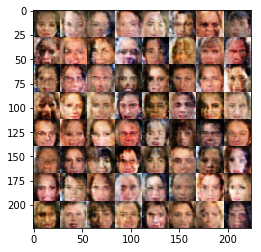

Epoch 1/1... Discriminator Loss: 0.9484... Generator Loss: 1.4209
Epoch 1/1... Discriminator Loss: 0.8920... Generator Loss: 1.3393
Epoch 1/1... Discriminator Loss: 0.9148... Generator Loss: 1.2207
Epoch 1/1... Discriminator Loss: 0.7834... Generator Loss: 1.4058
Epoch 1/1... Discriminator Loss: 1.0352... Generator Loss: 0.9256
Epoch 1/1... Discriminator Loss: 0.9093... Generator Loss: 1.5303
Epoch 1/1... Discriminator Loss: 1.0156... Generator Loss: 1.0788
Epoch 1/1... Discriminator Loss: 0.8945... Generator Loss: 1.2725
Epoch 1/1... Discriminator Loss: 1.0517... Generator Loss: 1.0319
Epoch 1/1... Discriminator Loss: 1.1045... Generator Loss: 1.6154


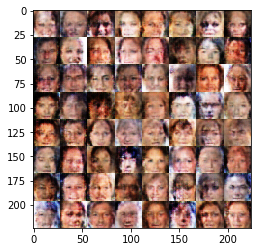

Epoch 1/1... Discriminator Loss: 0.9558... Generator Loss: 1.0838
Epoch 1/1... Discriminator Loss: 1.0517... Generator Loss: 0.9682
Epoch 1/1... Discriminator Loss: 1.0959... Generator Loss: 2.0239
Epoch 1/1... Discriminator Loss: 0.9408... Generator Loss: 0.8854
Epoch 1/1... Discriminator Loss: 0.8476... Generator Loss: 1.5928
Epoch 1/1... Discriminator Loss: 0.9174... Generator Loss: 1.2049
Epoch 1/1... Discriminator Loss: 1.0762... Generator Loss: 0.9183
Epoch 1/1... Discriminator Loss: 1.1532... Generator Loss: 1.0937
Epoch 1/1... Discriminator Loss: 1.0373... Generator Loss: 1.1209
Epoch 1/1... Discriminator Loss: 0.9600... Generator Loss: 1.1575


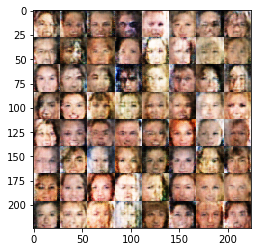

Epoch 1/1... Discriminator Loss: 1.0406... Generator Loss: 0.8341
Epoch 1/1... Discriminator Loss: 0.7954... Generator Loss: 1.7777
Epoch 1/1... Discriminator Loss: 0.9377... Generator Loss: 1.0035
Epoch 1/1... Discriminator Loss: 0.8945... Generator Loss: 2.1053
Epoch 1/1... Discriminator Loss: 0.8556... Generator Loss: 1.0740
Epoch 1/1... Discriminator Loss: 0.8695... Generator Loss: 1.2161
Epoch 1/1... Discriminator Loss: 0.8549... Generator Loss: 1.6262
Epoch 1/1... Discriminator Loss: 0.9187... Generator Loss: 1.1768
Epoch 1/1... Discriminator Loss: 1.0263... Generator Loss: 1.3285
Epoch 1/1... Discriminator Loss: 0.8637... Generator Loss: 1.5614


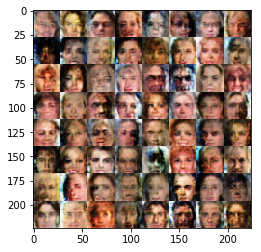

Epoch 1/1... Discriminator Loss: 1.0806... Generator Loss: 0.9086
Epoch 1/1... Discriminator Loss: 0.9409... Generator Loss: 1.7279
Epoch 1/1... Discriminator Loss: 1.0315... Generator Loss: 1.0962
Epoch 1/1... Discriminator Loss: 1.0110... Generator Loss: 1.4759
Epoch 1/1... Discriminator Loss: 0.9021... Generator Loss: 1.1011
Epoch 1/1... Discriminator Loss: 0.9352... Generator Loss: 1.5671
Epoch 1/1... Discriminator Loss: 1.0649... Generator Loss: 0.9513
Epoch 1/1... Discriminator Loss: 0.9316... Generator Loss: 1.2101
Epoch 1/1... Discriminator Loss: 0.8345... Generator Loss: 2.0742
Epoch 1/1... Discriminator Loss: 0.9372... Generator Loss: 1.0419


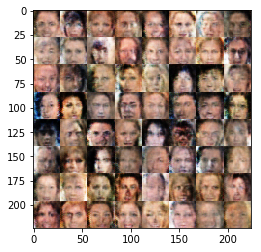

Epoch 1/1... Discriminator Loss: 0.8610... Generator Loss: 1.3736
Epoch 1/1... Discriminator Loss: 1.0024... Generator Loss: 1.1107
Epoch 1/1... Discriminator Loss: 1.0226... Generator Loss: 1.2230
Epoch 1/1... Discriminator Loss: 0.9435... Generator Loss: 1.1494
Epoch 1/1... Discriminator Loss: 0.8194... Generator Loss: 1.5412
Epoch 1/1... Discriminator Loss: 1.1771... Generator Loss: 0.7943
Epoch 1/1... Discriminator Loss: 0.8326... Generator Loss: 2.1670
Epoch 1/1... Discriminator Loss: 0.7510... Generator Loss: 1.3272
Epoch 1/1... Discriminator Loss: 0.7949... Generator Loss: 1.4422
Epoch 1/1... Discriminator Loss: 0.9506... Generator Loss: 1.8399


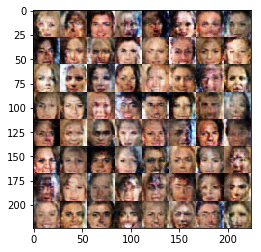

Epoch 1/1... Discriminator Loss: 1.1729... Generator Loss: 0.7808
Epoch 1/1... Discriminator Loss: 0.8540... Generator Loss: 1.8818
Epoch 1/1... Discriminator Loss: 1.1804... Generator Loss: 0.8938
Epoch 1/1... Discriminator Loss: 0.8823... Generator Loss: 1.2891
Epoch 1/1... Discriminator Loss: 0.9706... Generator Loss: 1.9679
Epoch 1/1... Discriminator Loss: 1.5920... Generator Loss: 0.5560
Epoch 1/1... Discriminator Loss: 1.0858... Generator Loss: 2.7303
Epoch 1/1... Discriminator Loss: 0.9859... Generator Loss: 1.0666
Epoch 1/1... Discriminator Loss: 1.1407... Generator Loss: 0.7975
Epoch 1/1... Discriminator Loss: 1.0621... Generator Loss: 2.0757


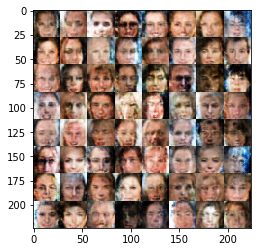

Epoch 1/1... Discriminator Loss: 0.9132... Generator Loss: 1.5047
Epoch 1/1... Discriminator Loss: 1.2021... Generator Loss: 0.8375
Epoch 1/1... Discriminator Loss: 0.9452... Generator Loss: 1.3910
Epoch 1/1... Discriminator Loss: 0.8968... Generator Loss: 1.3731
Epoch 1/1... Discriminator Loss: 1.0275... Generator Loss: 0.8686
Epoch 1/1... Discriminator Loss: 0.8633... Generator Loss: 1.8582
Epoch 1/1... Discriminator Loss: 0.9256... Generator Loss: 1.1665
Epoch 1/1... Discriminator Loss: 0.9847... Generator Loss: 1.0142
Epoch 1/1... Discriminator Loss: 0.9125... Generator Loss: 1.2636
Epoch 1/1... Discriminator Loss: 0.9107... Generator Loss: 1.3348


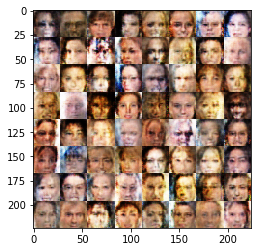

Epoch 1/1... Discriminator Loss: 1.0989... Generator Loss: 0.8799
Epoch 1/1... Discriminator Loss: 0.8356... Generator Loss: 1.5412
Epoch 1/1... Discriminator Loss: 0.8570... Generator Loss: 1.4228
Epoch 1/1... Discriminator Loss: 0.8982... Generator Loss: 1.3057
Epoch 1/1... Discriminator Loss: 0.8719... Generator Loss: 1.3782
Epoch 1/1... Discriminator Loss: 0.9309... Generator Loss: 1.1453
Epoch 1/1... Discriminator Loss: 0.9468... Generator Loss: 1.3325
Epoch 1/1... Discriminator Loss: 0.9223... Generator Loss: 1.2474
Epoch 1/1... Discriminator Loss: 0.8429... Generator Loss: 1.3124
Epoch 1/1... Discriminator Loss: 0.9642... Generator Loss: 1.0560


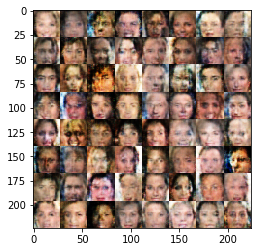

Epoch 1/1... Discriminator Loss: 0.8578... Generator Loss: 1.3896
Epoch 1/1... Discriminator Loss: 0.9186... Generator Loss: 1.1338
Epoch 1/1... Discriminator Loss: 0.8223... Generator Loss: 1.5543
Epoch 1/1... Discriminator Loss: 0.8282... Generator Loss: 1.4222
Epoch 1/1... Discriminator Loss: 0.8463... Generator Loss: 1.2200
Epoch 1/1... Discriminator Loss: 0.9753... Generator Loss: 1.4659
Epoch 1/1... Discriminator Loss: 0.8325... Generator Loss: 1.2734
Epoch 1/1... Discriminator Loss: 0.9166... Generator Loss: 1.3698
Epoch 1/1... Discriminator Loss: 0.8345... Generator Loss: 1.2097
Epoch 1/1... Discriminator Loss: 0.8575... Generator Loss: 1.4937


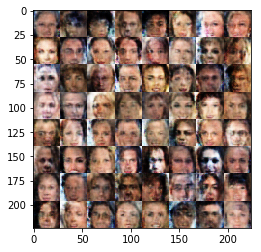

Epoch 1/1... Discriminator Loss: 0.8287... Generator Loss: 1.2502
Epoch 1/1... Discriminator Loss: 0.8507... Generator Loss: 1.4644
Epoch 1/1... Discriminator Loss: 0.9728... Generator Loss: 1.1898
Epoch 1/1... Discriminator Loss: 0.8835... Generator Loss: 1.3579
Epoch 1/1... Discriminator Loss: 0.7949... Generator Loss: 1.2469
Epoch 1/1... Discriminator Loss: 0.8068... Generator Loss: 1.2867
Epoch 1/1... Discriminator Loss: 0.8083... Generator Loss: 1.2930
Epoch 1/1... Discriminator Loss: 0.9202... Generator Loss: 1.0584
Epoch 1/1... Discriminator Loss: 0.8721... Generator Loss: 1.8412
Epoch 1/1... Discriminator Loss: 0.9892... Generator Loss: 0.9600


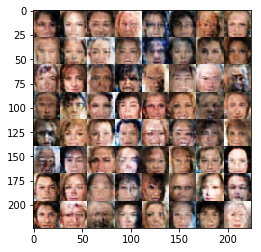

Epoch 1/1... Discriminator Loss: 0.8430... Generator Loss: 1.5905
Epoch 1/1... Discriminator Loss: 0.9228... Generator Loss: 1.1718
Epoch 1/1... Discriminator Loss: 0.7492... Generator Loss: 1.6634
Epoch 1/1... Discriminator Loss: 0.7477... Generator Loss: 1.3748
Epoch 1/1... Discriminator Loss: 0.8529... Generator Loss: 1.3533
Epoch 1/1... Discriminator Loss: 0.8373... Generator Loss: 1.2412
Epoch 1/1... Discriminator Loss: 0.9591... Generator Loss: 1.4079
Epoch 1/1... Discriminator Loss: 0.7303... Generator Loss: 1.5093
Epoch 1/1... Discriminator Loss: 0.8646... Generator Loss: 1.1666
Epoch 1/1... Discriminator Loss: 0.8606... Generator Loss: 1.7553


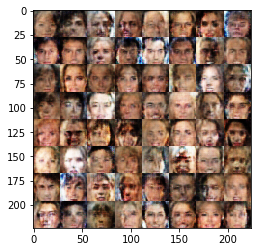

Epoch 1/1... Discriminator Loss: 0.8944... Generator Loss: 1.0403
Epoch 1/1... Discriminator Loss: 1.0343... Generator Loss: 1.2245
Epoch 1/1... Discriminator Loss: 1.0184... Generator Loss: 0.9195
Epoch 1/1... Discriminator Loss: 0.9627... Generator Loss: 1.3749
Epoch 1/1... Discriminator Loss: 1.0532... Generator Loss: 0.7742
Epoch 1/1... Discriminator Loss: 0.8931... Generator Loss: 2.2323
Epoch 1/1... Discriminator Loss: 0.9324... Generator Loss: 1.2291
Epoch 1/1... Discriminator Loss: 0.9243... Generator Loss: 1.0071
Epoch 1/1... Discriminator Loss: 1.0284... Generator Loss: 1.6920
Epoch 1/1... Discriminator Loss: 0.8465... Generator Loss: 1.3276


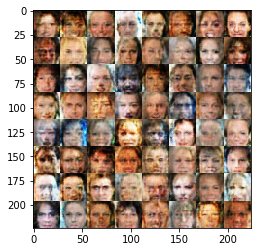

Epoch 1/1... Discriminator Loss: 1.0289... Generator Loss: 0.9590
Epoch 1/1... Discriminator Loss: 0.9285... Generator Loss: 1.3100
Epoch 1/1... Discriminator Loss: 0.9004... Generator Loss: 1.2176
Epoch 1/1... Discriminator Loss: 0.8301... Generator Loss: 1.3981
Epoch 1/1... Discriminator Loss: 0.8731... Generator Loss: 1.2258
Epoch 1/1... Discriminator Loss: 0.8527... Generator Loss: 1.2591
Epoch 1/1... Discriminator Loss: 0.8523... Generator Loss: 1.2039
Epoch 1/1... Discriminator Loss: 0.8168... Generator Loss: 1.2675
Epoch 1/1... Discriminator Loss: 0.8061... Generator Loss: 1.6688
Epoch 1/1... Discriminator Loss: 0.8564... Generator Loss: 1.1501


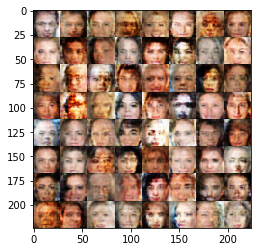

Epoch 1/1... Discriminator Loss: 0.9325... Generator Loss: 1.1489
Epoch 1/1... Discriminator Loss: 0.8479... Generator Loss: 1.4914
Epoch 1/1... Discriminator Loss: 0.7652... Generator Loss: 1.4853
Epoch 1/1... Discriminator Loss: 0.7748... Generator Loss: 1.3411
Epoch 1/1... Discriminator Loss: 0.8614... Generator Loss: 1.4199
Epoch 1/1... Discriminator Loss: 0.8638... Generator Loss: 1.2858
Epoch 1/1... Discriminator Loss: 0.8678... Generator Loss: 1.2424
Epoch 1/1... Discriminator Loss: 0.8723... Generator Loss: 1.3818
Epoch 1/1... Discriminator Loss: 0.8635... Generator Loss: 1.2468
Epoch 1/1... Discriminator Loss: 0.8391... Generator Loss: 1.2722


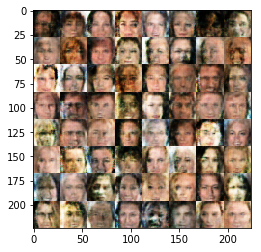

Epoch 1/1... Discriminator Loss: 0.9356... Generator Loss: 1.3401
Epoch 1/1... Discriminator Loss: 1.0079... Generator Loss: 0.8434
Epoch 1/1... Discriminator Loss: 1.0604... Generator Loss: 2.3372
Epoch 1/1... Discriminator Loss: 0.7085... Generator Loss: 1.4371
Epoch 1/1... Discriminator Loss: 0.9228... Generator Loss: 1.0066
Epoch 1/1... Discriminator Loss: 0.9996... Generator Loss: 1.7106
Epoch 1/1... Discriminator Loss: 0.7799... Generator Loss: 1.4158
Epoch 1/1... Discriminator Loss: 1.3209... Generator Loss: 0.7275
Epoch 1/1... Discriminator Loss: 1.0301... Generator Loss: 1.5442
Epoch 1/1... Discriminator Loss: 0.8039... Generator Loss: 1.9068


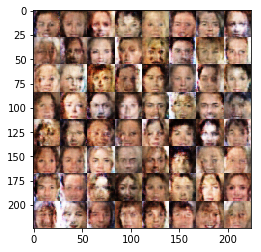

Epoch 1/1... Discriminator Loss: 1.4507... Generator Loss: 0.5714
Epoch 1/1... Discriminator Loss: 1.4314... Generator Loss: 1.6470
Epoch 1/1... Discriminator Loss: 1.2777... Generator Loss: 0.6856
Epoch 1/1... Discriminator Loss: 1.0475... Generator Loss: 1.6421
Epoch 1/1... Discriminator Loss: 0.8989... Generator Loss: 1.1594
Epoch 1/1... Discriminator Loss: 1.0348... Generator Loss: 0.8327
Epoch 1/1... Discriminator Loss: 1.0791... Generator Loss: 2.0296
Epoch 1/1... Discriminator Loss: 0.9550... Generator Loss: 0.9836
Epoch 1/1... Discriminator Loss: 0.9351... Generator Loss: 1.3164
Epoch 1/1... Discriminator Loss: 0.7647... Generator Loss: 1.6206


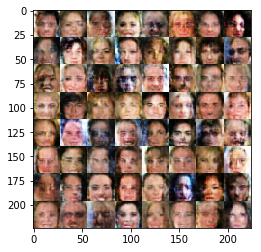

Epoch 1/1... Discriminator Loss: 0.8408... Generator Loss: 1.2110
Epoch 1/1... Discriminator Loss: 0.9067... Generator Loss: 1.3504
Epoch 1/1... Discriminator Loss: 0.9434... Generator Loss: 1.1037
Epoch 1/1... Discriminator Loss: 0.9484... Generator Loss: 1.1900
Epoch 1/1... Discriminator Loss: 1.0130... Generator Loss: 1.0458
Epoch 1/1... Discriminator Loss: 1.0457... Generator Loss: 1.0097
Epoch 1/1... Discriminator Loss: 0.8233... Generator Loss: 1.5269
Epoch 1/1... Discriminator Loss: 0.9867... Generator Loss: 0.9898
Epoch 1/1... Discriminator Loss: 0.8727... Generator Loss: 1.8660
Epoch 1/1... Discriminator Loss: 0.9436... Generator Loss: 1.0339


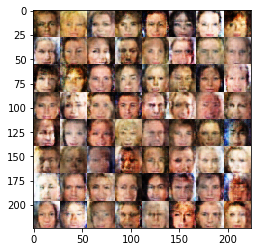

Epoch 1/1... Discriminator Loss: 0.9872... Generator Loss: 1.0001
Epoch 1/1... Discriminator Loss: 0.8969... Generator Loss: 1.5099
Epoch 1/1... Discriminator Loss: 1.1130... Generator Loss: 0.8566
Epoch 1/1... Discriminator Loss: 0.9030... Generator Loss: 1.4115
Epoch 1/1... Discriminator Loss: 0.8181... Generator Loss: 1.4623
Epoch 1/1... Discriminator Loss: 0.9810... Generator Loss: 1.0515
Epoch 1/1... Discriminator Loss: 0.9407... Generator Loss: 1.0352
Epoch 1/1... Discriminator Loss: 0.9276... Generator Loss: 1.5948
Epoch 1/1... Discriminator Loss: 0.9483... Generator Loss: 0.9895
Epoch 1/1... Discriminator Loss: 0.8921... Generator Loss: 1.2611


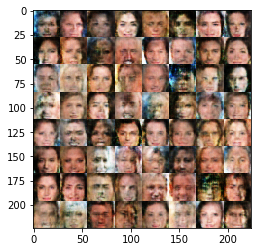

Epoch 1/1... Discriminator Loss: 0.8925... Generator Loss: 1.5220
Epoch 1/1... Discriminator Loss: 0.9476... Generator Loss: 1.1073
Epoch 1/1... Discriminator Loss: 0.7857... Generator Loss: 1.2579
Epoch 1/1... Discriminator Loss: 0.8510... Generator Loss: 1.3377
Epoch 1/1... Discriminator Loss: 1.0492... Generator Loss: 0.9372
Epoch 1/1... Discriminator Loss: 0.9830... Generator Loss: 1.3677
Epoch 1/1... Discriminator Loss: 0.9142... Generator Loss: 1.3105
Epoch 1/1... Discriminator Loss: 1.0149... Generator Loss: 0.9903
Epoch 1/1... Discriminator Loss: 1.0086... Generator Loss: 1.6339
Epoch 1/1... Discriminator Loss: 0.9227... Generator Loss: 1.2446


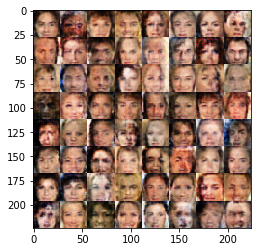

Epoch 1/1... Discriminator Loss: 1.0127... Generator Loss: 0.9274
Epoch 1/1... Discriminator Loss: 0.9986... Generator Loss: 1.6593
Epoch 1/1... Discriminator Loss: 1.0119... Generator Loss: 0.9636
Epoch 1/1... Discriminator Loss: 0.8521... Generator Loss: 1.7319
Epoch 1/1... Discriminator Loss: 0.8789... Generator Loss: 1.2202
Epoch 1/1... Discriminator Loss: 0.9591... Generator Loss: 1.3022
Epoch 1/1... Discriminator Loss: 0.6830... Generator Loss: 1.9303
Epoch 1/1... Discriminator Loss: 0.7747... Generator Loss: 1.0914
Epoch 1/1... Discriminator Loss: 0.9374... Generator Loss: 1.4609
Epoch 1/1... Discriminator Loss: 0.8983... Generator Loss: 1.0708


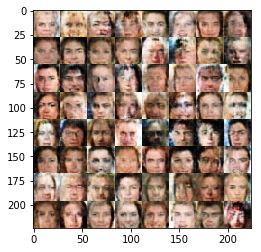

Epoch 1/1... Discriminator Loss: 1.3155... Generator Loss: 0.6032
Epoch 1/1... Discriminator Loss: 0.9208... Generator Loss: 2.0080
Epoch 1/1... Discriminator Loss: 1.0172... Generator Loss: 0.7970
Epoch 1/1... Discriminator Loss: 0.8935... Generator Loss: 0.9338
Epoch 1/1... Discriminator Loss: 1.2258... Generator Loss: 1.3759
Epoch 1/1... Discriminator Loss: 1.3960... Generator Loss: 0.6561
Epoch 1/1... Discriminator Loss: 0.9521... Generator Loss: 1.6463
Epoch 1/1... Discriminator Loss: 0.7886... Generator Loss: 1.4411
Epoch 1/1... Discriminator Loss: 0.9188... Generator Loss: 1.0612
Epoch 1/1... Discriminator Loss: 0.8955... Generator Loss: 1.6019


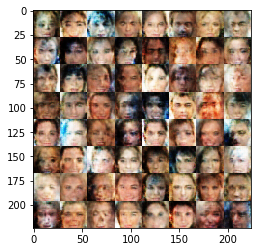

Epoch 1/1... Discriminator Loss: 0.9304... Generator Loss: 1.0945
Epoch 1/1... Discriminator Loss: 0.8561... Generator Loss: 1.2157
Epoch 1/1... Discriminator Loss: 0.9986... Generator Loss: 2.0261
Epoch 1/1... Discriminator Loss: 1.1471... Generator Loss: 0.8040
Epoch 1/1... Discriminator Loss: 0.8594... Generator Loss: 1.4693
Epoch 1/1... Discriminator Loss: 1.0762... Generator Loss: 1.3013
Epoch 1/1... Discriminator Loss: 0.8620... Generator Loss: 1.5044
Epoch 1/1... Discriminator Loss: 1.1478... Generator Loss: 0.8716
Epoch 1/1... Discriminator Loss: 1.0733... Generator Loss: 1.3272
Epoch 1/1... Discriminator Loss: 0.9187... Generator Loss: 1.2006


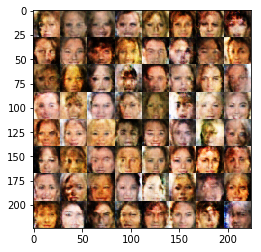

Epoch 1/1... Discriminator Loss: 0.8319... Generator Loss: 1.3100
Epoch 1/1... Discriminator Loss: 0.9353... Generator Loss: 1.4252
Epoch 1/1... Discriminator Loss: 0.9283... Generator Loss: 0.9864
Epoch 1/1... Discriminator Loss: 0.9786... Generator Loss: 1.2903
Epoch 1/1... Discriminator Loss: 0.7815... Generator Loss: 1.5104
Epoch 1/1... Discriminator Loss: 0.7405... Generator Loss: 1.4430
Epoch 1/1... Discriminator Loss: 0.9083... Generator Loss: 0.8705
Epoch 1/1... Discriminator Loss: 1.1238... Generator Loss: 1.9294
Epoch 1/1... Discriminator Loss: 1.1924... Generator Loss: 0.8269
Epoch 1/1... Discriminator Loss: 0.8746... Generator Loss: 1.6139


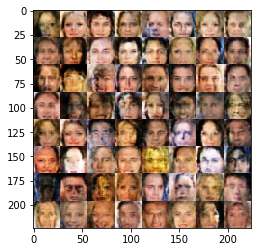

Epoch 1/1... Discriminator Loss: 0.9773... Generator Loss: 1.1571
Epoch 1/1... Discriminator Loss: 1.0141... Generator Loss: 1.1261
Epoch 1/1... Discriminator Loss: 1.0707... Generator Loss: 1.6740
Epoch 1/1... Discriminator Loss: 1.1384... Generator Loss: 0.7883
Epoch 1/1... Discriminator Loss: 1.2615... Generator Loss: 1.0537
Epoch 1/1... Discriminator Loss: 1.1366... Generator Loss: 1.0161
Epoch 1/1... Discriminator Loss: 0.8417... Generator Loss: 1.0899
Epoch 1/1... Discriminator Loss: 0.8380... Generator Loss: 1.7556
Epoch 1/1... Discriminator Loss: 0.8417... Generator Loss: 1.1837
Epoch 1/1... Discriminator Loss: 0.8874... Generator Loss: 1.4192


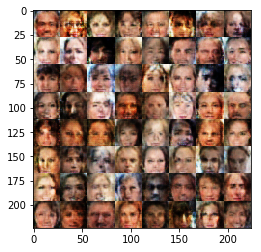

Epoch 1/1... Discriminator Loss: 1.0346... Generator Loss: 0.8216
Epoch 1/1... Discriminator Loss: 1.0230... Generator Loss: 1.7380
Epoch 1/1... Discriminator Loss: 0.8556... Generator Loss: 1.2373
Epoch 1/1... Discriminator Loss: 1.0119... Generator Loss: 1.2151
Epoch 1/1... Discriminator Loss: 1.0075... Generator Loss: 1.0156
Epoch 1/1... Discriminator Loss: 0.9963... Generator Loss: 1.2910
Epoch 1/1... Discriminator Loss: 0.9182... Generator Loss: 0.9302
Epoch 1/1... Discriminator Loss: 1.0035... Generator Loss: 1.6477
Epoch 1/1... Discriminator Loss: 0.7413... Generator Loss: 1.5542
Epoch 1/1... Discriminator Loss: 1.0872... Generator Loss: 0.8622


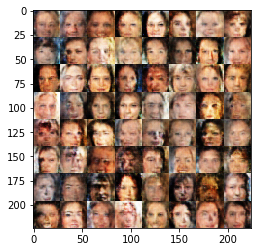

Epoch 1/1... Discriminator Loss: 0.9377... Generator Loss: 1.9263
Epoch 1/1... Discriminator Loss: 1.1282... Generator Loss: 0.7119
Epoch 1/1... Discriminator Loss: 0.9500... Generator Loss: 2.3324
Epoch 1/1... Discriminator Loss: 0.8820... Generator Loss: 0.9795
Epoch 1/1... Discriminator Loss: 1.0222... Generator Loss: 1.0736
Epoch 1/1... Discriminator Loss: 0.9156... Generator Loss: 1.3415
Epoch 1/1... Discriminator Loss: 0.8931... Generator Loss: 1.2847
Epoch 1/1... Discriminator Loss: 0.9394... Generator Loss: 0.9961
Epoch 1/1... Discriminator Loss: 0.9508... Generator Loss: 1.7622
Epoch 1/1... Discriminator Loss: 1.0482... Generator Loss: 0.8542


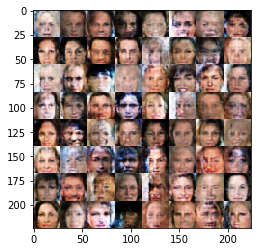

Epoch 1/1... Discriminator Loss: 0.7485... Generator Loss: 2.0362
Epoch 1/1... Discriminator Loss: 0.8229... Generator Loss: 1.2346
Epoch 1/1... Discriminator Loss: 0.8461... Generator Loss: 1.2826
Epoch 1/1... Discriminator Loss: 0.8840... Generator Loss: 1.8260
Epoch 1/1... Discriminator Loss: 0.8971... Generator Loss: 1.0688
Epoch 1/1... Discriminator Loss: 0.9175... Generator Loss: 1.1057
Epoch 1/1... Discriminator Loss: 0.8755... Generator Loss: 1.4966
Epoch 1/1... Discriminator Loss: 1.1544... Generator Loss: 0.8437
Epoch 1/1... Discriminator Loss: 1.0247... Generator Loss: 1.5947
Epoch 1/1... Discriminator Loss: 0.8605... Generator Loss: 1.1492


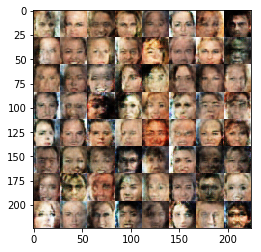

Epoch 1/1... Discriminator Loss: 0.9105... Generator Loss: 1.2098
Epoch 1/1... Discriminator Loss: 0.8400... Generator Loss: 1.6602
Epoch 1/1... Discriminator Loss: 0.8879... Generator Loss: 1.3251
Epoch 1/1... Discriminator Loss: 0.8789... Generator Loss: 1.1558
Epoch 1/1... Discriminator Loss: 0.9468... Generator Loss: 1.2608
Epoch 1/1... Discriminator Loss: 0.8071... Generator Loss: 1.4648
Epoch 1/1... Discriminator Loss: 0.9537... Generator Loss: 1.0522
Epoch 1/1... Discriminator Loss: 0.9291... Generator Loss: 1.8736
Epoch 1/1... Discriminator Loss: 0.8919... Generator Loss: 1.0092
Epoch 1/1... Discriminator Loss: 0.6501... Generator Loss: 1.9109


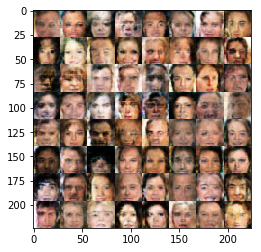

Epoch 1/1... Discriminator Loss: 0.8068... Generator Loss: 1.3527
Epoch 1/1... Discriminator Loss: 1.0038... Generator Loss: 0.9304
Epoch 1/1... Discriminator Loss: 1.0012... Generator Loss: 1.7886
Epoch 1/1... Discriminator Loss: 1.3651... Generator Loss: 0.6149
Epoch 1/1... Discriminator Loss: 1.1294... Generator Loss: 2.4076
Epoch 1/1... Discriminator Loss: 1.2314... Generator Loss: 0.7001
Epoch 1/1... Discriminator Loss: 1.0036... Generator Loss: 1.4509
Epoch 1/1... Discriminator Loss: 0.7820... Generator Loss: 1.8070
Epoch 1/1... Discriminator Loss: 1.6596... Generator Loss: 0.5588
Epoch 1/1... Discriminator Loss: 1.0654... Generator Loss: 1.7346


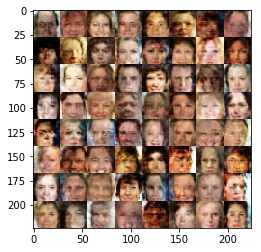

Epoch 1/1... Discriminator Loss: 0.9468... Generator Loss: 1.5984
Epoch 1/1... Discriminator Loss: 1.1546... Generator Loss: 0.7825
Epoch 1/1... Discriminator Loss: 0.8955... Generator Loss: 1.9747
Epoch 1/1... Discriminator Loss: 1.0613... Generator Loss: 0.9863
Epoch 1/1... Discriminator Loss: 0.9287... Generator Loss: 1.2490
Epoch 1/1... Discriminator Loss: 0.9737... Generator Loss: 1.6423
Epoch 1/1... Discriminator Loss: 1.3269... Generator Loss: 0.6843
Epoch 1/1... Discriminator Loss: 0.9707... Generator Loss: 1.0377
Epoch 1/1... Discriminator Loss: 0.9492... Generator Loss: 1.6867
Epoch 1/1... Discriminator Loss: 0.9142... Generator Loss: 1.0073


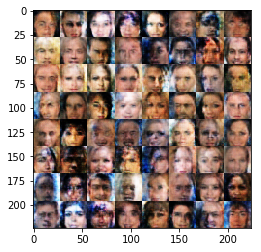

Epoch 1/1... Discriminator Loss: 0.8902... Generator Loss: 1.3750
Epoch 1/1... Discriminator Loss: 0.9315... Generator Loss: 1.1770
Epoch 1/1... Discriminator Loss: 0.9687... Generator Loss: 1.2772
Epoch 1/1... Discriminator Loss: 0.8469... Generator Loss: 1.3225
Epoch 1/1... Discriminator Loss: 0.8196... Generator Loss: 1.4208
Epoch 1/1... Discriminator Loss: 0.8648... Generator Loss: 1.7066
Epoch 1/1... Discriminator Loss: 1.1229... Generator Loss: 0.8454
Epoch 1/1... Discriminator Loss: 1.1119... Generator Loss: 1.8250
Epoch 1/1... Discriminator Loss: 0.9565... Generator Loss: 0.9898
Epoch 1/1... Discriminator Loss: 1.0536... Generator Loss: 1.0120


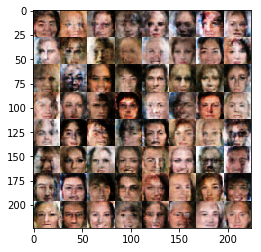

Epoch 1/1... Discriminator Loss: 0.8295... Generator Loss: 1.7381
Epoch 1/1... Discriminator Loss: 0.7864... Generator Loss: 1.4683
Epoch 1/1... Discriminator Loss: 1.2558... Generator Loss: 0.6926
Epoch 1/1... Discriminator Loss: 1.0108... Generator Loss: 1.8019
Epoch 1/1... Discriminator Loss: 0.8720... Generator Loss: 1.1587
Epoch 1/1... Discriminator Loss: 1.0398... Generator Loss: 0.9566
Epoch 1/1... Discriminator Loss: 1.0180... Generator Loss: 1.3763
Epoch 1/1... Discriminator Loss: 1.1455... Generator Loss: 0.9280
Epoch 1/1... Discriminator Loss: 1.2331... Generator Loss: 1.2826
Epoch 1/1... Discriminator Loss: 0.9035... Generator Loss: 1.0855


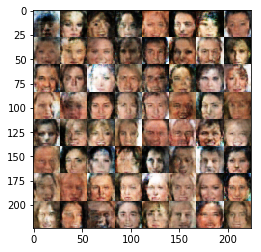

Epoch 1/1... Discriminator Loss: 0.9496... Generator Loss: 1.4168
Epoch 1/1... Discriminator Loss: 0.7665... Generator Loss: 1.3966
Epoch 1/1... Discriminator Loss: 1.0487... Generator Loss: 0.9649
Epoch 1/1... Discriminator Loss: 0.9551... Generator Loss: 1.0769
Epoch 1/1... Discriminator Loss: 1.0022... Generator Loss: 1.1152
Epoch 1/1... Discriminator Loss: 0.9737... Generator Loss: 1.1950
Epoch 1/1... Discriminator Loss: 0.8221... Generator Loss: 1.2181
Epoch 1/1... Discriminator Loss: 0.8370... Generator Loss: 1.1285
Epoch 1/1... Discriminator Loss: 0.8331... Generator Loss: 1.4781
Epoch 1/1... Discriminator Loss: 0.9565... Generator Loss: 0.9357


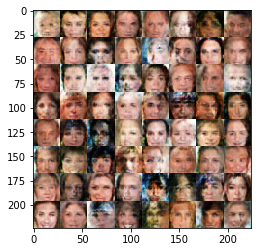

Epoch 1/1... Discriminator Loss: 0.9817... Generator Loss: 1.3825
Epoch 1/1... Discriminator Loss: 0.9209... Generator Loss: 1.4708
Epoch 1/1... Discriminator Loss: 0.9138... Generator Loss: 1.0335
Epoch 1/1... Discriminator Loss: 0.9443... Generator Loss: 1.0718
Epoch 1/1... Discriminator Loss: 0.9268... Generator Loss: 1.4979
Epoch 1/1... Discriminator Loss: 0.9606... Generator Loss: 0.9647
Epoch 1/1... Discriminator Loss: 0.9249... Generator Loss: 1.1927
Epoch 1/1... Discriminator Loss: 0.8784... Generator Loss: 1.4183
Epoch 1/1... Discriminator Loss: 0.9150... Generator Loss: 1.1750
Epoch 1/1... Discriminator Loss: 0.8448... Generator Loss: 1.2325


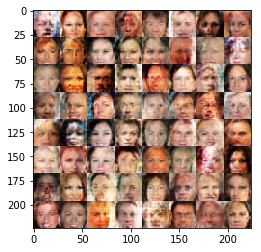

Epoch 1/1... Discriminator Loss: 0.8869... Generator Loss: 1.1968
Epoch 1/1... Discriminator Loss: 0.8608... Generator Loss: 1.2815
Epoch 1/1... Discriminator Loss: 0.7495... Generator Loss: 1.8398
Epoch 1/1... Discriminator Loss: 0.8685... Generator Loss: 1.0957
Epoch 1/1... Discriminator Loss: 1.1298... Generator Loss: 1.4671
Epoch 1/1... Discriminator Loss: 1.0676... Generator Loss: 0.9836
Epoch 1/1... Discriminator Loss: 0.9517... Generator Loss: 0.8799
Epoch 1/1... Discriminator Loss: 1.1399... Generator Loss: 1.9596
Epoch 1/1... Discriminator Loss: 0.9327... Generator Loss: 1.1678
Epoch 1/1... Discriminator Loss: 1.0407... Generator Loss: 0.9515


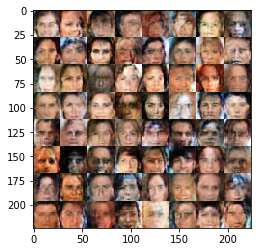

Epoch 1/1... Discriminator Loss: 0.9600... Generator Loss: 1.3448
Epoch 1/1... Discriminator Loss: 0.7898... Generator Loss: 1.4663
Epoch 1/1... Discriminator Loss: 1.0795... Generator Loss: 0.9110
Epoch 1/1... Discriminator Loss: 0.8867... Generator Loss: 1.2720
Epoch 1/1... Discriminator Loss: 0.8177... Generator Loss: 1.3834
Epoch 1/1... Discriminator Loss: 0.8508... Generator Loss: 1.2809
Epoch 1/1... Discriminator Loss: 0.7199... Generator Loss: 1.6412
Epoch 1/1... Discriminator Loss: 0.9759... Generator Loss: 0.8842
Epoch 1/1... Discriminator Loss: 0.7743... Generator Loss: 1.6916
Epoch 1/1... Discriminator Loss: 0.8291... Generator Loss: 1.1757


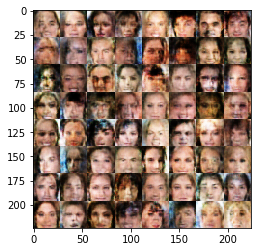

Epoch 1/1... Discriminator Loss: 0.9000... Generator Loss: 1.1512
Epoch 1/1... Discriminator Loss: 0.8565... Generator Loss: 1.4247
Epoch 1/1... Discriminator Loss: 0.9188... Generator Loss: 1.0216
Epoch 1/1... Discriminator Loss: 0.8439... Generator Loss: 1.5008
Epoch 1/1... Discriminator Loss: 0.9347... Generator Loss: 1.0855
Epoch 1/1... Discriminator Loss: 0.8903... Generator Loss: 1.4176
Epoch 1/1... Discriminator Loss: 0.9270... Generator Loss: 1.0292
Epoch 1/1... Discriminator Loss: 0.8874... Generator Loss: 1.3294
Epoch 1/1... Discriminator Loss: 0.8190... Generator Loss: 1.7115
Epoch 1/1... Discriminator Loss: 1.1079... Generator Loss: 0.8189


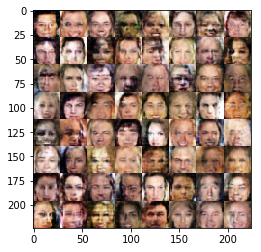

Epoch 1/1... Discriminator Loss: 0.8713... Generator Loss: 1.5669
Epoch 1/1... Discriminator Loss: 0.9571... Generator Loss: 1.0336
Epoch 1/1... Discriminator Loss: 0.8547... Generator Loss: 1.6935
Epoch 1/1... Discriminator Loss: 0.8976... Generator Loss: 1.0062
Epoch 1/1... Discriminator Loss: 0.9011... Generator Loss: 1.3180
Epoch 1/1... Discriminator Loss: 1.0172... Generator Loss: 1.1874
Epoch 1/1... Discriminator Loss: 0.9238... Generator Loss: 1.2869
Epoch 1/1... Discriminator Loss: 1.5591... Generator Loss: 0.5524
Epoch 1/1... Discriminator Loss: 1.0868... Generator Loss: 1.9148
Epoch 1/1... Discriminator Loss: 0.8201... Generator Loss: 1.3266


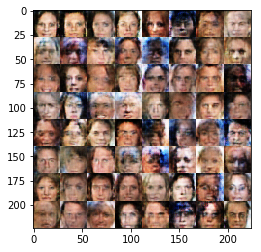

Epoch 1/1... Discriminator Loss: 1.3226... Generator Loss: 0.7769
Epoch 1/1... Discriminator Loss: 1.1067... Generator Loss: 1.2272
Epoch 1/1... Discriminator Loss: 1.0762... Generator Loss: 1.1828
Epoch 1/1... Discriminator Loss: 1.1249... Generator Loss: 0.8343
Epoch 1/1... Discriminator Loss: 0.7880... Generator Loss: 2.0967
Epoch 1/1... Discriminator Loss: 1.0826... Generator Loss: 0.9739
Epoch 1/1... Discriminator Loss: 1.0585... Generator Loss: 1.0086
Epoch 1/1... Discriminator Loss: 0.9177... Generator Loss: 1.8945
Epoch 1/1... Discriminator Loss: 1.1232... Generator Loss: 0.7798
Epoch 1/1... Discriminator Loss: 0.8394... Generator Loss: 1.5327


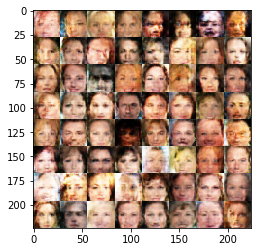

Epoch 1/1... Discriminator Loss: 0.8128... Generator Loss: 1.2226
Epoch 1/1... Discriminator Loss: 0.9322... Generator Loss: 1.2921
Epoch 1/1... Discriminator Loss: 0.9191... Generator Loss: 1.3003
Epoch 1/1... Discriminator Loss: 0.9427... Generator Loss: 0.9457
Epoch 1/1... Discriminator Loss: 0.8930... Generator Loss: 1.4287
Epoch 1/1... Discriminator Loss: 1.0172... Generator Loss: 1.0438
Epoch 1/1... Discriminator Loss: 1.0173... Generator Loss: 1.1472
Epoch 1/1... Discriminator Loss: 0.9409... Generator Loss: 1.1245
Epoch 1/1... Discriminator Loss: 0.7499... Generator Loss: 1.3904
Epoch 1/1... Discriminator Loss: 0.8740... Generator Loss: 1.2058


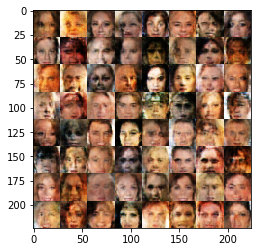

Epoch 1/1... Discriminator Loss: 0.9257... Generator Loss: 1.3892
Epoch 1/1... Discriminator Loss: 0.8636... Generator Loss: 1.1760
Epoch 1/1... Discriminator Loss: 0.8905... Generator Loss: 1.3754
Epoch 1/1... Discriminator Loss: 0.8180... Generator Loss: 1.3870
Epoch 1/1... Discriminator Loss: 0.7922... Generator Loss: 1.2792
Epoch 1/1... Discriminator Loss: 0.7177... Generator Loss: 1.6383
Epoch 1/1... Discriminator Loss: 0.8937... Generator Loss: 1.0297
Epoch 1/1... Discriminator Loss: 0.8656... Generator Loss: 1.8352
Epoch 1/1... Discriminator Loss: 0.9625... Generator Loss: 1.0005
Epoch 1/1... Discriminator Loss: 0.8746... Generator Loss: 1.1474


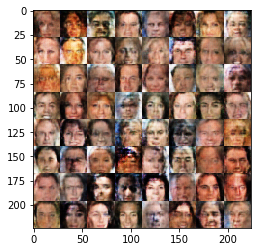

Epoch 1/1... Discriminator Loss: 0.9439... Generator Loss: 1.4787
Epoch 1/1... Discriminator Loss: 1.0559... Generator Loss: 1.0567
Epoch 1/1... Discriminator Loss: 1.1443... Generator Loss: 0.7629
Epoch 1/1... Discriminator Loss: 0.9726... Generator Loss: 1.5556
Epoch 1/1... Discriminator Loss: 1.0004... Generator Loss: 1.0004
Epoch 1/1... Discriminator Loss: 1.0746... Generator Loss: 0.8389
Epoch 1/1... Discriminator Loss: 0.9929... Generator Loss: 1.2749
Epoch 1/1... Discriminator Loss: 0.8776... Generator Loss: 1.3024
Epoch 1/1... Discriminator Loss: 0.8647... Generator Loss: 1.0731
Epoch 1/1... Discriminator Loss: 0.9858... Generator Loss: 1.1149


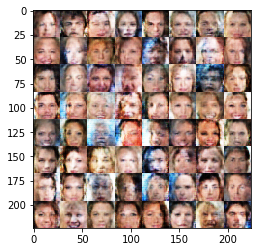

Epoch 1/1... Discriminator Loss: 0.9976... Generator Loss: 2.2674
Epoch 1/1... Discriminator Loss: 1.2735... Generator Loss: 0.7149
Epoch 1/1... Discriminator Loss: 0.9674... Generator Loss: 1.7109
Epoch 1/1... Discriminator Loss: 0.9144... Generator Loss: 1.2315
Epoch 1/1... Discriminator Loss: 1.0329... Generator Loss: 1.0219
Epoch 1/1... Discriminator Loss: 1.1160... Generator Loss: 1.2488
Epoch 1/1... Discriminator Loss: 1.0503... Generator Loss: 1.1989
Epoch 1/1... Discriminator Loss: 1.0291... Generator Loss: 1.0371
Epoch 1/1... Discriminator Loss: 0.9851... Generator Loss: 1.2570
Epoch 1/1... Discriminator Loss: 0.9338... Generator Loss: 1.2564


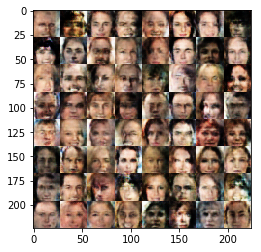

Epoch 1/1... Discriminator Loss: 0.8936... Generator Loss: 1.5326
Epoch 1/1... Discriminator Loss: 0.9839... Generator Loss: 0.9086
Epoch 1/1... Discriminator Loss: 0.8977... Generator Loss: 1.6451
Epoch 1/1... Discriminator Loss: 1.0398... Generator Loss: 0.9376
Epoch 1/1... Discriminator Loss: 0.9044... Generator Loss: 1.6396
Epoch 1/1... Discriminator Loss: 0.8425... Generator Loss: 1.2188
Epoch 1/1... Discriminator Loss: 0.8485... Generator Loss: 1.4992
Epoch 1/1... Discriminator Loss: 0.9569... Generator Loss: 1.0350
Epoch 1/1... Discriminator Loss: 0.9042... Generator Loss: 1.4911
Epoch 1/1... Discriminator Loss: 0.7492... Generator Loss: 1.7805


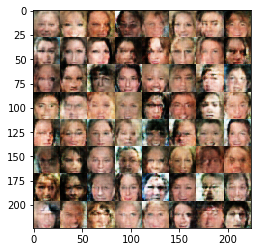

Epoch 1/1... Discriminator Loss: 1.2185... Generator Loss: 0.7248
Epoch 1/1... Discriminator Loss: 1.1278... Generator Loss: 2.0823
Epoch 1/1... Discriminator Loss: 1.1079... Generator Loss: 0.8978
Epoch 1/1... Discriminator Loss: 0.7867... Generator Loss: 1.9248
Epoch 1/1... Discriminator Loss: 0.7588... Generator Loss: 1.6223
Epoch 1/1... Discriminator Loss: 0.9140... Generator Loss: 1.1461
Epoch 1/1... Discriminator Loss: 1.3537... Generator Loss: 0.6994
Epoch 1/1... Discriminator Loss: 1.0134... Generator Loss: 1.7909
Epoch 1/1... Discriminator Loss: 1.0438... Generator Loss: 1.0193
Epoch 1/1... Discriminator Loss: 1.1168... Generator Loss: 0.9149


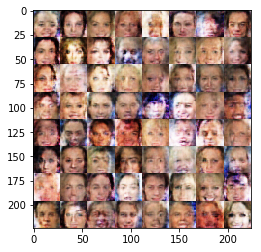

Epoch 1/1... Discriminator Loss: 1.0824... Generator Loss: 1.8577
Epoch 1/1... Discriminator Loss: 0.8908... Generator Loss: 1.2139
Epoch 1/1... Discriminator Loss: 0.8821... Generator Loss: 1.3381
Epoch 1/1... Discriminator Loss: 1.0872... Generator Loss: 0.9199
Epoch 1/1... Discriminator Loss: 0.8174... Generator Loss: 2.0302
Epoch 1/1... Discriminator Loss: 0.9588... Generator Loss: 0.9582
Epoch 1/1... Discriminator Loss: 0.8752... Generator Loss: 1.0177
Epoch 1/1... Discriminator Loss: 1.0404... Generator Loss: 1.7515
Epoch 1/1... Discriminator Loss: 0.9602... Generator Loss: 1.0572
Epoch 1/1... Discriminator Loss: 0.8800... Generator Loss: 1.1340


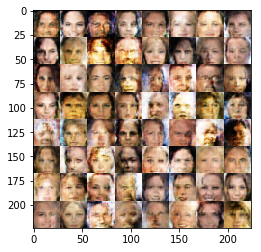

Epoch 1/1... Discriminator Loss: 0.9345... Generator Loss: 1.2867
Epoch 1/1... Discriminator Loss: 0.9359... Generator Loss: 1.0578
Epoch 1/1... Discriminator Loss: 0.9609... Generator Loss: 1.2484
Epoch 1/1... Discriminator Loss: 1.0525... Generator Loss: 1.3272
Epoch 1/1... Discriminator Loss: 1.0308... Generator Loss: 1.1497
Epoch 1/1... Discriminator Loss: 0.7214... Generator Loss: 1.6025
Epoch 1/1... Discriminator Loss: 0.7823... Generator Loss: 1.5176
Epoch 1/1... Discriminator Loss: 1.1173... Generator Loss: 0.8556
Epoch 1/1... Discriminator Loss: 1.0355... Generator Loss: 1.5552
Epoch 1/1... Discriminator Loss: 1.0125... Generator Loss: 1.0169


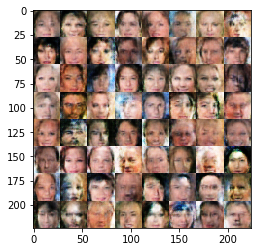

Epoch 1/1... Discriminator Loss: 0.9148... Generator Loss: 1.1484
Epoch 1/1... Discriminator Loss: 1.1284... Generator Loss: 1.0114
Epoch 1/1... Discriminator Loss: 0.9093... Generator Loss: 1.3833
Epoch 1/1... Discriminator Loss: 1.0392... Generator Loss: 0.7962
Epoch 1/1... Discriminator Loss: 0.9003... Generator Loss: 1.5315
Epoch 1/1... Discriminator Loss: 0.9572... Generator Loss: 1.2763
Epoch 1/1... Discriminator Loss: 0.9622... Generator Loss: 0.9411
Epoch 1/1... Discriminator Loss: 0.8230... Generator Loss: 1.2220
Epoch 1/1... Discriminator Loss: 1.1253... Generator Loss: 0.9125
Epoch 1/1... Discriminator Loss: 0.8692... Generator Loss: 1.4860


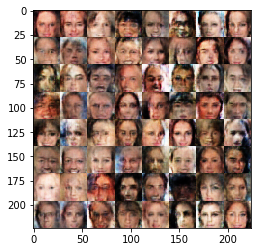

Epoch 1/1... Discriminator Loss: 0.8557... Generator Loss: 1.3238
Epoch 1/1... Discriminator Loss: 0.9393... Generator Loss: 1.2047
Epoch 1/1... Discriminator Loss: 0.7828... Generator Loss: 1.8587
Epoch 1/1... Discriminator Loss: 1.1821... Generator Loss: 0.7939
Epoch 1/1... Discriminator Loss: 0.9640... Generator Loss: 1.6701
Epoch 1/1... Discriminator Loss: 0.8907... Generator Loss: 1.2934
Epoch 1/1... Discriminator Loss: 0.9528... Generator Loss: 0.9883
Epoch 1/1... Discriminator Loss: 0.9018... Generator Loss: 1.6346
Epoch 1/1... Discriminator Loss: 1.0926... Generator Loss: 0.8639
Epoch 1/1... Discriminator Loss: 0.7933... Generator Loss: 1.8517


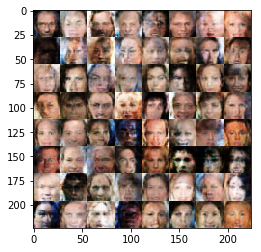

Epoch 1/1... Discriminator Loss: 0.9387... Generator Loss: 1.0757
Epoch 1/1... Discriminator Loss: 0.8444... Generator Loss: 1.5608
Epoch 1/1... Discriminator Loss: 0.9288... Generator Loss: 1.0328
Epoch 1/1... Discriminator Loss: 0.9023... Generator Loss: 1.4189
Epoch 1/1... Discriminator Loss: 0.8023... Generator Loss: 1.7822
Epoch 1/1... Discriminator Loss: 1.1548... Generator Loss: 0.7962
Epoch 1/1... Discriminator Loss: 0.9893... Generator Loss: 1.3356
Epoch 1/1... Discriminator Loss: 1.1533... Generator Loss: 0.8209
Epoch 1/1... Discriminator Loss: 1.1225... Generator Loss: 1.8475
Epoch 1/1... Discriminator Loss: 1.3807... Generator Loss: 0.6260


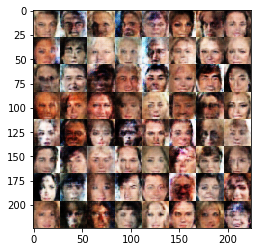

Epoch 1/1... Discriminator Loss: 1.1091... Generator Loss: 2.1891
Epoch 1/1... Discriminator Loss: 0.8759... Generator Loss: 1.3157
Epoch 1/1... Discriminator Loss: 1.2222... Generator Loss: 0.7559
Epoch 1/1... Discriminator Loss: 1.1736... Generator Loss: 2.4444
Epoch 1/1... Discriminator Loss: 0.8693... Generator Loss: 1.1322
Epoch 1/1... Discriminator Loss: 0.9149... Generator Loss: 1.1442
Epoch 1/1... Discriminator Loss: 0.7931... Generator Loss: 1.5553
Epoch 1/1... Discriminator Loss: 0.7273... Generator Loss: 1.2454
Epoch 1/1... Discriminator Loss: 0.9370... Generator Loss: 1.1688
Epoch 1/1... Discriminator Loss: 1.0392... Generator Loss: 0.8872


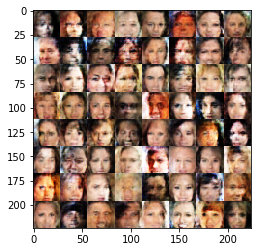

Epoch 1/1... Discriminator Loss: 0.9789... Generator Loss: 1.3849
Epoch 1/1... Discriminator Loss: 1.0741... Generator Loss: 0.9485
Epoch 1/1... Discriminator Loss: 1.1922... Generator Loss: 0.7365
Epoch 1/1... Discriminator Loss: 1.1973... Generator Loss: 0.9040
Epoch 1/1... Discriminator Loss: 1.0642... Generator Loss: 2.2426
Epoch 1/1... Discriminator Loss: 1.0720... Generator Loss: 0.7384
Epoch 1/1... Discriminator Loss: 0.8663... Generator Loss: 1.4465
Epoch 1/1... Discriminator Loss: 0.9429... Generator Loss: 1.4463
Epoch 1/1... Discriminator Loss: 1.0569... Generator Loss: 0.8253
Epoch 1/1... Discriminator Loss: 0.8705... Generator Loss: 1.4840


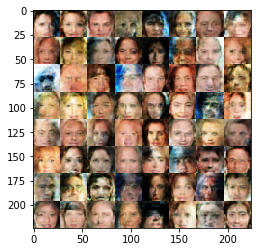

Epoch 1/1... Discriminator Loss: 0.9223... Generator Loss: 1.6751
Epoch 1/1... Discriminator Loss: 0.9328... Generator Loss: 0.9660
Epoch 1/1... Discriminator Loss: 0.9562... Generator Loss: 1.4198
Epoch 1/1... Discriminator Loss: 0.8953... Generator Loss: 1.3746
Epoch 1/1... Discriminator Loss: 1.1451... Generator Loss: 0.6683
Epoch 1/1... Discriminator Loss: 0.9252... Generator Loss: 2.1138
Epoch 1/1... Discriminator Loss: 1.0114... Generator Loss: 0.9200
Epoch 1/1... Discriminator Loss: 0.8686... Generator Loss: 1.2658
Epoch 1/1... Discriminator Loss: 0.8378... Generator Loss: 1.2989
Epoch 1/1... Discriminator Loss: 0.8563... Generator Loss: 1.3365


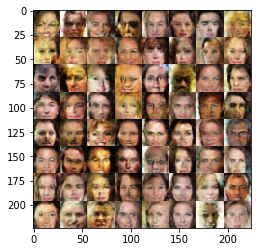

Epoch 1/1... Discriminator Loss: 0.8756... Generator Loss: 1.3012
Epoch 1/1... Discriminator Loss: 1.0043... Generator Loss: 1.0909
Epoch 1/1... Discriminator Loss: 0.8871... Generator Loss: 1.6941
Epoch 1/1... Discriminator Loss: 1.0647... Generator Loss: 0.9468
Epoch 1/1... Discriminator Loss: 0.8990... Generator Loss: 1.3114
Epoch 1/1... Discriminator Loss: 0.7510... Generator Loss: 1.5588
Epoch 1/1... Discriminator Loss: 0.7593... Generator Loss: 1.3322
Epoch 1/1... Discriminator Loss: 0.8244... Generator Loss: 1.2668
Epoch 1/1... Discriminator Loss: 0.9539... Generator Loss: 1.0566
Epoch 1/1... Discriminator Loss: 0.8585... Generator Loss: 1.6148


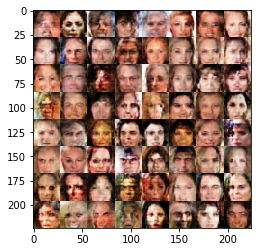

Epoch 1/1... Discriminator Loss: 0.8205... Generator Loss: 1.1898
Epoch 1/1... Discriminator Loss: 0.8821... Generator Loss: 1.2179
Epoch 1/1... Discriminator Loss: 0.9877... Generator Loss: 1.1740
Epoch 1/1... Discriminator Loss: 0.9887... Generator Loss: 1.0903
Epoch 1/1... Discriminator Loss: 0.8448... Generator Loss: 1.3080
Epoch 1/1... Discriminator Loss: 0.8217... Generator Loss: 1.2033
Epoch 1/1... Discriminator Loss: 0.8945... Generator Loss: 1.1534
Epoch 1/1... Discriminator Loss: 0.9712... Generator Loss: 1.8310
Epoch 1/1... Discriminator Loss: 1.3392... Generator Loss: 0.6863
Epoch 1/1... Discriminator Loss: 0.9366... Generator Loss: 1.2343


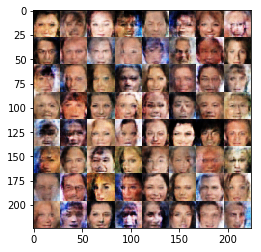

Epoch 1/1... Discriminator Loss: 1.0563... Generator Loss: 1.1708
Epoch 1/1... Discriminator Loss: 1.0071... Generator Loss: 0.9202
Epoch 1/1... Discriminator Loss: 0.8464... Generator Loss: 1.4528
Epoch 1/1... Discriminator Loss: 0.7841... Generator Loss: 1.5271
Epoch 1/1... Discriminator Loss: 1.0287... Generator Loss: 0.7206
Epoch 1/1... Discriminator Loss: 0.9201... Generator Loss: 1.7491
Epoch 1/1... Discriminator Loss: 0.7194... Generator Loss: 1.8023
Epoch 1/1... Discriminator Loss: 1.0221... Generator Loss: 0.8608
Epoch 1/1... Discriminator Loss: 0.8250... Generator Loss: 1.3210
Epoch 1/1... Discriminator Loss: 0.9302... Generator Loss: 1.1397


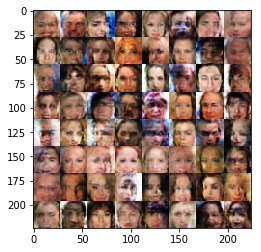

Epoch 1/1... Discriminator Loss: 1.0495... Generator Loss: 1.0179
Epoch 1/1... Discriminator Loss: 1.0135... Generator Loss: 1.4536
Epoch 1/1... Discriminator Loss: 0.8946... Generator Loss: 1.1644
Epoch 1/1... Discriminator Loss: 0.8423... Generator Loss: 1.6243
Epoch 1/1... Discriminator Loss: 0.9285... Generator Loss: 1.0657
Epoch 1/1... Discriminator Loss: 0.9518... Generator Loss: 1.1171
Epoch 1/1... Discriminator Loss: 1.0695... Generator Loss: 1.6615
Epoch 1/1... Discriminator Loss: 0.8430... Generator Loss: 1.4210
Epoch 1/1... Discriminator Loss: 1.0626... Generator Loss: 0.7798
Epoch 1/1... Discriminator Loss: 1.0058... Generator Loss: 1.7620


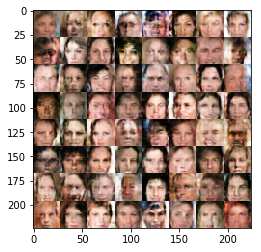

Epoch 1/1... Discriminator Loss: 0.9659... Generator Loss: 1.2285
Epoch 1/1... Discriminator Loss: 0.9874... Generator Loss: 0.8683
Epoch 1/1... Discriminator Loss: 0.8689... Generator Loss: 1.6918
Epoch 1/1... Discriminator Loss: 0.8173... Generator Loss: 1.6250
Epoch 1/1... Discriminator Loss: 0.9858... Generator Loss: 0.8077
Epoch 1/1... Discriminator Loss: 1.0678... Generator Loss: 1.5838
Epoch 1/1... Discriminator Loss: 0.8471... Generator Loss: 1.4600
Epoch 1/1... Discriminator Loss: 0.8325... Generator Loss: 1.2599
Epoch 1/1... Discriminator Loss: 1.0049... Generator Loss: 1.0836
Epoch 1/1... Discriminator Loss: 0.8553... Generator Loss: 1.1750


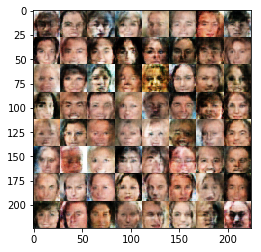

Epoch 1/1... Discriminator Loss: 0.9329... Generator Loss: 1.4828
Epoch 1/1... Discriminator Loss: 0.9785... Generator Loss: 1.0480
Epoch 1/1... Discriminator Loss: 0.9101... Generator Loss: 1.1186
Epoch 1/1... Discriminator Loss: 0.8951... Generator Loss: 1.3461
Epoch 1/1... Discriminator Loss: 0.8228... Generator Loss: 1.2636
Epoch 1/1... Discriminator Loss: 0.8183... Generator Loss: 1.3891
Epoch 1/1... Discriminator Loss: 0.7832... Generator Loss: 1.2713
Epoch 1/1... Discriminator Loss: 0.9253... Generator Loss: 1.3816
Epoch 1/1... Discriminator Loss: 0.9306... Generator Loss: 1.0682
Epoch 1/1... Discriminator Loss: 1.0578... Generator Loss: 1.8617


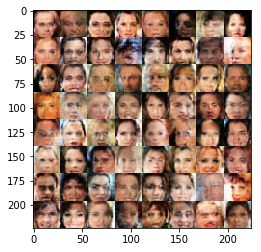

Epoch 1/1... Discriminator Loss: 1.0023... Generator Loss: 1.0637
Epoch 1/1... Discriminator Loss: 0.8345... Generator Loss: 1.2968
Epoch 1/1... Discriminator Loss: 0.9340... Generator Loss: 1.2528
Epoch 1/1... Discriminator Loss: 1.0100... Generator Loss: 0.8346
Epoch 1/1... Discriminator Loss: 0.9130... Generator Loss: 1.3328
Epoch 1/1... Discriminator Loss: 0.8404... Generator Loss: 1.2931
Epoch 1/1... Discriminator Loss: 0.8096... Generator Loss: 1.3164
Epoch 1/1... Discriminator Loss: 1.0160... Generator Loss: 1.0958
Epoch 1/1... Discriminator Loss: 0.9505... Generator Loss: 1.7225
Epoch 1/1... Discriminator Loss: 1.0514... Generator Loss: 0.8725


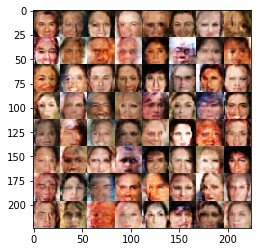

Epoch 1/1... Discriminator Loss: 0.9749... Generator Loss: 1.4075
Epoch 1/1... Discriminator Loss: 0.9616... Generator Loss: 0.9326
Epoch 1/1... Discriminator Loss: 0.8084... Generator Loss: 1.7320
Epoch 1/1... Discriminator Loss: 0.8073... Generator Loss: 1.3253
Epoch 1/1... Discriminator Loss: 1.1385... Generator Loss: 0.9061
Epoch 1/1... Discriminator Loss: 0.8776... Generator Loss: 1.8303
Epoch 1/1... Discriminator Loss: 0.8934... Generator Loss: 1.1023
Epoch 1/1... Discriminator Loss: 0.8407... Generator Loss: 1.6912
Epoch 1/1... Discriminator Loss: 0.7422... Generator Loss: 1.3506
Epoch 1/1... Discriminator Loss: 0.8760... Generator Loss: 1.1716


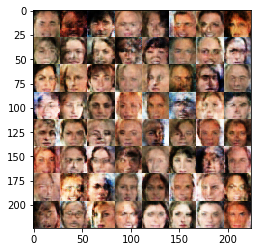

Epoch 1/1... Discriminator Loss: 0.8511... Generator Loss: 1.5121
Epoch 1/1... Discriminator Loss: 0.9836... Generator Loss: 1.0641
Epoch 1/1... Discriminator Loss: 0.9238... Generator Loss: 1.0201
Epoch 1/1... Discriminator Loss: 1.0570... Generator Loss: 0.9132
Epoch 1/1... Discriminator Loss: 0.9354... Generator Loss: 1.4069
Epoch 1/1... Discriminator Loss: 0.8117... Generator Loss: 1.1876
Epoch 1/1... Discriminator Loss: 0.7887... Generator Loss: 1.4149
Epoch 1/1... Discriminator Loss: 0.8624... Generator Loss: 1.4273
Epoch 1/1... Discriminator Loss: 0.8610... Generator Loss: 1.0615
Epoch 1/1... Discriminator Loss: 0.7978... Generator Loss: 1.6475


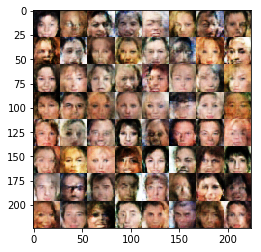

Epoch 1/1... Discriminator Loss: 0.9505... Generator Loss: 1.2938
Epoch 1/1... Discriminator Loss: 0.7994... Generator Loss: 1.5459
Epoch 1/1... Discriminator Loss: 0.9924... Generator Loss: 0.9873
Epoch 1/1... Discriminator Loss: 0.9328... Generator Loss: 1.4685
Epoch 1/1... Discriminator Loss: 0.8419... Generator Loss: 1.3621
Epoch 1/1... Discriminator Loss: 0.8946... Generator Loss: 1.2092
Epoch 1/1... Discriminator Loss: 0.9216... Generator Loss: 1.8054
Epoch 1/1... Discriminator Loss: 0.8397... Generator Loss: 1.1738
Epoch 1/1... Discriminator Loss: 0.9298... Generator Loss: 0.9957
Epoch 1/1... Discriminator Loss: 0.9863... Generator Loss: 1.6314


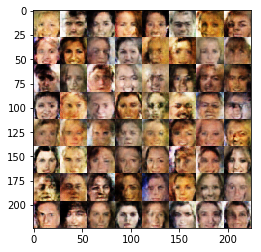

Epoch 1/1... Discriminator Loss: 0.9801... Generator Loss: 1.0420
Epoch 1/1... Discriminator Loss: 0.8628... Generator Loss: 1.4792
Epoch 1/1... Discriminator Loss: 0.7756... Generator Loss: 1.7262
Epoch 1/1... Discriminator Loss: 1.0261... Generator Loss: 0.9237
Epoch 1/1... Discriminator Loss: 0.8394... Generator Loss: 1.6632
Epoch 1/1... Discriminator Loss: 0.8579... Generator Loss: 1.1817
Epoch 1/1... Discriminator Loss: 0.8352... Generator Loss: 1.4308
Epoch 1/1... Discriminator Loss: 1.1938... Generator Loss: 0.8517
Epoch 1/1... Discriminator Loss: 1.0376... Generator Loss: 1.6862
Epoch 1/1... Discriminator Loss: 0.8574... Generator Loss: 1.1784


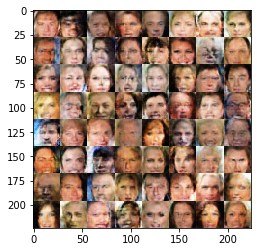

Epoch 1/1... Discriminator Loss: 1.0386... Generator Loss: 1.0093
Epoch 1/1... Discriminator Loss: 0.9271... Generator Loss: 1.9258
Epoch 1/1... Discriminator Loss: 1.0835... Generator Loss: 0.8733
Epoch 1/1... Discriminator Loss: 0.8641... Generator Loss: 1.5317
Epoch 1/1... Discriminator Loss: 0.9946... Generator Loss: 0.9621
Epoch 1/1... Discriminator Loss: 0.8555... Generator Loss: 1.4544
Epoch 1/1... Discriminator Loss: 0.8308... Generator Loss: 1.0407
Epoch 1/1... Discriminator Loss: 0.9615... Generator Loss: 1.2949
Epoch 1/1... Discriminator Loss: 0.9468... Generator Loss: 1.4385
Epoch 1/1... Discriminator Loss: 0.9495... Generator Loss: 1.1661


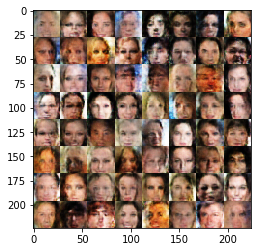

Epoch 1/1... Discriminator Loss: 0.7549... Generator Loss: 1.5595
Epoch 1/1... Discriminator Loss: 0.7830... Generator Loss: 1.2495
Epoch 1/1... Discriminator Loss: 0.8108... Generator Loss: 1.3262
Epoch 1/1... Discriminator Loss: 0.8956... Generator Loss: 1.4768
Epoch 1/1... Discriminator Loss: 0.8775... Generator Loss: 1.0692
Epoch 1/1... Discriminator Loss: 0.8035... Generator Loss: 1.1940
Epoch 1/1... Discriminator Loss: 0.8587... Generator Loss: 1.6713
Epoch 1/1... Discriminator Loss: 0.7483... Generator Loss: 1.4769
Epoch 1/1... Discriminator Loss: 1.0172... Generator Loss: 0.8528
Epoch 1/1... Discriminator Loss: 0.9886... Generator Loss: 2.1013


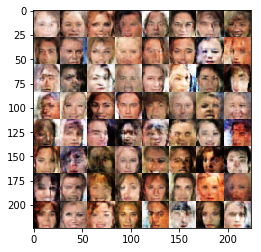

Epoch 1/1... Discriminator Loss: 0.8253... Generator Loss: 1.1729
Epoch 1/1... Discriminator Loss: 0.9094... Generator Loss: 1.1469
Epoch 1/1... Discriminator Loss: 0.8789... Generator Loss: 1.2566
Epoch 1/1... Discriminator Loss: 0.9516... Generator Loss: 1.4031
Epoch 1/1... Discriminator Loss: 0.9339... Generator Loss: 0.9967
Epoch 1/1... Discriminator Loss: 0.9675... Generator Loss: 1.5463
Epoch 1/1... Discriminator Loss: 0.9304... Generator Loss: 1.0875
Epoch 1/1... Discriminator Loss: 0.7994... Generator Loss: 1.6130
Epoch 1/1... Discriminator Loss: 0.8858... Generator Loss: 1.0310
Epoch 1/1... Discriminator Loss: 0.8139... Generator Loss: 1.4642


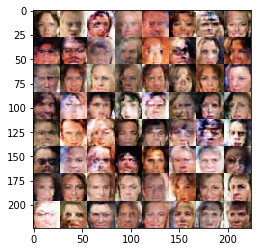

Epoch 1/1... Discriminator Loss: 0.7811... Generator Loss: 1.5427
Epoch 1/1... Discriminator Loss: 0.8730... Generator Loss: 0.9987
Epoch 1/1... Discriminator Loss: 0.9355... Generator Loss: 2.4166
Epoch 1/1... Discriminator Loss: 0.9997... Generator Loss: 0.9467
Epoch 1/1... Discriminator Loss: 1.1517... Generator Loss: 1.2197
Epoch 1/1... Discriminator Loss: 1.0213... Generator Loss: 0.8858
Epoch 1/1... Discriminator Loss: 0.8878... Generator Loss: 2.0289
Epoch 1/1... Discriminator Loss: 0.8055... Generator Loss: 1.1734
Epoch 1/1... Discriminator Loss: 0.9961... Generator Loss: 1.1098
Epoch 1/1... Discriminator Loss: 0.9920... Generator Loss: 1.7562


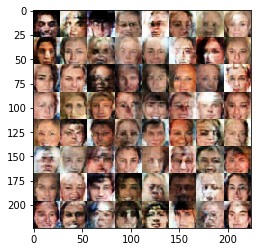

Epoch 1/1... Discriminator Loss: 0.8793... Generator Loss: 1.0013
Epoch 1/1... Discriminator Loss: 0.9727... Generator Loss: 1.5569
Epoch 1/1... Discriminator Loss: 0.8662... Generator Loss: 1.0398
Epoch 1/1... Discriminator Loss: 0.8756... Generator Loss: 1.6319
Epoch 1/1... Discriminator Loss: 0.9927... Generator Loss: 0.8856
Epoch 1/1... Discriminator Loss: 0.9125... Generator Loss: 1.6482
Epoch 1/1... Discriminator Loss: 0.8249... Generator Loss: 1.3112
Epoch 1/1... Discriminator Loss: 0.8792... Generator Loss: 1.1609
Epoch 1/1... Discriminator Loss: 0.8149... Generator Loss: 1.8349
Epoch 1/1... Discriminator Loss: 1.0451... Generator Loss: 0.7824


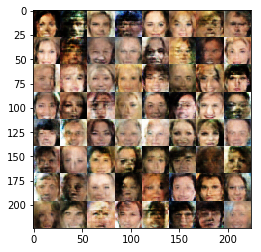

Epoch 1/1... Discriminator Loss: 0.9831... Generator Loss: 1.6407
Epoch 1/1... Discriminator Loss: 0.8301... Generator Loss: 1.3641
Epoch 1/1... Discriminator Loss: 0.9719... Generator Loss: 0.9497
Epoch 1/1... Discriminator Loss: 0.8235... Generator Loss: 1.6457
Epoch 1/1... Discriminator Loss: 0.8571... Generator Loss: 1.4423
Epoch 1/1... Discriminator Loss: 1.2780... Generator Loss: 0.7760
Epoch 1/1... Discriminator Loss: 1.0422... Generator Loss: 1.6266
Epoch 1/1... Discriminator Loss: 0.8092... Generator Loss: 1.3844
Epoch 1/1... Discriminator Loss: 0.8549... Generator Loss: 1.0939
Epoch 1/1... Discriminator Loss: 0.8174... Generator Loss: 2.0488


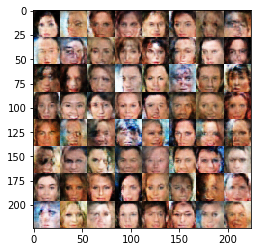

Epoch 1/1... Discriminator Loss: 1.0051... Generator Loss: 0.9489
Epoch 1/1... Discriminator Loss: 0.8722... Generator Loss: 1.2871
Epoch 1/1... Discriminator Loss: 0.9562... Generator Loss: 1.1147
Epoch 1/1... Discriminator Loss: 0.8721... Generator Loss: 1.4161
Epoch 1/1... Discriminator Loss: 0.8843... Generator Loss: 1.0393
Epoch 1/1... Discriminator Loss: 0.8618... Generator Loss: 1.4699
Epoch 1/1... Discriminator Loss: 0.8886... Generator Loss: 0.9734
Epoch 1/1... Discriminator Loss: 0.8405... Generator Loss: 1.9841
Epoch 1/1... Discriminator Loss: 0.7246... Generator Loss: 1.4058
Epoch 1/1... Discriminator Loss: 0.8996... Generator Loss: 1.0219


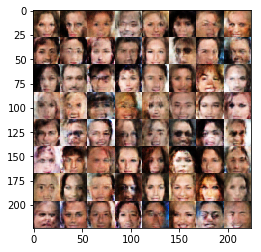

Epoch 1/1... Discriminator Loss: 0.8466... Generator Loss: 1.8169
Epoch 1/1... Discriminator Loss: 1.0381... Generator Loss: 0.9040
Epoch 1/1... Discriminator Loss: 0.7469... Generator Loss: 1.7325
Epoch 1/1... Discriminator Loss: 0.7454... Generator Loss: 1.3984
Epoch 1/1... Discriminator Loss: 0.8390... Generator Loss: 1.2812
Epoch 1/1... Discriminator Loss: 0.9333... Generator Loss: 1.0581
Epoch 1/1... Discriminator Loss: 0.7936... Generator Loss: 1.5709
Epoch 1/1... Discriminator Loss: 0.7830... Generator Loss: 1.6526
Epoch 1/1... Discriminator Loss: 1.1336... Generator Loss: 0.7743
Epoch 1/1... Discriminator Loss: 0.7913... Generator Loss: 1.8755


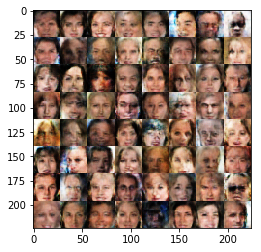

Epoch 1/1... Discriminator Loss: 0.7568... Generator Loss: 1.4606
Epoch 1/1... Discriminator Loss: 1.0894... Generator Loss: 1.0221
Epoch 1/1... Discriminator Loss: 0.8740... Generator Loss: 1.6475
Epoch 1/1... Discriminator Loss: 0.9406... Generator Loss: 1.0354
Epoch 1/1... Discriminator Loss: 0.9270... Generator Loss: 1.2508
Epoch 1/1... Discriminator Loss: 0.8862... Generator Loss: 1.3960
Epoch 1/1... Discriminator Loss: 1.1224... Generator Loss: 0.7741
Epoch 1/1... Discriminator Loss: 0.9382... Generator Loss: 1.6624
Epoch 1/1... Discriminator Loss: 0.9370... Generator Loss: 1.0138
Epoch 1/1... Discriminator Loss: 0.7851... Generator Loss: 1.4052


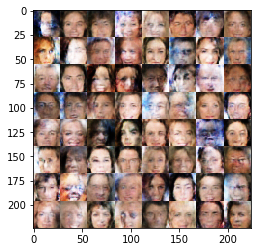

Epoch 1/1... Discriminator Loss: 0.9205... Generator Loss: 1.2663
Epoch 1/1... Discriminator Loss: 0.7871... Generator Loss: 1.4925
Epoch 1/1... Discriminator Loss: 0.9358... Generator Loss: 1.0651
Epoch 1/1... Discriminator Loss: 0.8719... Generator Loss: 1.6435
Epoch 1/1... Discriminator Loss: 0.8252... Generator Loss: 1.2578
Epoch 1/1... Discriminator Loss: 1.0287... Generator Loss: 0.9563
Epoch 1/1... Discriminator Loss: 0.9343... Generator Loss: 1.7819
Epoch 1/1... Discriminator Loss: 0.8453... Generator Loss: 0.9665
Epoch 1/1... Discriminator Loss: 0.7428... Generator Loss: 2.1045
Epoch 1/1... Discriminator Loss: 0.6462... Generator Loss: 1.5867


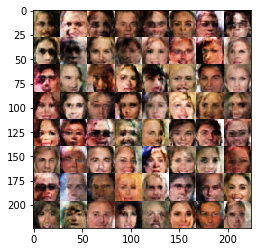

Epoch 1/1... Discriminator Loss: 0.8857... Generator Loss: 0.9504
Epoch 1/1... Discriminator Loss: 0.9607... Generator Loss: 1.4950
Epoch 1/1... Discriminator Loss: 0.9497... Generator Loss: 1.0886
Epoch 1/1... Discriminator Loss: 0.9797... Generator Loss: 1.1703
Epoch 1/1... Discriminator Loss: 0.8030... Generator Loss: 1.5366
Epoch 1/1... Discriminator Loss: 1.1723... Generator Loss: 0.8710
Epoch 1/1... Discriminator Loss: 0.9980... Generator Loss: 0.9225
Epoch 1/1... Discriminator Loss: 0.9890... Generator Loss: 2.4121
Epoch 1/1... Discriminator Loss: 0.9701... Generator Loss: 1.0044
Epoch 1/1... Discriminator Loss: 0.7362... Generator Loss: 1.4951


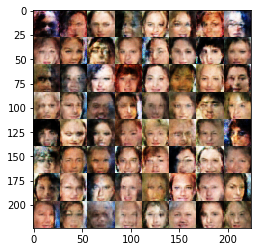

Epoch 1/1... Discriminator Loss: 0.8270... Generator Loss: 1.8240
Epoch 1/1... Discriminator Loss: 0.9060... Generator Loss: 0.9872
Epoch 1/1... Discriminator Loss: 0.8610... Generator Loss: 1.1483
Epoch 1/1... Discriminator Loss: 0.9010... Generator Loss: 1.3019
Epoch 1/1... Discriminator Loss: 1.0096... Generator Loss: 0.8929
Epoch 1/1... Discriminator Loss: 0.9693... Generator Loss: 1.5805
Epoch 1/1... Discriminator Loss: 0.8631... Generator Loss: 1.1036
Epoch 1/1... Discriminator Loss: 0.8480... Generator Loss: 1.1358
Epoch 1/1... Discriminator Loss: 0.8897... Generator Loss: 1.1641
Epoch 1/1... Discriminator Loss: 0.8002... Generator Loss: 1.5720


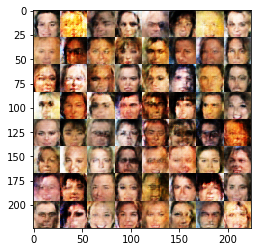

Epoch 1/1... Discriminator Loss: 0.9049... Generator Loss: 1.2311
Epoch 1/1... Discriminator Loss: 0.7770... Generator Loss: 1.2580
Epoch 1/1... Discriminator Loss: 0.9400... Generator Loss: 1.1610
Epoch 1/1... Discriminator Loss: 0.8570... Generator Loss: 1.5817
Epoch 1/1... Discriminator Loss: 0.7659... Generator Loss: 1.1581
Epoch 1/1... Discriminator Loss: 0.8287... Generator Loss: 1.2300
Epoch 1/1... Discriminator Loss: 0.8243... Generator Loss: 1.3934
Epoch 1/1... Discriminator Loss: 0.9844... Generator Loss: 1.1757
Epoch 1/1... Discriminator Loss: 1.0352... Generator Loss: 0.7985
Epoch 1/1... Discriminator Loss: 0.9419... Generator Loss: 1.8050


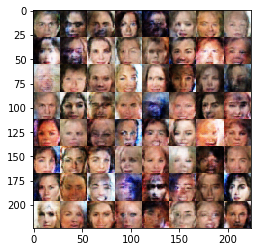

Epoch 1/1... Discriminator Loss: 0.8199... Generator Loss: 0.9249
Epoch 1/1... Discriminator Loss: 0.7932... Generator Loss: 1.3712
Epoch 1/1... Discriminator Loss: 0.9302... Generator Loss: 0.8554
Epoch 1/1... Discriminator Loss: 0.8893... Generator Loss: 1.5835
Epoch 1/1... Discriminator Loss: 0.8431... Generator Loss: 1.1182
Epoch 1/1... Discriminator Loss: 1.1830... Generator Loss: 0.7469
Epoch 1/1... Discriminator Loss: 0.9828... Generator Loss: 2.1220
Epoch 1/1... Discriminator Loss: 1.3210... Generator Loss: 0.6721
Epoch 1/1... Discriminator Loss: 1.3654... Generator Loss: 2.6859
Epoch 1/1... Discriminator Loss: 2.2620... Generator Loss: 0.3964


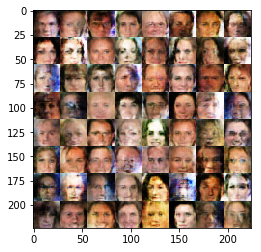

Epoch 1/1... Discriminator Loss: 1.8269... Generator Loss: 3.3596
Epoch 1/1... Discriminator Loss: 1.2676... Generator Loss: 0.7191
Epoch 1/1... Discriminator Loss: 1.0207... Generator Loss: 1.1954
Epoch 1/1... Discriminator Loss: 1.0851... Generator Loss: 1.4149
Epoch 1/1... Discriminator Loss: 1.1667... Generator Loss: 0.8837
Epoch 1/1... Discriminator Loss: 1.0777... Generator Loss: 1.0930
Epoch 1/1... Discriminator Loss: 1.1058... Generator Loss: 1.0932
Epoch 1/1... Discriminator Loss: 0.9296... Generator Loss: 1.3021
Epoch 1/1... Discriminator Loss: 1.0081... Generator Loss: 1.0385
Epoch 1/1... Discriminator Loss: 0.9081... Generator Loss: 1.4174


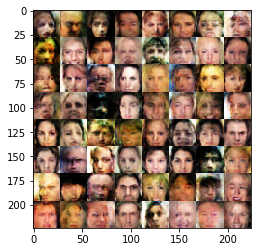

Epoch 1/1... Discriminator Loss: 0.8452... Generator Loss: 1.3696
Epoch 1/1... Discriminator Loss: 0.7980... Generator Loss: 1.2688
Epoch 1/1... Discriminator Loss: 0.9732... Generator Loss: 1.0535
Epoch 1/1... Discriminator Loss: 0.8318... Generator Loss: 1.6048
Epoch 1/1... Discriminator Loss: 0.7560... Generator Loss: 1.3957
Epoch 1/1... Discriminator Loss: 0.9027... Generator Loss: 1.1945
Epoch 1/1... Discriminator Loss: 0.9403... Generator Loss: 1.4458
Epoch 1/1... Discriminator Loss: 0.9274... Generator Loss: 0.9853
Epoch 1/1... Discriminator Loss: 1.0236... Generator Loss: 1.0938
Epoch 1/1... Discriminator Loss: 0.8837... Generator Loss: 1.2361


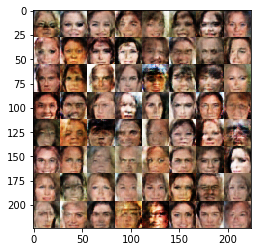

Epoch 1/1... Discriminator Loss: 1.0050... Generator Loss: 0.8505
Epoch 1/1... Discriminator Loss: 0.9364... Generator Loss: 1.5502
Epoch 1/1... Discriminator Loss: 1.1868... Generator Loss: 0.6632
Epoch 1/1... Discriminator Loss: 0.8392... Generator Loss: 1.9086
Epoch 1/1... Discriminator Loss: 1.0008... Generator Loss: 1.1401
Epoch 1/1... Discriminator Loss: 0.8493... Generator Loss: 1.3928
Epoch 1/1... Discriminator Loss: 0.9614... Generator Loss: 1.1934
Epoch 1/1... Discriminator Loss: 0.9870... Generator Loss: 0.9436
Epoch 1/1... Discriminator Loss: 1.0305... Generator Loss: 1.4192
Epoch 1/1... Discriminator Loss: 0.9871... Generator Loss: 0.9154


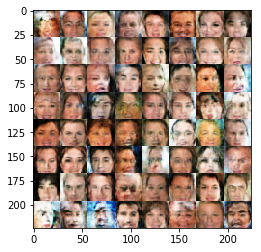

Epoch 1/1... Discriminator Loss: 0.8313... Generator Loss: 1.6342
Epoch 1/1... Discriminator Loss: 1.1045... Generator Loss: 0.9150
Epoch 1/1... Discriminator Loss: 0.9308... Generator Loss: 1.5833
Epoch 1/1... Discriminator Loss: 0.9180... Generator Loss: 1.0248
Epoch 1/1... Discriminator Loss: 0.8115... Generator Loss: 1.4923
Epoch 1/1... Discriminator Loss: 0.9636... Generator Loss: 1.0918
Epoch 1/1... Discriminator Loss: 0.8664... Generator Loss: 1.3273
Epoch 1/1... Discriminator Loss: 0.8621... Generator Loss: 1.4119
Epoch 1/1... Discriminator Loss: 1.0034... Generator Loss: 0.9010
Epoch 1/1... Discriminator Loss: 1.0065... Generator Loss: 1.6650


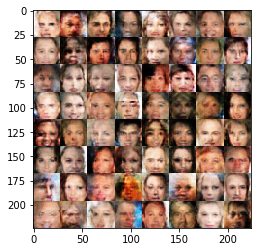

Epoch 1/1... Discriminator Loss: 0.8718... Generator Loss: 1.0389
Epoch 1/1... Discriminator Loss: 0.8295... Generator Loss: 1.2376
Epoch 1/1... Discriminator Loss: 0.8462... Generator Loss: 1.6421
Epoch 1/1... Discriminator Loss: 0.9243... Generator Loss: 1.0481
Epoch 1/1... Discriminator Loss: 0.7971... Generator Loss: 1.4710
Epoch 1/1... Discriminator Loss: 0.9949... Generator Loss: 1.1165
Epoch 1/1... Discriminator Loss: 0.8473... Generator Loss: 1.3618
Epoch 1/1... Discriminator Loss: 0.9775... Generator Loss: 1.0716
Epoch 1/1... Discriminator Loss: 0.7405... Generator Loss: 1.5970
Epoch 1/1... Discriminator Loss: 0.9282... Generator Loss: 1.0113


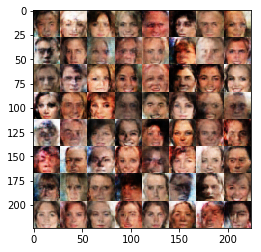

Epoch 1/1... Discriminator Loss: 0.7810... Generator Loss: 1.6984
Epoch 1/1... Discriminator Loss: 0.7763... Generator Loss: 1.5168
Epoch 1/1... Discriminator Loss: 0.7948... Generator Loss: 1.6037
Epoch 1/1... Discriminator Loss: 1.0604... Generator Loss: 0.8918
Epoch 1/1... Discriminator Loss: 0.9121... Generator Loss: 1.4474
Epoch 1/1... Discriminator Loss: 0.7328... Generator Loss: 1.4431
Epoch 1/1... Discriminator Loss: 0.7784... Generator Loss: 1.2199
Epoch 1/1... Discriminator Loss: 0.9308... Generator Loss: 1.0574
Epoch 1/1... Discriminator Loss: 0.8161... Generator Loss: 1.6260
Epoch 1/1... Discriminator Loss: 0.9045... Generator Loss: 1.2433


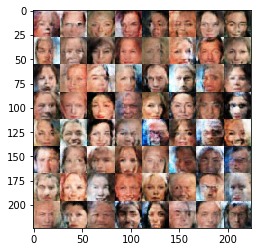

Epoch 1/1... Discriminator Loss: 0.7738... Generator Loss: 1.3422
Epoch 1/1... Discriminator Loss: 1.0215... Generator Loss: 0.9739
Epoch 1/1... Discriminator Loss: 0.7754... Generator Loss: 1.7070
Epoch 1/1... Discriminator Loss: 0.9236... Generator Loss: 1.1362
Epoch 1/1... Discriminator Loss: 0.7815... Generator Loss: 1.4029
Epoch 1/1... Discriminator Loss: 0.7756... Generator Loss: 1.2952
Epoch 1/1... Discriminator Loss: 0.9304... Generator Loss: 1.1851
Epoch 1/1... Discriminator Loss: 0.8137... Generator Loss: 1.5369
Epoch 1/1... Discriminator Loss: 1.0376... Generator Loss: 0.8994
Epoch 1/1... Discriminator Loss: 0.8742... Generator Loss: 1.9313


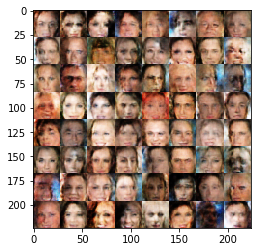

Epoch 1/1... Discriminator Loss: 1.0418... Generator Loss: 0.8838
Epoch 1/1... Discriminator Loss: 0.8283... Generator Loss: 1.3170
Epoch 1/1... Discriminator Loss: 0.8203... Generator Loss: 1.3429
Epoch 1/1... Discriminator Loss: 0.9242... Generator Loss: 0.9640
Epoch 1/1... Discriminator Loss: 0.8787... Generator Loss: 1.8259
Epoch 1/1... Discriminator Loss: 0.8989... Generator Loss: 1.0085
Epoch 1/1... Discriminator Loss: 0.8078... Generator Loss: 1.5421
Epoch 1/1... Discriminator Loss: 0.8470... Generator Loss: 1.2144
Epoch 1/1... Discriminator Loss: 0.8199... Generator Loss: 1.6428
Epoch 1/1... Discriminator Loss: 0.9037... Generator Loss: 1.1071


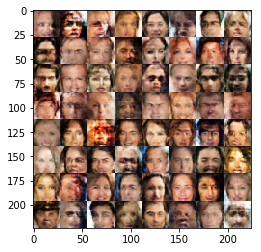

Epoch 1/1... Discriminator Loss: 0.7828... Generator Loss: 1.5068
Epoch 1/1... Discriminator Loss: 0.7983... Generator Loss: 1.5728
Epoch 1/1... Discriminator Loss: 0.8505... Generator Loss: 1.1557
Epoch 1/1... Discriminator Loss: 0.8988... Generator Loss: 1.1544
Epoch 1/1... Discriminator Loss: 0.7754... Generator Loss: 1.8749
Epoch 1/1... Discriminator Loss: 0.7411... Generator Loss: 1.6619
Epoch 1/1... Discriminator Loss: 1.0728... Generator Loss: 0.7954
Epoch 1/1... Discriminator Loss: 0.8366... Generator Loss: 1.8158
Epoch 1/1... Discriminator Loss: 0.8464... Generator Loss: 1.2349
Epoch 1/1... Discriminator Loss: 1.0516... Generator Loss: 1.0249


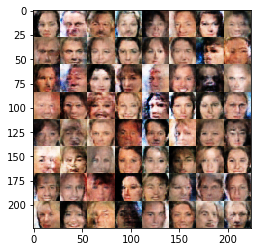

Epoch 1/1... Discriminator Loss: 0.9003... Generator Loss: 0.9089
Epoch 1/1... Discriminator Loss: 0.9305... Generator Loss: 1.8210
Epoch 1/1... Discriminator Loss: 0.9649... Generator Loss: 0.8526
Epoch 1/1... Discriminator Loss: 0.9407... Generator Loss: 1.4398
Epoch 1/1... Discriminator Loss: 0.9537... Generator Loss: 1.7145
Epoch 1/1... Discriminator Loss: 0.9899... Generator Loss: 1.0268
Epoch 1/1... Discriminator Loss: 0.9090... Generator Loss: 1.4008
Epoch 1/1... Discriminator Loss: 0.7911... Generator Loss: 1.7302
Epoch 1/1... Discriminator Loss: 0.8691... Generator Loss: 1.0155
Epoch 1/1... Discriminator Loss: 0.9432... Generator Loss: 1.4087


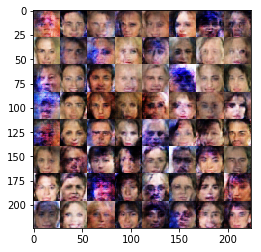

Epoch 1/1... Discriminator Loss: 0.6950... Generator Loss: 1.7964
Epoch 1/1... Discriminator Loss: 1.2474... Generator Loss: 0.6661
Epoch 1/1... Discriminator Loss: 0.9481... Generator Loss: 2.4365
Epoch 1/1... Discriminator Loss: 1.0627... Generator Loss: 0.8000
Epoch 1/1... Discriminator Loss: 0.8767... Generator Loss: 1.3781
Epoch 1/1... Discriminator Loss: 0.9754... Generator Loss: 1.2129
Epoch 1/1... Discriminator Loss: 0.9442... Generator Loss: 1.1293
Epoch 1/1... Discriminator Loss: 0.8990... Generator Loss: 1.6111
Epoch 1/1... Discriminator Loss: 0.9162... Generator Loss: 1.1687
Epoch 1/1... Discriminator Loss: 0.8915... Generator Loss: 1.4118


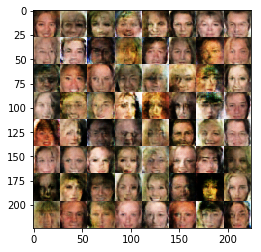

Epoch 1/1... Discriminator Loss: 1.0272... Generator Loss: 0.8354
Epoch 1/1... Discriminator Loss: 0.8793... Generator Loss: 1.7544
Epoch 1/1... Discriminator Loss: 0.9692... Generator Loss: 0.9642
Epoch 1/1... Discriminator Loss: 0.8697... Generator Loss: 2.0332
Epoch 1/1... Discriminator Loss: 1.0598... Generator Loss: 0.8916
Epoch 1/1... Discriminator Loss: 0.7803... Generator Loss: 1.5153
Epoch 1/1... Discriminator Loss: 0.8382... Generator Loss: 1.6743
Epoch 1/1... Discriminator Loss: 0.9226... Generator Loss: 1.0889
Epoch 1/1... Discriminator Loss: 0.8076... Generator Loss: 1.6625
Epoch 1/1... Discriminator Loss: 0.9675... Generator Loss: 0.8961


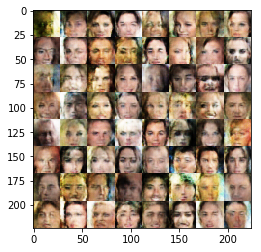

Epoch 1/1... Discriminator Loss: 0.9219... Generator Loss: 1.2789
Epoch 1/1... Discriminator Loss: 0.8104... Generator Loss: 1.7436
Epoch 1/1... Discriminator Loss: 0.9756... Generator Loss: 0.9474
Epoch 1/1... Discriminator Loss: 0.8057... Generator Loss: 1.5838
Epoch 1/1... Discriminator Loss: 0.7913... Generator Loss: 1.7014
Epoch 1/1... Discriminator Loss: 1.0582... Generator Loss: 0.8685
Epoch 1/1... Discriminator Loss: 0.9083... Generator Loss: 1.3975
Epoch 1/1... Discriminator Loss: 0.9156... Generator Loss: 1.4182
Epoch 1/1... Discriminator Loss: 1.0162... Generator Loss: 0.9219
Epoch 1/1... Discriminator Loss: 0.7847... Generator Loss: 1.4898


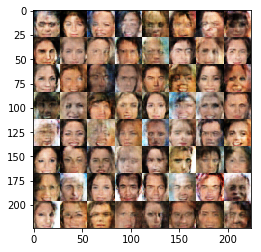

Epoch 1/1... Discriminator Loss: 0.8671... Generator Loss: 1.1495
Epoch 1/1... Discriminator Loss: 0.8175... Generator Loss: 1.6003
Epoch 1/1... Discriminator Loss: 0.9773... Generator Loss: 1.0273
Epoch 1/1... Discriminator Loss: 0.9531... Generator Loss: 1.0270
Epoch 1/1... Discriminator Loss: 0.9241... Generator Loss: 1.8049
Epoch 1/1... Discriminator Loss: 0.9807... Generator Loss: 1.0436
Epoch 1/1... Discriminator Loss: 0.9856... Generator Loss: 1.1859
Epoch 1/1... Discriminator Loss: 0.8918... Generator Loss: 1.6708
Epoch 1/1... Discriminator Loss: 0.9183... Generator Loss: 0.8981
Epoch 1/1... Discriminator Loss: 0.9807... Generator Loss: 1.5014


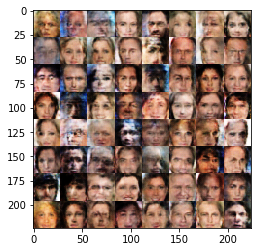

Epoch 1/1... Discriminator Loss: 0.8819... Generator Loss: 1.1328
Epoch 1/1... Discriminator Loss: 0.8039... Generator Loss: 1.5736
Epoch 1/1... Discriminator Loss: 0.9182... Generator Loss: 0.9244
Epoch 1/1... Discriminator Loss: 0.8653... Generator Loss: 1.7080
Epoch 1/1... Discriminator Loss: 0.8108... Generator Loss: 1.4164
Epoch 1/1... Discriminator Loss: 0.8347... Generator Loss: 1.1095
Epoch 1/1... Discriminator Loss: 0.8002... Generator Loss: 1.3579
Epoch 1/1... Discriminator Loss: 0.8127... Generator Loss: 1.3437
Epoch 1/1... Discriminator Loss: 1.0249... Generator Loss: 0.8789
Epoch 1/1... Discriminator Loss: 0.8784... Generator Loss: 2.3357


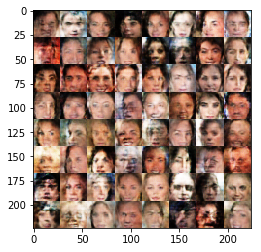

Epoch 1/1... Discriminator Loss: 0.9297... Generator Loss: 0.9474
Epoch 1/1... Discriminator Loss: 0.8122... Generator Loss: 1.6869
Epoch 1/1... Discriminator Loss: 0.8938... Generator Loss: 1.0919
Epoch 1/1... Discriminator Loss: 0.8610... Generator Loss: 1.6101
Epoch 1/1... Discriminator Loss: 0.7365... Generator Loss: 1.4075
Epoch 1/1... Discriminator Loss: 0.9342... Generator Loss: 1.1171
Epoch 1/1... Discriminator Loss: 0.9256... Generator Loss: 1.9075
Epoch 1/1... Discriminator Loss: 0.9071... Generator Loss: 1.1439
Epoch 1/1... Discriminator Loss: 0.8248... Generator Loss: 1.2444
Epoch 1/1... Discriminator Loss: 0.8867... Generator Loss: 1.5438


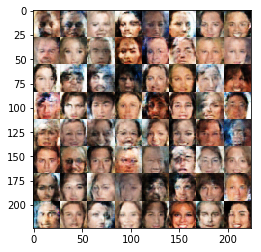

Epoch 1/1... Discriminator Loss: 0.7842... Generator Loss: 1.3707
Epoch 1/1... Discriminator Loss: 0.8433... Generator Loss: 1.4612
Epoch 1/1... Discriminator Loss: 0.7819... Generator Loss: 1.4662
Epoch 1/1... Discriminator Loss: 0.8859... Generator Loss: 0.9852
Epoch 1/1... Discriminator Loss: 0.9571... Generator Loss: 1.2485
Epoch 1/1... Discriminator Loss: 0.8244... Generator Loss: 1.3644
Epoch 1/1... Discriminator Loss: 0.9416... Generator Loss: 1.0455
Epoch 1/1... Discriminator Loss: 0.9164... Generator Loss: 2.2678
Epoch 1/1... Discriminator Loss: 0.8943... Generator Loss: 0.9512
Epoch 1/1... Discriminator Loss: 0.7358... Generator Loss: 1.6082


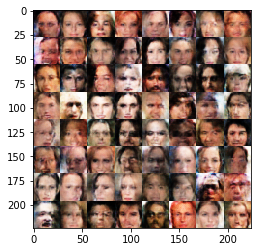

Epoch 1/1... Discriminator Loss: 0.8000... Generator Loss: 1.4414
Epoch 1/1... Discriminator Loss: 0.8594... Generator Loss: 1.3301
Epoch 1/1... Discriminator Loss: 0.9040... Generator Loss: 1.1014
Epoch 1/1... Discriminator Loss: 0.7985... Generator Loss: 1.2943
Epoch 1/1... Discriminator Loss: 1.0217... Generator Loss: 0.9921
Epoch 1/1... Discriminator Loss: 1.0442... Generator Loss: 1.2543
Epoch 1/1... Discriminator Loss: 0.7456... Generator Loss: 1.5129
Epoch 1/1... Discriminator Loss: 0.8766... Generator Loss: 1.2040
Epoch 1/1... Discriminator Loss: 0.8594... Generator Loss: 1.4203
Epoch 1/1... Discriminator Loss: 0.7529... Generator Loss: 1.6157


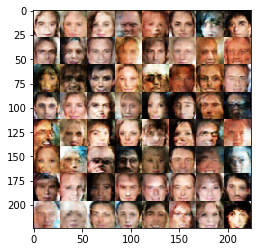

Epoch 1/1... Discriminator Loss: 0.8450... Generator Loss: 1.1286
Epoch 1/1... Discriminator Loss: 0.7467... Generator Loss: 1.7642
Epoch 1/1... Discriminator Loss: 0.7340... Generator Loss: 1.4873
Epoch 1/1... Discriminator Loss: 1.0096... Generator Loss: 0.9500
Epoch 1/1... Discriminator Loss: 1.0537... Generator Loss: 2.0696
Epoch 1/1... Discriminator Loss: 0.8769... Generator Loss: 1.2066
Epoch 1/1... Discriminator Loss: 0.8621... Generator Loss: 1.4010
Epoch 1/1... Discriminator Loss: 1.0467... Generator Loss: 0.8830
Epoch 1/1... Discriminator Loss: 0.9074... Generator Loss: 1.2811
Epoch 1/1... Discriminator Loss: 0.8205... Generator Loss: 1.2791


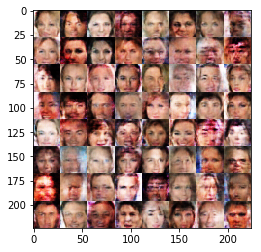

Epoch 1/1... Discriminator Loss: 0.8787... Generator Loss: 1.4589
Epoch 1/1... Discriminator Loss: 0.9945... Generator Loss: 1.0544
Epoch 1/1... Discriminator Loss: 0.8447... Generator Loss: 1.1996
Epoch 1/1... Discriminator Loss: 0.8182... Generator Loss: 1.7702
Epoch 1/1... Discriminator Loss: 0.9281... Generator Loss: 1.0866
Epoch 1/1... Discriminator Loss: 0.7270... Generator Loss: 1.4652
Epoch 1/1... Discriminator Loss: 0.8478... Generator Loss: 1.0537
Epoch 1/1... Discriminator Loss: 0.8037... Generator Loss: 1.6189
Epoch 1/1... Discriminator Loss: 0.7570... Generator Loss: 1.5348
Epoch 1/1... Discriminator Loss: 0.9342... Generator Loss: 0.9171


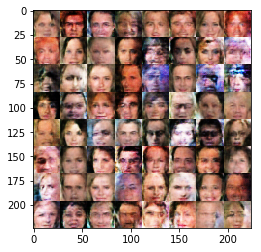

Epoch 1/1... Discriminator Loss: 0.8031... Generator Loss: 2.0830
Epoch 1/1... Discriminator Loss: 0.8038... Generator Loss: 1.2148
Epoch 1/1... Discriminator Loss: 0.8910... Generator Loss: 0.9934
Epoch 1/1... Discriminator Loss: 0.9153... Generator Loss: 2.0638
Epoch 1/1... Discriminator Loss: 1.1790... Generator Loss: 0.7514
Epoch 1/1... Discriminator Loss: 0.9983... Generator Loss: 2.1454
Epoch 1/1... Discriminator Loss: 0.9082... Generator Loss: 1.0927
Epoch 1/1... Discriminator Loss: 0.8583... Generator Loss: 1.8288
Epoch 1/1... Discriminator Loss: 1.1647... Generator Loss: 0.7339
Epoch 1/1... Discriminator Loss: 1.0276... Generator Loss: 1.8490


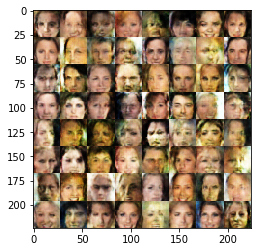

Epoch 1/1... Discriminator Loss: 0.9058... Generator Loss: 1.0157
Epoch 1/1... Discriminator Loss: 0.9866... Generator Loss: 1.2280
Epoch 1/1... Discriminator Loss: 0.8984... Generator Loss: 1.1987
Epoch 1/1... Discriminator Loss: 1.0811... Generator Loss: 0.8849
Epoch 1/1... Discriminator Loss: 0.9338... Generator Loss: 1.4622
Epoch 1/1... Discriminator Loss: 0.6768... Generator Loss: 1.4668
Epoch 1/1... Discriminator Loss: 0.8926... Generator Loss: 1.1809
Epoch 1/1... Discriminator Loss: 0.8930... Generator Loss: 1.5201
Epoch 1/1... Discriminator Loss: 0.8138... Generator Loss: 1.2387
Epoch 1/1... Discriminator Loss: 0.9043... Generator Loss: 1.5442


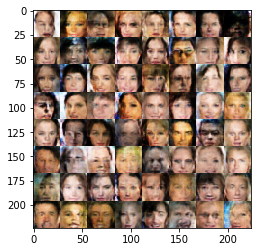

Epoch 1/1... Discriminator Loss: 0.8772... Generator Loss: 0.9748
Epoch 1/1... Discriminator Loss: 0.9094... Generator Loss: 1.4765
Epoch 1/1... Discriminator Loss: 0.7631... Generator Loss: 1.5412
Epoch 1/1... Discriminator Loss: 0.9149... Generator Loss: 1.0730
Epoch 1/1... Discriminator Loss: 0.8228... Generator Loss: 1.7162
Epoch 1/1... Discriminator Loss: 1.0215... Generator Loss: 0.9735
Epoch 1/1... Discriminator Loss: 1.1113... Generator Loss: 2.1348
Epoch 1/1... Discriminator Loss: 1.0282... Generator Loss: 0.8377
Epoch 1/1... Discriminator Loss: 0.9427... Generator Loss: 2.1267
Epoch 1/1... Discriminator Loss: 1.0005... Generator Loss: 0.9648


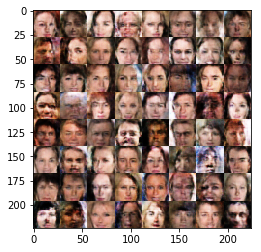

Epoch 1/1... Discriminator Loss: 0.9330... Generator Loss: 1.8021
Epoch 1/1... Discriminator Loss: 1.0626... Generator Loss: 0.8033
Epoch 1/1... Discriminator Loss: 0.9038... Generator Loss: 1.9747
Epoch 1/1... Discriminator Loss: 0.9845... Generator Loss: 1.0492
Epoch 1/1... Discriminator Loss: 0.9530... Generator Loss: 1.2373
Epoch 1/1... Discriminator Loss: 0.8620... Generator Loss: 1.6811
Epoch 1/1... Discriminator Loss: 0.7476... Generator Loss: 1.3161
Epoch 1/1... Discriminator Loss: 0.9020... Generator Loss: 1.0992
Epoch 1/1... Discriminator Loss: 0.8864... Generator Loss: 1.4058
Epoch 1/1... Discriminator Loss: 0.8839... Generator Loss: 1.5037


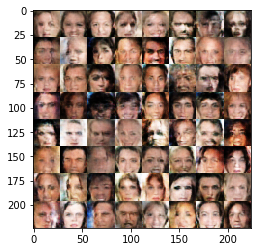

Epoch 1/1... Discriminator Loss: 0.9200... Generator Loss: 1.0796
Epoch 1/1... Discriminator Loss: 0.8806... Generator Loss: 1.2863
Epoch 1/1... Discriminator Loss: 0.8303... Generator Loss: 1.5904
Epoch 1/1... Discriminator Loss: 0.7731... Generator Loss: 1.2760
Epoch 1/1... Discriminator Loss: 0.6938... Generator Loss: 1.6742
Epoch 1/1... Discriminator Loss: 1.0363... Generator Loss: 0.8867
Epoch 1/1... Discriminator Loss: 0.7890... Generator Loss: 1.7833
Epoch 1/1... Discriminator Loss: 0.8688... Generator Loss: 1.0457
Epoch 1/1... Discriminator Loss: 0.8893... Generator Loss: 1.5084
Epoch 1/1... Discriminator Loss: 0.8999... Generator Loss: 1.1710


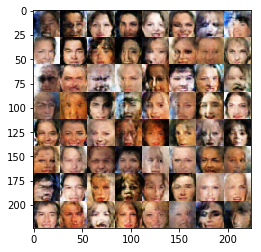

Epoch 1/1... Discriminator Loss: 0.8278... Generator Loss: 1.5152
Epoch 1/1... Discriminator Loss: 0.8949... Generator Loss: 1.0576
Epoch 1/1... Discriminator Loss: 0.7967... Generator Loss: 1.9420
Epoch 1/1... Discriminator Loss: 1.0542... Generator Loss: 0.8794
Epoch 1/1... Discriminator Loss: 0.8496... Generator Loss: 1.7543
Epoch 1/1... Discriminator Loss: 0.9522... Generator Loss: 1.0020
Epoch 1/1... Discriminator Loss: 0.8205... Generator Loss: 1.8142
Epoch 1/1... Discriminator Loss: 0.7617... Generator Loss: 1.2162
Epoch 1/1... Discriminator Loss: 0.8124... Generator Loss: 1.2386
Epoch 1/1... Discriminator Loss: 0.8347... Generator Loss: 1.5926


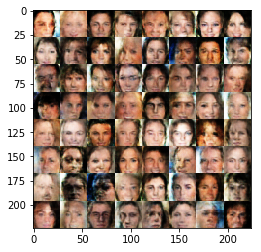

Epoch 1/1... Discriminator Loss: 1.0053... Generator Loss: 0.9327
Epoch 1/1... Discriminator Loss: 0.8977... Generator Loss: 2.0319
Epoch 1/1... Discriminator Loss: 0.9695... Generator Loss: 0.9310
Epoch 1/1... Discriminator Loss: 0.9346... Generator Loss: 2.1107
Epoch 1/1... Discriminator Loss: 1.1166... Generator Loss: 0.7957
Epoch 1/1... Discriminator Loss: 0.9176... Generator Loss: 1.8767
Epoch 1/1... Discriminator Loss: 0.9771... Generator Loss: 0.9006
Epoch 1/1... Discriminator Loss: 0.8732... Generator Loss: 2.0375
Epoch 1/1... Discriminator Loss: 0.8069... Generator Loss: 1.1699
Epoch 1/1... Discriminator Loss: 0.8550... Generator Loss: 1.2368


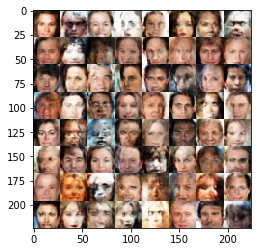

Epoch 1/1... Discriminator Loss: 0.9467... Generator Loss: 1.2777
Epoch 1/1... Discriminator Loss: 0.9321... Generator Loss: 0.9939
Epoch 1/1... Discriminator Loss: 1.0671... Generator Loss: 0.9335
Epoch 1/1... Discriminator Loss: 0.7484... Generator Loss: 1.8526
Epoch 1/1... Discriminator Loss: 0.8999... Generator Loss: 1.0178
Epoch 1/1... Discriminator Loss: 0.9198... Generator Loss: 1.2152
Epoch 1/1... Discriminator Loss: 0.8703... Generator Loss: 1.2315
Epoch 1/1... Discriminator Loss: 0.8086... Generator Loss: 1.3330
Epoch 1/1... Discriminator Loss: 0.7882... Generator Loss: 1.4518
Epoch 1/1... Discriminator Loss: 1.1082... Generator Loss: 0.8364


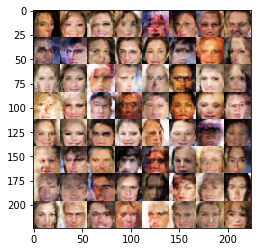

Epoch 1/1... Discriminator Loss: 1.0731... Generator Loss: 1.5357
Epoch 1/1... Discriminator Loss: 0.8273... Generator Loss: 1.2688
Epoch 1/1... Discriminator Loss: 0.9065... Generator Loss: 1.1643
Epoch 1/1... Discriminator Loss: 0.8593... Generator Loss: 1.8456
Epoch 1/1... Discriminator Loss: 0.7962... Generator Loss: 1.2437
Epoch 1/1... Discriminator Loss: 0.7728... Generator Loss: 1.2407
Epoch 1/1... Discriminator Loss: 0.8636... Generator Loss: 1.3083
Epoch 1/1... Discriminator Loss: 0.9748... Generator Loss: 1.0361
Epoch 1/1... Discriminator Loss: 0.7287... Generator Loss: 1.9504
Epoch 1/1... Discriminator Loss: 0.8633... Generator Loss: 1.0287


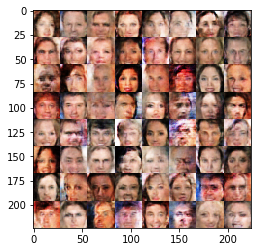

Epoch 1/1... Discriminator Loss: 0.7776... Generator Loss: 1.7612
Epoch 1/1... Discriminator Loss: 0.8848... Generator Loss: 0.9342
Epoch 1/1... Discriminator Loss: 0.8428... Generator Loss: 1.8174
Epoch 1/1... Discriminator Loss: 0.8952... Generator Loss: 1.0503
Epoch 1/1... Discriminator Loss: 0.8727... Generator Loss: 1.3580
Epoch 1/1... Discriminator Loss: 0.7858... Generator Loss: 1.8798
Epoch 1/1... Discriminator Loss: 1.1848... Generator Loss: 0.7123
Epoch 1/1... Discriminator Loss: 0.9346... Generator Loss: 1.7143
Epoch 1/1... Discriminator Loss: 0.8395... Generator Loss: 0.9760
Epoch 1/1... Discriminator Loss: 1.0601... Generator Loss: 1.6795


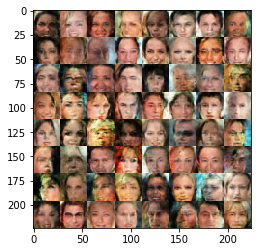

Epoch 1/1... Discriminator Loss: 0.7122... Generator Loss: 1.5185
Epoch 1/1... Discriminator Loss: 1.1430... Generator Loss: 0.8160
Epoch 1/1... Discriminator Loss: 0.9267... Generator Loss: 1.2502
Epoch 1/1... Discriminator Loss: 0.8967... Generator Loss: 1.7845
Epoch 1/1... Discriminator Loss: 0.9475... Generator Loss: 0.9458
Epoch 1/1... Discriminator Loss: 0.8996... Generator Loss: 1.5579
Epoch 1/1... Discriminator Loss: 0.8606... Generator Loss: 1.1466
Epoch 1/1... Discriminator Loss: 0.7949... Generator Loss: 1.4834
Epoch 1/1... Discriminator Loss: 0.7313... Generator Loss: 1.5630
Epoch 1/1... Discriminator Loss: 1.1539... Generator Loss: 0.7283


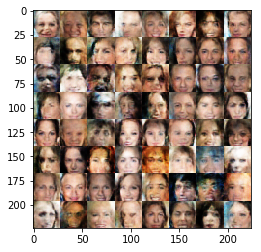

Epoch 1/1... Discriminator Loss: 1.0752... Generator Loss: 1.8878
Epoch 1/1... Discriminator Loss: 0.9012... Generator Loss: 1.0047
Epoch 1/1... Discriminator Loss: 0.9236... Generator Loss: 1.3759
Epoch 1/1... Discriminator Loss: 0.8231... Generator Loss: 1.4576
Epoch 1/1... Discriminator Loss: 0.8040... Generator Loss: 1.1176
Epoch 1/1... Discriminator Loss: 1.0227... Generator Loss: 1.4138
Epoch 1/1... Discriminator Loss: 0.9122... Generator Loss: 1.0557
Epoch 1/1... Discriminator Loss: 0.7250... Generator Loss: 1.5122
Epoch 1/1... Discriminator Loss: 0.9160... Generator Loss: 1.1268
Epoch 1/1... Discriminator Loss: 0.8814... Generator Loss: 1.0926


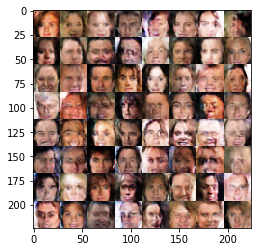

Epoch 1/1... Discriminator Loss: 0.8763... Generator Loss: 1.8642
Epoch 1/1... Discriminator Loss: 0.9585... Generator Loss: 0.9795
Epoch 1/1... Discriminator Loss: 0.8272... Generator Loss: 1.5804
Epoch 1/1... Discriminator Loss: 0.9420... Generator Loss: 1.0457
Epoch 1/1... Discriminator Loss: 0.8547... Generator Loss: 1.2443
Epoch 1/1... Discriminator Loss: 0.8056... Generator Loss: 1.4472
Epoch 1/1... Discriminator Loss: 0.8839... Generator Loss: 1.3369
Epoch 1/1... Discriminator Loss: 0.7314... Generator Loss: 1.8296
Epoch 1/1... Discriminator Loss: 1.0733... Generator Loss: 0.7583
Epoch 1/1... Discriminator Loss: 0.8869... Generator Loss: 1.8752


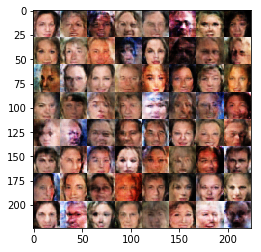

Epoch 1/1... Discriminator Loss: 0.8575... Generator Loss: 1.2722
Epoch 1/1... Discriminator Loss: 1.3442... Generator Loss: 0.6971
Epoch 1/1... Discriminator Loss: 1.0661... Generator Loss: 1.7147
Epoch 1/1... Discriminator Loss: 0.9599... Generator Loss: 1.1013
Epoch 1/1... Discriminator Loss: 0.9315... Generator Loss: 1.0645
Epoch 1/1... Discriminator Loss: 1.0883... Generator Loss: 1.0389
Epoch 1/1... Discriminator Loss: 0.9450... Generator Loss: 1.6249
Epoch 1/1... Discriminator Loss: 0.9123... Generator Loss: 1.0210
Epoch 1/1... Discriminator Loss: 0.7621... Generator Loss: 1.3788
Epoch 1/1... Discriminator Loss: 0.8906... Generator Loss: 1.0899


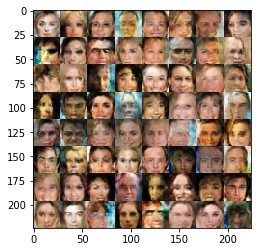

Epoch 1/1... Discriminator Loss: 0.9523... Generator Loss: 1.1091
Epoch 1/1... Discriminator Loss: 0.9974... Generator Loss: 2.0803
Epoch 1/1... Discriminator Loss: 1.1168... Generator Loss: 0.7429
Epoch 1/1... Discriminator Loss: 1.1442... Generator Loss: 2.4825
Epoch 1/1... Discriminator Loss: 1.2496... Generator Loss: 0.7038
Epoch 1/1... Discriminator Loss: 1.4443... Generator Loss: 2.3508
Epoch 1/1... Discriminator Loss: 1.3562... Generator Loss: 0.6174
Epoch 1/1... Discriminator Loss: 1.0404... Generator Loss: 2.0215
Epoch 1/1... Discriminator Loss: 0.9701... Generator Loss: 0.8848
Epoch 1/1... Discriminator Loss: 0.7669... Generator Loss: 1.3749


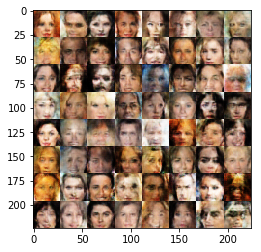

Epoch 1/1... Discriminator Loss: 0.9035... Generator Loss: 1.5075
Epoch 1/1... Discriminator Loss: 0.9893... Generator Loss: 0.9374
Epoch 1/1... Discriminator Loss: 0.9881... Generator Loss: 1.3310
Epoch 1/1... Discriminator Loss: 0.9957... Generator Loss: 1.2867
Epoch 1/1... Discriminator Loss: 0.8607... Generator Loss: 1.1503
Epoch 1/1... Discriminator Loss: 0.7575... Generator Loss: 1.4209
Epoch 1/1... Discriminator Loss: 1.0332... Generator Loss: 0.9519
Epoch 1/1... Discriminator Loss: 0.8005... Generator Loss: 1.3238
Epoch 1/1... Discriminator Loss: 0.9932... Generator Loss: 1.1658
Epoch 1/1... Discriminator Loss: 0.8429... Generator Loss: 1.8415


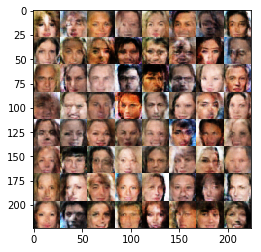

Epoch 1/1... Discriminator Loss: 0.9089... Generator Loss: 1.0165
Epoch 1/1... Discriminator Loss: 0.7884... Generator Loss: 1.6156
Epoch 1/1... Discriminator Loss: 0.8245... Generator Loss: 1.3362
Epoch 1/1... Discriminator Loss: 0.7978... Generator Loss: 1.2079
Epoch 1/1... Discriminator Loss: 0.8044... Generator Loss: 1.2217
Epoch 1/1... Discriminator Loss: 0.8203... Generator Loss: 1.5187
Epoch 1/1... Discriminator Loss: 1.2058... Generator Loss: 0.7944
Epoch 1/1... Discriminator Loss: 0.8607... Generator Loss: 1.3892
Epoch 1/1... Discriminator Loss: 0.8628... Generator Loss: 1.2653
Epoch 1/1... Discriminator Loss: 1.1317... Generator Loss: 0.6878


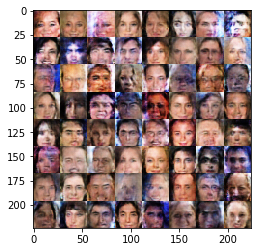

Epoch 1/1... Discriminator Loss: 1.1495... Generator Loss: 2.1635
Epoch 1/1... Discriminator Loss: 0.8625... Generator Loss: 1.1146
Epoch 1/1... Discriminator Loss: 0.7781... Generator Loss: 1.2098
Epoch 1/1... Discriminator Loss: 0.8524... Generator Loss: 1.9159
Epoch 1/1... Discriminator Loss: 0.8291... Generator Loss: 1.0788
Epoch 1/1... Discriminator Loss: 0.9282... Generator Loss: 1.0097
Epoch 1/1... Discriminator Loss: 0.8925... Generator Loss: 1.9676
Epoch 1/1... Discriminator Loss: 1.1739... Generator Loss: 0.8117
Epoch 1/1... Discriminator Loss: 1.0223... Generator Loss: 1.8430
Epoch 1/1... Discriminator Loss: 0.8636... Generator Loss: 1.1264


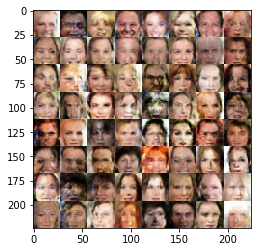

Epoch 1/1... Discriminator Loss: 0.8346... Generator Loss: 1.6414
Epoch 1/1... Discriminator Loss: 0.9388... Generator Loss: 0.9598
Epoch 1/1... Discriminator Loss: 0.7135... Generator Loss: 1.6841
Epoch 1/1... Discriminator Loss: 0.8925... Generator Loss: 1.1876
Epoch 1/1... Discriminator Loss: 0.7338... Generator Loss: 1.4867
Epoch 1/1... Discriminator Loss: 0.8752... Generator Loss: 1.1687
Epoch 1/1... Discriminator Loss: 0.9125... Generator Loss: 1.0894
Epoch 1/1... Discriminator Loss: 0.7648... Generator Loss: 1.8298
Epoch 1/1... Discriminator Loss: 0.8261... Generator Loss: 1.1847
Epoch 1/1... Discriminator Loss: 0.8672... Generator Loss: 1.2998


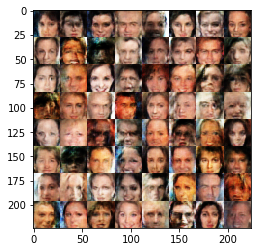

Epoch 1/1... Discriminator Loss: 0.9106... Generator Loss: 1.2391
Epoch 1/1... Discriminator Loss: 0.7360... Generator Loss: 1.5184
Epoch 1/1... Discriminator Loss: 0.9658... Generator Loss: 0.8685
Epoch 1/1... Discriminator Loss: 0.8087... Generator Loss: 1.8056
Epoch 1/1... Discriminator Loss: 0.9233... Generator Loss: 0.9995
Epoch 1/1... Discriminator Loss: 0.7485... Generator Loss: 1.8243
Epoch 1/1... Discriminator Loss: 1.0940... Generator Loss: 0.8375
Epoch 1/1... Discriminator Loss: 0.9379... Generator Loss: 1.5295
Epoch 1/1... Discriminator Loss: 0.9363... Generator Loss: 1.0370
Epoch 1/1... Discriminator Loss: 0.9185... Generator Loss: 1.7128


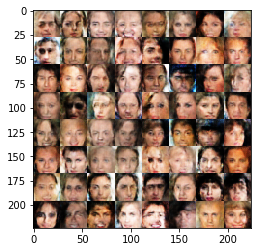

Epoch 1/1... Discriminator Loss: 0.9228... Generator Loss: 0.9717
Epoch 1/1... Discriminator Loss: 0.8657... Generator Loss: 1.2136
Epoch 1/1... Discriminator Loss: 0.9603... Generator Loss: 1.8951
Epoch 1/1... Discriminator Loss: 0.9849... Generator Loss: 0.8222
Epoch 1/1... Discriminator Loss: 0.8527... Generator Loss: 1.5313
Epoch 1/1... Discriminator Loss: 0.8161... Generator Loss: 1.3421
Epoch 1/1... Discriminator Loss: 0.7591... Generator Loss: 1.4282
Epoch 1/1... Discriminator Loss: 0.9869... Generator Loss: 0.7965
Epoch 1/1... Discriminator Loss: 0.8119... Generator Loss: 1.7209
Epoch 1/1... Discriminator Loss: 0.8895... Generator Loss: 1.3294


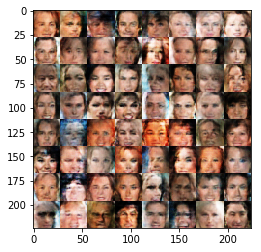

Epoch 1/1... Discriminator Loss: 0.7638... Generator Loss: 1.4842
Epoch 1/1... Discriminator Loss: 0.8742... Generator Loss: 1.0435
Epoch 1/1... Discriminator Loss: 0.7689... Generator Loss: 1.6101
Epoch 1/1... Discriminator Loss: 0.8669... Generator Loss: 1.0437
Epoch 1/1... Discriminator Loss: 0.8828... Generator Loss: 1.1685
Epoch 1/1... Discriminator Loss: 0.8522... Generator Loss: 1.7012
Epoch 1/1... Discriminator Loss: 1.2372... Generator Loss: 0.7503
Epoch 1/1... Discriminator Loss: 1.0985... Generator Loss: 1.7957
Epoch 1/1... Discriminator Loss: 0.8317... Generator Loss: 1.3776
Epoch 1/1... Discriminator Loss: 0.8342... Generator Loss: 1.2268


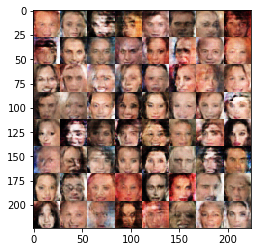

Epoch 1/1... Discriminator Loss: 0.8469... Generator Loss: 1.1310
Epoch 1/1... Discriminator Loss: 0.8963... Generator Loss: 1.4164
Epoch 1/1... Discriminator Loss: 0.8676... Generator Loss: 1.2625
Epoch 1/1... Discriminator Loss: 0.7296... Generator Loss: 1.5265
Epoch 1/1... Discriminator Loss: 0.6226... Generator Loss: 2.1481
Epoch 1/1... Discriminator Loss: 1.0981... Generator Loss: 0.7592
Epoch 1/1... Discriminator Loss: 1.1839... Generator Loss: 2.1255
Epoch 1/1... Discriminator Loss: 1.1982... Generator Loss: 0.7236
Epoch 1/1... Discriminator Loss: 0.8855... Generator Loss: 1.9544
Epoch 1/1... Discriminator Loss: 0.8377... Generator Loss: 1.3820


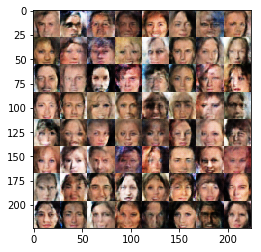

Epoch 1/1... Discriminator Loss: 1.0725... Generator Loss: 0.8995
Epoch 1/1... Discriminator Loss: 1.0504... Generator Loss: 1.7241
Epoch 1/1... Discriminator Loss: 0.9230... Generator Loss: 1.2759
Epoch 1/1... Discriminator Loss: 1.0337... Generator Loss: 0.8015
Epoch 1/1... Discriminator Loss: 0.9759... Generator Loss: 1.5494
Epoch 1/1... Discriminator Loss: 0.8427... Generator Loss: 1.2977
Epoch 1/1... Discriminator Loss: 0.8533... Generator Loss: 1.0381
Epoch 1/1... Discriminator Loss: 0.8720... Generator Loss: 1.4684
Epoch 1/1... Discriminator Loss: 0.8098... Generator Loss: 1.6167
Epoch 1/1... Discriminator Loss: 0.9285... Generator Loss: 1.0522


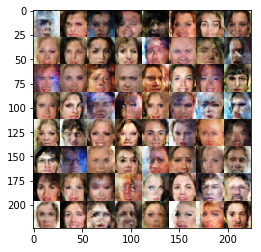

Epoch 1/1... Discriminator Loss: 0.8283... Generator Loss: 1.5462
Epoch 1/1... Discriminator Loss: 0.9300... Generator Loss: 1.0672
Epoch 1/1... Discriminator Loss: 0.8210... Generator Loss: 1.4758
Epoch 1/1... Discriminator Loss: 0.9372... Generator Loss: 0.9604
Epoch 1/1... Discriminator Loss: 0.9101... Generator Loss: 1.9606
Epoch 1/1... Discriminator Loss: 0.7348... Generator Loss: 1.5413
Epoch 1/1... Discriminator Loss: 0.8732... Generator Loss: 1.0729
Epoch 1/1... Discriminator Loss: 0.8612... Generator Loss: 1.5472
Epoch 1/1... Discriminator Loss: 0.9352... Generator Loss: 0.9805
Epoch 1/1... Discriminator Loss: 0.9019... Generator Loss: 1.4157


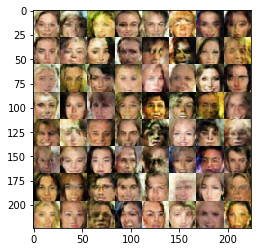

Epoch 1/1... Discriminator Loss: 0.8141... Generator Loss: 1.3883
Epoch 1/1... Discriminator Loss: 0.7485... Generator Loss: 1.2827
Epoch 1/1... Discriminator Loss: 0.8831... Generator Loss: 1.1198
Epoch 1/1... Discriminator Loss: 0.8281... Generator Loss: 1.5591
Epoch 1/1... Discriminator Loss: 0.9194... Generator Loss: 1.0767
Epoch 1/1... Discriminator Loss: 0.9211... Generator Loss: 1.0094
Epoch 1/1... Discriminator Loss: 0.7887... Generator Loss: 2.0921
Epoch 1/1... Discriminator Loss: 0.8263... Generator Loss: 1.2345
Epoch 1/1... Discriminator Loss: 0.8077... Generator Loss: 1.3725
Epoch 1/1... Discriminator Loss: 0.8265... Generator Loss: 1.4720


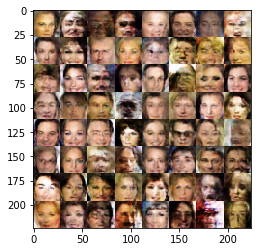

Epoch 1/1... Discriminator Loss: 0.7017... Generator Loss: 1.7703
Epoch 1/1... Discriminator Loss: 0.8362... Generator Loss: 1.2309
Epoch 1/1... Discriminator Loss: 0.7876... Generator Loss: 1.2990
Epoch 1/1... Discriminator Loss: 0.7329... Generator Loss: 1.6630
Epoch 1/1... Discriminator Loss: 0.9528... Generator Loss: 0.9424
Epoch 1/1... Discriminator Loss: 0.8963... Generator Loss: 1.2038
Epoch 1/1... Discriminator Loss: 0.9100... Generator Loss: 1.4118
Epoch 1/1... Discriminator Loss: 0.8410... Generator Loss: 1.2972
Epoch 1/1... Discriminator Loss: 0.9434... Generator Loss: 1.0046
Epoch 1/1... Discriminator Loss: 0.8607... Generator Loss: 2.3553


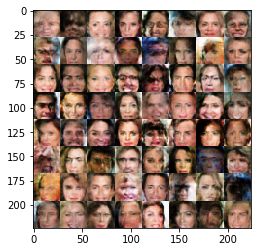

Epoch 1/1... Discriminator Loss: 1.4015... Generator Loss: 0.6217
Epoch 1/1... Discriminator Loss: 1.7106... Generator Loss: 2.2598
Epoch 1/1... Discriminator Loss: 1.2611... Generator Loss: 0.7181
Epoch 1/1... Discriminator Loss: 1.1944... Generator Loss: 2.0727
Epoch 1/1... Discriminator Loss: 0.9985... Generator Loss: 0.9008
Epoch 1/1... Discriminator Loss: 0.8436... Generator Loss: 1.5371
Epoch 1/1... Discriminator Loss: 1.0040... Generator Loss: 1.2158
Epoch 1/1... Discriminator Loss: 0.9864... Generator Loss: 0.9501
Epoch 1/1... Discriminator Loss: 0.7231... Generator Loss: 1.5272
Epoch 1/1... Discriminator Loss: 0.8888... Generator Loss: 1.3439


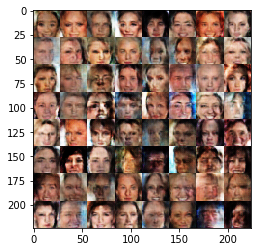

Epoch 1/1... Discriminator Loss: 0.9030... Generator Loss: 1.1544
Epoch 1/1... Discriminator Loss: 0.7802... Generator Loss: 1.3447
Epoch 1/1... Discriminator Loss: 0.8856... Generator Loss: 1.3405
Epoch 1/1... Discriminator Loss: 0.9393... Generator Loss: 1.1008
Epoch 1/1... Discriminator Loss: 0.7377... Generator Loss: 1.5954
Epoch 1/1... Discriminator Loss: 0.8313... Generator Loss: 1.5872
Epoch 1/1... Discriminator Loss: 1.2087... Generator Loss: 0.7213
Epoch 1/1... Discriminator Loss: 0.9534... Generator Loss: 1.7153
Epoch 1/1... Discriminator Loss: 0.8514... Generator Loss: 1.1828
Epoch 1/1... Discriminator Loss: 0.8508... Generator Loss: 2.0202


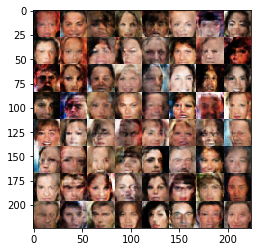

Epoch 1/1... Discriminator Loss: 1.1038... Generator Loss: 0.7174
Epoch 1/1... Discriminator Loss: 0.9821... Generator Loss: 1.9712
Epoch 1/1... Discriminator Loss: 1.0821... Generator Loss: 0.8209
Epoch 1/1... Discriminator Loss: 1.1151... Generator Loss: 1.6800
Epoch 1/1... Discriminator Loss: 1.0567... Generator Loss: 0.7633
Epoch 1/1... Discriminator Loss: 1.2035... Generator Loss: 1.7326
Epoch 1/1... Discriminator Loss: 1.0486... Generator Loss: 0.9757
Epoch 1/1... Discriminator Loss: 0.8288... Generator Loss: 1.8288
Epoch 1/1... Discriminator Loss: 0.8401... Generator Loss: 1.3280
Epoch 1/1... Discriminator Loss: 0.8740... Generator Loss: 1.1124


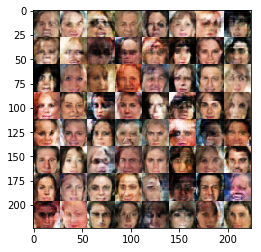

Epoch 1/1... Discriminator Loss: 0.9289... Generator Loss: 1.5453
Epoch 1/1... Discriminator Loss: 1.0514... Generator Loss: 0.8688
Epoch 1/1... Discriminator Loss: 0.9497... Generator Loss: 1.9283
Epoch 1/1... Discriminator Loss: 0.8412... Generator Loss: 1.0775
Epoch 1/1... Discriminator Loss: 0.9601... Generator Loss: 1.0507
Epoch 1/1... Discriminator Loss: 0.9086... Generator Loss: 1.3774
Epoch 1/1... Discriminator Loss: 0.9035... Generator Loss: 1.2675
Epoch 1/1... Discriminator Loss: 0.7840... Generator Loss: 1.3984
Epoch 1/1... Discriminator Loss: 0.7534... Generator Loss: 1.7242
Epoch 1/1... Discriminator Loss: 0.7445... Generator Loss: 1.2932


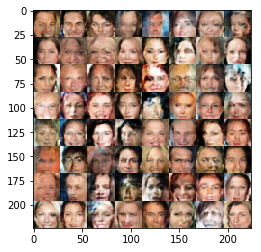

Epoch 1/1... Discriminator Loss: 0.7488... Generator Loss: 1.4359
Epoch 1/1... Discriminator Loss: 0.7883... Generator Loss: 1.3349
Epoch 1/1... Discriminator Loss: 0.7924... Generator Loss: 1.5036
Epoch 1/1... Discriminator Loss: 1.0337... Generator Loss: 0.9423
Epoch 1/1... Discriminator Loss: 0.7898... Generator Loss: 1.7266
Epoch 1/1... Discriminator Loss: 0.6868... Generator Loss: 1.9530
Epoch 1/1... Discriminator Loss: 0.9585... Generator Loss: 1.0050
Epoch 1/1... Discriminator Loss: 0.8809... Generator Loss: 1.8466
Epoch 1/1... Discriminator Loss: 0.8577... Generator Loss: 1.0959
Epoch 1/1... Discriminator Loss: 0.8202... Generator Loss: 1.2619


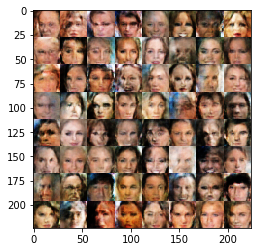

Epoch 1/1... Discriminator Loss: 0.8493... Generator Loss: 1.2602
Epoch 1/1... Discriminator Loss: 0.8378... Generator Loss: 1.1667
Epoch 1/1... Discriminator Loss: 0.8700... Generator Loss: 1.3522
Epoch 1/1... Discriminator Loss: 0.9020... Generator Loss: 1.2781
Epoch 1/1... Discriminator Loss: 0.7748... Generator Loss: 1.4177
Epoch 1/1... Discriminator Loss: 0.8585... Generator Loss: 1.1737
Epoch 1/1... Discriminator Loss: 0.8320... Generator Loss: 1.3572
Epoch 1/1... Discriminator Loss: 0.7772... Generator Loss: 1.2923
Epoch 1/1... Discriminator Loss: 0.9025... Generator Loss: 1.0908
Epoch 1/1... Discriminator Loss: 0.7981... Generator Loss: 1.7216


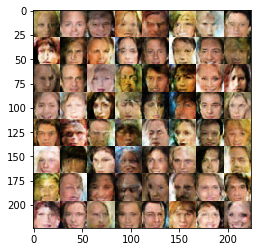

Epoch 1/1... Discriminator Loss: 0.8793... Generator Loss: 1.0031
Epoch 1/1... Discriminator Loss: 0.7365... Generator Loss: 1.4132
Epoch 1/1... Discriminator Loss: 0.8356... Generator Loss: 1.1069
Epoch 1/1... Discriminator Loss: 0.7660... Generator Loss: 1.5857
Epoch 1/1... Discriminator Loss: 0.8232... Generator Loss: 1.0634
Epoch 1/1... Discriminator Loss: 0.7414... Generator Loss: 1.5728
Epoch 1/1... Discriminator Loss: 0.8817... Generator Loss: 1.0743
Epoch 1/1... Discriminator Loss: 0.8073... Generator Loss: 1.2130
Epoch 1/1... Discriminator Loss: 0.8353... Generator Loss: 1.3118
Epoch 1/1... Discriminator Loss: 0.8613... Generator Loss: 1.3129


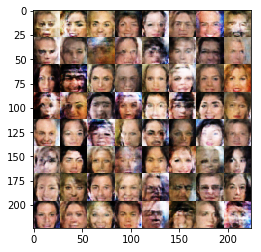

Epoch 1/1... Discriminator Loss: 1.0524... Generator Loss: 0.7731
Epoch 1/1... Discriminator Loss: 1.0326... Generator Loss: 2.2083
Epoch 1/1... Discriminator Loss: 0.8283... Generator Loss: 1.1891
Epoch 1/1... Discriminator Loss: 0.8062... Generator Loss: 1.2534
Epoch 1/1... Discriminator Loss: 0.7773... Generator Loss: 1.7954
Epoch 1/1... Discriminator Loss: 1.0323... Generator Loss: 0.9218
Epoch 1/1... Discriminator Loss: 0.8990... Generator Loss: 1.6118
Epoch 1/1... Discriminator Loss: 0.8927... Generator Loss: 1.1804
Epoch 1/1... Discriminator Loss: 0.8801... Generator Loss: 1.0000
Epoch 1/1... Discriminator Loss: 0.8125... Generator Loss: 1.9731


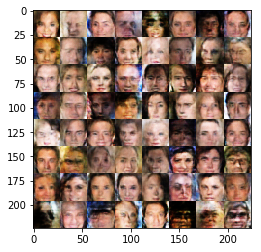

Epoch 1/1... Discriminator Loss: 0.8093... Generator Loss: 1.3550
Epoch 1/1... Discriminator Loss: 1.0123... Generator Loss: 0.8234
Epoch 1/1... Discriminator Loss: 1.0016... Generator Loss: 2.0668
Epoch 1/1... Discriminator Loss: 0.8796... Generator Loss: 1.0132
Epoch 1/1... Discriminator Loss: 0.7714... Generator Loss: 1.4195
Epoch 1/1... Discriminator Loss: 0.8273... Generator Loss: 2.0171
Epoch 1/1... Discriminator Loss: 1.0038... Generator Loss: 0.8518
Epoch 1/1... Discriminator Loss: 0.8267... Generator Loss: 1.4871
Epoch 1/1... Discriminator Loss: 0.7977... Generator Loss: 1.3851
Epoch 1/1... Discriminator Loss: 0.8593... Generator Loss: 1.2046


In [ ]:
batch_size = 64
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5

print_every=1
show_every=10
n_images=72

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.